<a href="https://colab.research.google.com/github/jyoung042525/2025-winter/blob/main/explore_siren.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Siren Exploration

This is a colab to explore properties of the Siren MLP, proposed in our work [Implicit Neural Activations with Periodic Activation Functions](https://vsitzmann.github.io/siren).


We will first implement a streamlined version of Siren for fast experimentation. This lacks the code to easily do baseline comparisons - please refer to the main code for that - but will greatly simplify the code!

**Make sure that you have enabled the GPU under Edit -> Notebook Settings!**

We will then reproduce the following results from the paper:
* [Fitting an image](#section_1)
* [Fitting an audio signal](#section_2)
* [Solving Poisson's equation](#section_3)
* [Initialization scheme & distribution of activations](#activations)
* [Distribution of activations is shift-invariant](#shift_invariance)

We will also explore Siren's [behavior outside of the training range](#out_of_range).

Let's go! First, some imports, and a function to quickly generate coordinate grids.

In [ ]:
import torch
from torch import nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
import os

from PIL import Image
from torchvision.transforms import Resize, Compose, ToTensor, Normalize
import numpy as np
import skimage
import matplotlib.pyplot as plt

import time

def get_mgrid(sidelen, dim=2):
    '''Generates a flattened grid of (x,y,...) coordinates in a range of -1 to 1.
    sidelen: int
    dim: int'''
    tensors = tuple(dim * [torch.linspace(-1, 1, steps=sidelen)])
    mgrid = torch.stack(torch.meshgrid(*tensors), dim=-1)
    mgrid = mgrid.reshape(-1, dim)
    return mgrid

Now, we code up the sine layer, which will be the basic building block of SIREN. This is a much more concise implementation than the one in the main code, as here, we aren't concerned with the baseline comparisons.

In [ ]:
class SineLayer(nn.Module):
    # See paper sec. 3.2, final paragraph, and supplement Sec. 1.5 for discussion of omega_0.

    # If is_first=True, omega_0 is a frequency factor which simply multiplies the activations before the
    # nonlinearity. Different signals may require different omega_0 in the first layer - this is a
    # hyperparameter.

    # If is_first=False, then the weights will be divided by omega_0 so as to keep the magnitude of
    # activations constant, but boost gradients to the weight matrix (see supplement Sec. 1.5)

    def __init__(self, in_features, out_features, bias=True,
                 is_first=False, omega_0=30):
        super().__init__()
        self.omega_0 = omega_0
        self.is_first = is_first

        self.in_features = in_features
        self.linear = nn.Linear(in_features, out_features, bias=bias)

        self.init_weights()

    def init_weights(self):
        with torch.no_grad():
            if self.is_first:
                self.linear.weight.uniform_(-1 / self.in_features,
                                             1 / self.in_features)
            else:
                self.linear.weight.uniform_(-np.sqrt(6 / self.in_features) / self.omega_0,
                                             np.sqrt(6 / self.in_features) / self.omega_0)

    def forward(self, input):
        return torch.sin(self.omega_0 * self.linear(input))

    def forward_with_intermediate(self, input):
        # For visualization of activation distributions
        intermediate = self.omega_0 * self.linear(input)
        return torch.sin(intermediate), intermediate


class Siren(nn.Module):
    def __init__(self, in_features, hidden_features, hidden_layers, out_features, outermost_linear=False,
                 first_omega_0=30, hidden_omega_0=30.):
        super().__init__()

        self.net = []
        self.net.append(SineLayer(in_features, hidden_features,
                                  is_first=True, omega_0=first_omega_0))

        for i in range(hidden_layers):
            self.net.append(SineLayer(hidden_features, hidden_features,
                                      is_first=False, omega_0=hidden_omega_0))

        if outermost_linear:
            final_linear = nn.Linear(hidden_features, out_features)

            with torch.no_grad():
                final_linear.weight.uniform_(-np.sqrt(6 / hidden_features) / hidden_omega_0,
                                              np.sqrt(6 / hidden_features) / hidden_omega_0)

            self.net.append(final_linear)
        else:
            self.net.append(SineLayer(hidden_features, out_features,
                                      is_first=False, omega_0=hidden_omega_0))

        self.net = nn.Sequential(*self.net)

    def forward(self, coords):
        coords = coords.clone().detach().requires_grad_(True) # allows to take derivative w.r.t. input
        output = self.net(coords)
        return output, coords

    def forward_with_activations(self, coords, retain_grad=False):
        '''Returns not only model output, but also intermediate activations.
        Only used for visualizing activations later!'''
        activations = OrderedDict()

        activation_count = 0
        x = coords.clone().detach().requires_grad_(True)
        activations['input'] = x
        for i, layer in enumerate(self.net):
            if isinstance(layer, SineLayer):
                x, intermed = layer.forward_with_intermediate(x)

                if retain_grad:
                    x.retain_grad()
                    intermed.retain_grad()

                activations['_'.join((str(layer.__class__), "%d" % activation_count))] = intermed
                activation_count += 1
            else:
                x = layer(x)

                if retain_grad:
                    x.retain_grad()

            activations['_'.join((str(layer.__class__), "%d" % activation_count))] = x
            activation_count += 1

        return activations

And finally, differential operators that allow us to leverage autograd to compute gradients, the laplacian, etc.

In [ ]:
def laplace(y, x):
    grad = gradient(y, x)
    return divergence(grad, x)


def divergence(y, x):
    div = 0.
    for i in range(y.shape[-1]):
        div += torch.autograd.grad(y[..., i], x, torch.ones_like(y[..., i]), create_graph=True)[0][..., i:i+1]
    return div


def gradient(y, x, grad_outputs=None):
    if grad_outputs is None:
        grad_outputs = torch.ones_like(y)
    grad = torch.autograd.grad(y, [x], grad_outputs=grad_outputs, create_graph=True)[0]
    return grad

# Experiments

For the image fitting and poisson experiments, we'll use the classic cameraman image.

In [ ]:
def get_cameraman_tensor(sidelength):
    img = Image.fromarray(skimage.data.camera())
    transform = Compose([
        Resize(sidelength),
        ToTensor(),
        Normalize(torch.Tensor([0.5]), torch.Tensor([0.5]))
    ])
    img = transform(img)
    return img

In [ ]:
!pip install datasets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 480.6/480.6 kB 13.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 12.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.3/179.3 kB 17.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.5/143.5 kB 16.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.8/194.8 kB 19.7 MB/s eta 0:00:00
  Attempting uninstall: fsspec
    Found existing installation: fsspec 2024.10.0
    Uninstalling fsspec-2024.10.0:
      Successfully uninstalled fsspec-2024.10.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gcsfs 2024.10.0 requires fsspec==2024.10.0, but you have fsspec 2024.9.0 which is incompatible.


In [ ]:
from datasets import load_dataset

ds = load_dataset("jyj7913/spectro-polarimetric")
print(ds)



/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


README.md:   0%|          | 0.00/3.36k [00:00<?, ?B/s]

Resolving data files:   0%|          | 0/2333 [00:00<?, ?it/s]

0013.png:   0%|          | 0.00/3.57k [00:00<?, ?B/s]

0014.png:   0%|          | 0.00/3.12k [00:00<?, ?B/s]

0007.png:   0%|          | 0.00/3.61k [00:00<?, ?B/s]

0006.png:   0%|          | 0.00/1.29k [00:00<?, ?B/s]

0005.png:   0%|          | 0.00/1.23k [00:00<?, ?B/s]

0012.png:   0%|          | 0.00/5.53k [00:00<?, ?B/s]

0001.png:   0%|          | 0.00/1.30k [00:00<?, ?B/s]

0004.png:   0%|          | 0.00/8.57k [00:00<?, ?B/s]

0009.png:   0%|          | 0.00/4.33k [00:00<?, ?B/s]

0015.png:   0%|          | 0.00/3.73k [00:00<?, ?B/s]

0003.png:   0%|          | 0.00/2.81k [00:00<?, ?B/s]

0000.png:   0%|          | 0.00/3.51k [00:00<?, ?B/s]

0002.png:   0%|          | 0.00/5.09k [00:00<?, ?B/s]

0016.png:   0%|          | 0.00/2.91k [00:00<?, ?B/s]

0019.png:   0%|          | 0.00/6.07k [00:00<?, ?B/s]

0017.png:   0%|          | 0.00/4.57k [00:00<?, ?B/s]

0024.png:   0%|          | 0.00/6.43k [00:00<?, ?B/s]

0027.png:   0%|          | 0.00/4.04k [00:00<?, ?B/s]

0025.png:   0%|          | 0.00/2.75k [00:00<?, ?B/s]

0020.png:   0%|          | 0.00/5.79k [00:00<?, ?B/s]

0018.png:   0%|          | 0.00/7.73k [00:00<?, ?B/s]

0026.png:   0%|          | 0.00/4.43k [00:00<?, ?B/s]

0028.png:   0%|          | 0.00/9.22k [00:00<?, ?B/s]

0022.png:   0%|          | 0.00/4.56k [00:00<?, ?B/s]

0021.png:   0%|          | 0.00/4.97k [00:00<?, ?B/s]

0029.png:   0%|          | 0.00/2.59k [00:00<?, ?B/s]

0030.png:   0%|          | 0.00/1.76k [00:00<?, ?B/s]

0031.png:   0%|          | 0.00/6.78k [00:00<?, ?B/s]

0035.png:   0%|          | 0.00/2.00k [00:00<?, ?B/s]

0034.png:   0%|          | 0.00/6.49k [00:00<?, ?B/s]

0038.png:   0%|          | 0.00/1.77k [00:00<?, ?B/s]

0036.png:   0%|          | 0.00/4.71k [00:00<?, ?B/s]

0039.png:   0%|          | 0.00/7.62k [00:00<?, ?B/s]

0032.png:   0%|          | 0.00/6.66k [00:00<?, ?B/s]

0037.png:   0%|          | 0.00/3.81k [00:00<?, ?B/s]

0033.png:   0%|          | 0.00/1.86k [00:00<?, ?B/s]

0040.png:   0%|          | 0.00/8.22k [00:00<?, ?B/s]

0041.png:   0%|          | 0.00/1.24k [00:00<?, ?B/s]

0044.png:   0%|          | 0.00/3.19k [00:00<?, ?B/s]

0046.png:   0%|          | 0.00/6.24k [00:00<?, ?B/s]

0043.png:   0%|          | 0.00/6.42k [00:00<?, ?B/s]

0045.png:   0%|          | 0.00/10.3k [00:00<?, ?B/s]

0047.png:   0%|          | 0.00/7.71k [00:00<?, ?B/s]

0053.png:   0%|          | 0.00/3.93k [00:00<?, ?B/s]

0058.png:   0%|          | 0.00/8.06k [00:00<?, ?B/s]

0051.png:   0%|          | 0.00/9.79k [00:00<?, ?B/s]

0055.png:   0%|          | 0.00/2.24k [00:00<?, ?B/s]

0049.png:   0%|          | 0.00/11.3k [00:00<?, ?B/s]

0059.png:   0%|          | 0.00/2.64k [00:00<?, ?B/s]

0056.png:   0%|          | 0.00/1.82k [00:00<?, ?B/s]

0054.png:   0%|          | 0.00/7.83k [00:00<?, ?B/s]

0057.png:   0%|          | 0.00/3.19k [00:00<?, ?B/s]

0048.png:   0%|          | 0.00/10.3k [00:00<?, ?B/s]

0050.png:   0%|          | 0.00/4.95k [00:00<?, ?B/s]

0063.png:   0%|          | 0.00/14.7k [00:00<?, ?B/s]

0064.png:   0%|          | 0.00/3.09k [00:00<?, ?B/s]

0062.png:   0%|          | 0.00/3.44k [00:00<?, ?B/s]

0060.png:   0%|          | 0.00/8.32k [00:00<?, ?B/s]

0061.png:   0%|          | 0.00/3.51k [00:00<?, ?B/s]

0073.png:   0%|          | 0.00/4.66k [00:00<?, ?B/s]

0075.png:   0%|          | 0.00/8.37k [00:00<?, ?B/s]

0068.png:   0%|          | 0.00/2.36k [00:00<?, ?B/s]

0069.png:   0%|          | 0.00/9.18k [00:00<?, ?B/s]

0066.png:   0%|          | 0.00/4.77k [00:00<?, ?B/s]

0067.png:   0%|          | 0.00/5.16k [00:00<?, ?B/s]

0072.png:   0%|          | 0.00/3.25k [00:00<?, ?B/s]

0065.png:   0%|          | 0.00/3.63k [00:00<?, ?B/s]

0070.png:   0%|          | 0.00/4.50k [00:00<?, ?B/s]

0074.png:   0%|          | 0.00/4.80k [00:00<?, ?B/s]

0071.png:   0%|          | 0.00/1.62k [00:00<?, ?B/s]

0080.png:   0%|          | 0.00/6.42k [00:00<?, ?B/s]

0079.png:   0%|          | 0.00/9.08k [00:00<?, ?B/s]

0078.png:   0%|          | 0.00/5.46k [00:00<?, ?B/s]

0076.png:   0%|          | 0.00/5.72k [00:00<?, ?B/s]

0077.png:   0%|          | 0.00/2.16k [00:00<?, ?B/s]

0089.png:   0%|          | 0.00/5.19k [00:00<?, ?B/s]

0083.png:   0%|          | 0.00/3.00k [00:00<?, ?B/s]

0082.png:   0%|          | 0.00/10.1k [00:00<?, ?B/s]

0090.png:   0%|          | 0.00/6.39k [00:00<?, ?B/s]

0084.png:   0%|          | 0.00/4.16k [00:00<?, ?B/s]

0081.png:   0%|          | 0.00/3.52k [00:00<?, ?B/s]

0093.png:   0%|          | 0.00/3.73k [00:00<?, ?B/s]

0092.png:   0%|          | 0.00/3.36k [00:00<?, ?B/s]

0088.png:   0%|          | 0.00/3.40k [00:00<?, ?B/s]

0085.png:   0%|          | 0.00/3.24k [00:00<?, ?B/s]

0091.png:   0%|          | 0.00/1.81k [00:00<?, ?B/s]

0096.png:   0%|          | 0.00/4.00k [00:00<?, ?B/s]

0094.png:   0%|          | 0.00/4.76k [00:00<?, ?B/s]

0098.png:   0%|          | 0.00/4.62k [00:00<?, ?B/s]

0097.png:   0%|          | 0.00/3.57k [00:00<?, ?B/s]

0095.png:   0%|          | 0.00/3.12k [00:00<?, ?B/s]

0100.png:   0%|          | 0.00/5.63k [00:00<?, ?B/s]

0101.png:   0%|          | 0.00/1.96k [00:00<?, ?B/s]

0103.png:   0%|          | 0.00/1.88k [00:00<?, ?B/s]

0102.png:   0%|          | 0.00/3.42k [00:00<?, ?B/s]

0099.png:   0%|          | 0.00/8.27k [00:00<?, ?B/s]

0104.png:   0%|          | 0.00/4.82k [00:00<?, ?B/s]

0106.png:   0%|          | 0.00/4.82k [00:00<?, ?B/s]

0105.png:   0%|          | 0.00/4.86k [00:00<?, ?B/s]

0109.png:   0%|          | 0.00/2.73k [00:00<?, ?B/s]

0107.png:   0%|          | 0.00/6.19k [00:00<?, ?B/s]

0114.png:   0%|          | 0.00/2.37k [00:00<?, ?B/s]

0112.png:   0%|          | 0.00/4.54k [00:00<?, ?B/s]

0111.png:   0%|          | 0.00/2.38k [00:00<?, ?B/s]

0115.png:   0%|          | 0.00/3.88k [00:00<?, ?B/s]

0113.png:   0%|          | 0.00/7.50k [00:00<?, ?B/s]

0123.png:   0%|          | 0.00/1.33k [00:00<?, ?B/s]

0119.png:   0%|          | 0.00/1.25k [00:00<?, ?B/s]

0121.png:   0%|          | 0.00/8.94k [00:00<?, ?B/s]

0117.png:   0%|          | 0.00/1.24k [00:00<?, ?B/s]

0124.png:   0%|          | 0.00/1.24k [00:00<?, ?B/s]

0122.png:   0%|          | 0.00/2.33k [00:00<?, ?B/s]

0125.png:   0%|          | 0.00/8.16k [00:00<?, ?B/s]

0116.png:   0%|          | 0.00/1.26k [00:00<?, ?B/s]

0120.png:   0%|          | 0.00/3.84k [00:00<?, ?B/s]

0126.png:   0%|          | 0.00/4.45k [00:00<?, ?B/s]

0128.png:   0%|          | 0.00/1.80k [00:00<?, ?B/s]

0129.png:   0%|          | 0.00/3.01k [00:00<?, ?B/s]

0135.png:   0%|          | 0.00/1.29k [00:00<?, ?B/s]

0133.png:   0%|          | 0.00/1.35k [00:00<?, ?B/s]

0146.png:   0%|          | 0.00/1.45k [00:00<?, ?B/s]

0137.png:   0%|          | 0.00/2.99k [00:00<?, ?B/s]

0134.png:   0%|          | 0.00/3.39k [00:00<?, ?B/s]

0136.png:   0%|          | 0.00/5.00k [00:00<?, ?B/s]

0142.png:   0%|          | 0.00/2.44k [00:00<?, ?B/s]

0139.png:   0%|          | 0.00/3.45k [00:00<?, ?B/s]

0148.png:   0%|          | 0.00/1.25k [00:00<?, ?B/s]

0147.png:   0%|          | 0.00/1.71k [00:00<?, ?B/s]

0141.png:   0%|          | 0.00/2.00k [00:00<?, ?B/s]

0145.png:   0%|          | 0.00/4.96k [00:00<?, ?B/s]

0140.png:   0%|          | 0.00/3.77k [00:00<?, ?B/s]

0144.png:   0%|          | 0.00/1.41k [00:00<?, ?B/s]

0143.png:   0%|          | 0.00/3.54k [00:00<?, ?B/s]

0138.png:   0%|          | 0.00/1.24k [00:00<?, ?B/s]

0149.png:   0%|          | 0.00/3.21k [00:00<?, ?B/s]

0150.png:   0%|          | 0.00/3.63k [00:00<?, ?B/s]

0152.png:   0%|          | 0.00/1.48k [00:00<?, ?B/s]

0153.png:   0%|          | 0.00/1.49k [00:00<?, ?B/s]

0151.png:   0%|          | 0.00/2.90k [00:00<?, ?B/s]

0156.png:   0%|          | 0.00/1.42k [00:00<?, ?B/s]

0158.png:   0%|          | 0.00/1.70k [00:00<?, ?B/s]

0162.png:   0%|          | 0.00/1.70k [00:00<?, ?B/s]

0157.png:   0%|          | 0.00/1.64k [00:00<?, ?B/s]

0164.png:   0%|          | 0.00/1.68k [00:00<?, ?B/s]

0161.png:   0%|          | 0.00/1.70k [00:00<?, ?B/s]

0160.png:   0%|          | 0.00/1.68k [00:00<?, ?B/s]

0155.png:   0%|          | 0.00/1.42k [00:00<?, ?B/s]

0159.png:   0%|          | 0.00/1.65k [00:00<?, ?B/s]

0154.png:   0%|          | 0.00/1.42k [00:00<?, ?B/s]

0163.png:   0%|          | 0.00/1.65k [00:00<?, ?B/s]

0167.png:   0%|          | 0.00/1.49k [00:00<?, ?B/s]

0166.png:   0%|          | 0.00/1.49k [00:00<?, ?B/s]

0165.png:   0%|          | 0.00/1.94k [00:00<?, ?B/s]

0169.png:   0%|          | 0.00/1.64k [00:00<?, ?B/s]

0168.png:   0%|          | 0.00/1.42k [00:00<?, ?B/s]

0170.png:   0%|          | 0.00/1.42k [00:00<?, ?B/s]

0179.png:   0%|          | 0.00/3.69k [00:00<?, ?B/s]

0171.png:   0%|          | 0.00/1.90k [00:00<?, ?B/s]

0173.png:   0%|          | 0.00/1.43k [00:00<?, ?B/s]

0177.png:   0%|          | 0.00/5.67k [00:00<?, ?B/s]

0172.png:   0%|          | 0.00/1.84k [00:00<?, ?B/s]

0174.png:   0%|          | 0.00/1.43k [00:00<?, ?B/s]

0180.png:   0%|          | 0.00/3.94k [00:00<?, ?B/s]

0178.png:   0%|          | 0.00/7.06k [00:00<?, ?B/s]

0183.png:   0%|          | 0.00/4.49k [00:00<?, ?B/s]

0175.png:   0%|          | 0.00/1.85k [00:00<?, ?B/s]

0181.png:   0%|          | 0.00/5.39k [00:00<?, ?B/s]

0176.png:   0%|          | 0.00/1.60k [00:00<?, ?B/s]

0182.png:   0%|          | 0.00/2.53k [00:00<?, ?B/s]

0185.png:   0%|          | 0.00/1.62k [00:00<?, ?B/s]

0184.png:   0%|          | 0.00/4.19k [00:00<?, ?B/s]

0186.png:   0%|          | 0.00/1.48k [00:00<?, ?B/s]

0187.png:   0%|          | 0.00/5.51k [00:00<?, ?B/s]

0191.png:   0%|          | 0.00/3.40k [00:00<?, ?B/s]

0189.png:   0%|          | 0.00/1.76k [00:00<?, ?B/s]

0188.png:   0%|          | 0.00/2.94k [00:00<?, ?B/s]

0194.png:   0%|          | 0.00/1.31k [00:00<?, ?B/s]

0190.png:   0%|          | 0.00/5.18k [00:00<?, ?B/s]

0196.png:   0%|          | 0.00/7.30k [00:00<?, ?B/s]

0197.png:   0%|          | 0.00/3.30k [00:00<?, ?B/s]

0198.png:   0%|          | 0.00/6.67k [00:00<?, ?B/s]

0199.png:   0%|          | 0.00/9.72k [00:00<?, ?B/s]

0195.png:   0%|          | 0.00/4.72k [00:00<?, ?B/s]

0192.png:   0%|          | 0.00/3.43k [00:00<?, ?B/s]

0201.png:   0%|          | 0.00/15.3k [00:00<?, ?B/s]

0200.png:   0%|          | 0.00/9.50k [00:00<?, ?B/s]

0202.png:   0%|          | 0.00/6.08k [00:00<?, ?B/s]

0206.png:   0%|          | 0.00/18.2k [00:00<?, ?B/s]

0203.png:   0%|          | 0.00/4.42k [00:00<?, ?B/s]

0205.png:   0%|          | 0.00/8.97k [00:00<?, ?B/s]

0204.png:   0%|          | 0.00/5.52k [00:00<?, ?B/s]

0207.png:   0%|          | 0.00/5.83k [00:00<?, ?B/s]

0209.png:   0%|          | 0.00/6.10k [00:00<?, ?B/s]

0208.png:   0%|          | 0.00/6.42k [00:00<?, ?B/s]

0210.png:   0%|          | 0.00/10.5k [00:00<?, ?B/s]

0213.png:   0%|          | 0.00/14.8k [00:00<?, ?B/s]

0211.png:   0%|          | 0.00/1.49k [00:00<?, ?B/s]

0214.png:   0%|          | 0.00/3.02k [00:00<?, ?B/s]

0215.png:   0%|          | 0.00/9.48k [00:00<?, ?B/s]

0216.png:   0%|          | 0.00/4.83k [00:00<?, ?B/s]

0218.png:   0%|          | 0.00/9.58k [00:00<?, ?B/s]

0221.png:   0%|          | 0.00/4.80k [00:00<?, ?B/s]

0219.png:   0%|          | 0.00/13.4k [00:00<?, ?B/s]

0220.png:   0%|          | 0.00/5.33k [00:00<?, ?B/s]

0217.png:   0%|          | 0.00/3.78k [00:00<?, ?B/s]

0222.png:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

0224.png:   0%|          | 0.00/12.3k [00:00<?, ?B/s]

0225.png:   0%|          | 0.00/1.27k [00:00<?, ?B/s]

0232.png:   0%|          | 0.00/6.24k [00:00<?, ?B/s]

0233.png:   0%|          | 0.00/4.68k [00:00<?, ?B/s]

0223.png:   0%|          | 0.00/8.85k [00:00<?, ?B/s]

0235.png:   0%|          | 0.00/6.17k [00:00<?, ?B/s]

0234.png:   0%|          | 0.00/4.01k [00:00<?, ?B/s]

0236.png:   0%|          | 0.00/6.14k [00:00<?, ?B/s]

0237.png:   0%|          | 0.00/1.43k [00:00<?, ?B/s]

0239.png:   0%|          | 0.00/1.58k [00:00<?, ?B/s]

0240.png:   0%|          | 0.00/4.61k [00:00<?, ?B/s]

0244.png:   0%|          | 0.00/8.92k [00:00<?, ?B/s]

0243.png:   0%|          | 0.00/9.61k [00:00<?, ?B/s]

0241.png:   0%|          | 0.00/9.58k [00:00<?, ?B/s]

0245.png:   0%|          | 0.00/9.64k [00:00<?, ?B/s]

0242.png:   0%|          | 0.00/2.05k [00:00<?, ?B/s]

0246.png:   0%|          | 0.00/3.77k [00:00<?, ?B/s]

0247.png:   0%|          | 0.00/5.68k [00:00<?, ?B/s]

0248.png:   0%|          | 0.00/4.67k [00:00<?, ?B/s]

0250.png:   0%|          | 0.00/2.11k [00:00<?, ?B/s]

0251.png:   0%|          | 0.00/1.31k [00:00<?, ?B/s]

0254.png:   0%|          | 0.00/1.29k [00:00<?, ?B/s]

0252.png:   0%|          | 0.00/1.46k [00:00<?, ?B/s]

0255.png:   0%|          | 0.00/1.36k [00:00<?, ?B/s]

0259.png:   0%|          | 0.00/1.43k [00:00<?, ?B/s]

0258.png:   0%|          | 0.00/1.56k [00:00<?, ?B/s]

0264.png:   0%|          | 0.00/1.86k [00:00<?, ?B/s]

0265.png:   0%|          | 0.00/1.80k [00:00<?, ?B/s]

0269.png:   0%|          | 0.00/2.79k [00:00<?, ?B/s]

0266.png:   0%|          | 0.00/1.65k [00:00<?, ?B/s]

0270.png:   0%|          | 0.00/2.05k [00:00<?, ?B/s]

0267.png:   0%|          | 0.00/2.07k [00:00<?, ?B/s]

0271.png:   0%|          | 0.00/1.55k [00:00<?, ?B/s]

0277.png:   0%|          | 0.00/1.33k [00:00<?, ?B/s]

0276.png:   0%|          | 0.00/1.74k [00:00<?, ?B/s]

0280.png:   0%|          | 0.00/5.34k [00:00<?, ?B/s]

0278.png:   0%|          | 0.00/4.38k [00:00<?, ?B/s]

0279.png:   0%|          | 0.00/3.41k [00:00<?, ?B/s]

0285.png:   0%|          | 0.00/6.78k [00:00<?, ?B/s]

0284.png:   0%|          | 0.00/4.12k [00:00<?, ?B/s]

0281.png:   0%|          | 0.00/2.66k [00:00<?, ?B/s]

0282.png:   0%|          | 0.00/6.72k [00:00<?, ?B/s]

0287.png:   0%|          | 0.00/2.06k [00:00<?, ?B/s]

0291.png:   0%|          | 0.00/3.86k [00:00<?, ?B/s]

0294.png:   0%|          | 0.00/17.2k [00:00<?, ?B/s]

0292.png:   0%|          | 0.00/3.46k [00:00<?, ?B/s]

0293.png:   0%|          | 0.00/5.37k [00:00<?, ?B/s]

0289.png:   0%|          | 0.00/5.95k [00:00<?, ?B/s]

0288.png:   0%|          | 0.00/5.88k [00:00<?, ?B/s]

0295.png:   0%|          | 0.00/4.14k [00:00<?, ?B/s]

0290.png:   0%|          | 0.00/3.23k [00:00<?, ?B/s]

0298.png:   0%|          | 0.00/7.53k [00:00<?, ?B/s]

0296.png:   0%|          | 0.00/1.50k [00:00<?, ?B/s]

0297.png:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

0299.png:   0%|          | 0.00/6.44k [00:00<?, ?B/s]

0301.png:   0%|          | 0.00/8.79k [00:00<?, ?B/s]

0300.png:   0%|          | 0.00/2.27k [00:00<?, ?B/s]

0302.png:   0%|          | 0.00/4.87k [00:00<?, ?B/s]

0304.png:   0%|          | 0.00/3.92k [00:00<?, ?B/s]

0303.png:   0%|          | 0.00/1.71k [00:00<?, ?B/s]

0000.png:   0%|          | 0.00/8.31k [00:00<?, ?B/s]

0307.png:   0%|          | 0.00/6.25k [00:00<?, ?B/s]

0305.png:   0%|          | 0.00/4.79k [00:00<?, ?B/s]

0308.png:   0%|          | 0.00/7.54k [00:00<?, ?B/s]

0310.png:   0%|          | 0.00/9.13k [00:00<?, ?B/s]

0306.png:   0%|          | 0.00/9.12k [00:00<?, ?B/s]

0309.png:   0%|          | 0.00/4.90k [00:00<?, ?B/s]

0001.png:   0%|          | 0.00/3.18k [00:00<?, ?B/s]

0007.png:   0%|          | 0.00/3.66k [00:00<?, ?B/s]

0006.png:   0%|          | 0.00/6.33k [00:00<?, ?B/s]

0002.png:   0%|          | 0.00/3.84k [00:00<?, ?B/s]

0005.png:   0%|          | 0.00/7.60k [00:00<?, ?B/s]

0009.png:   0%|          | 0.00/3.28k [00:00<?, ?B/s]

0011.png:   0%|          | 0.00/4.47k [00:00<?, ?B/s]

0012.png:   0%|          | 0.00/6.86k [00:00<?, ?B/s]

0014.png:   0%|          | 0.00/6.69k [00:00<?, ?B/s]

0013.png:   0%|          | 0.00/23.8k [00:00<?, ?B/s]

0023.png:   0%|          | 0.00/36.3k [00:00<?, ?B/s]

0020.png:   0%|          | 0.00/3.29k [00:00<?, ?B/s]

0019.png:   0%|          | 0.00/89.6k [00:00<?, ?B/s]

0025.png:   0%|          | 0.00/3.41k [00:00<?, ?B/s]

0026.png:   0%|          | 0.00/75.3k [00:00<?, ?B/s]

0021.png:   0%|          | 0.00/3.20k [00:00<?, ?B/s]

0027.png:   0%|          | 0.00/53.7k [00:00<?, ?B/s]

0022.png:   0%|          | 0.00/8.62k [00:00<?, ?B/s]

0024.png:   0%|          | 0.00/4.54k [00:00<?, ?B/s]

0031.png:   0%|          | 0.00/49.1k [00:00<?, ?B/s]

0035.png:   0%|          | 0.00/111k [00:00<?, ?B/s]

0036.png:   0%|          | 0.00/3.24k [00:00<?, ?B/s]

0032.png:   0%|          | 0.00/3.24k [00:00<?, ?B/s]

0034.png:   0%|          | 0.00/99.6k [00:00<?, ?B/s]

0030.png:   0%|          | 0.00/8.91k [00:00<?, ?B/s]

0029.png:   0%|          | 0.00/3.48k [00:00<?, ?B/s]

0049.png:   0%|          | 0.00/4.61k [00:00<?, ?B/s]

0037.png:   0%|          | 0.00/3.65k [00:00<?, ?B/s]

0045.png:   0%|          | 0.00/25.4k [00:00<?, ?B/s]

0041.png:   0%|          | 0.00/3.19k [00:00<?, ?B/s]

0044.png:   0%|          | 0.00/6.61k [00:00<?, ?B/s]

0046.png:   0%|          | 0.00/23.9k [00:00<?, ?B/s]

0047.png:   0%|          | 0.00/3.86k [00:00<?, ?B/s]

0042.png:   0%|          | 0.00/3.39k [00:00<?, ?B/s]

0043.png:   0%|          | 0.00/4.26k [00:00<?, ?B/s]

0050.png:   0%|          | 0.00/128k [00:00<?, ?B/s]

0052.png:   0%|          | 0.00/36.1k [00:00<?, ?B/s]

0056.png:   0%|          | 0.00/92.3k [00:00<?, ?B/s]

0053.png:   0%|          | 0.00/3.19k [00:00<?, ?B/s]

0054.png:   0%|          | 0.00/27.0k [00:00<?, ?B/s]

0055.png:   0%|          | 0.00/48.8k [00:00<?, ?B/s]

0057.png:   0%|          | 0.00/8.84k [00:00<?, ?B/s]

0060.png:   0%|          | 0.00/74.2k [00:00<?, ?B/s]

0064.png:   0%|          | 0.00/14.3k [00:00<?, ?B/s]

0073.png:   0%|          | 0.00/136k [00:00<?, ?B/s]

0066.png:   0%|          | 0.00/3.36k [00:00<?, ?B/s]

0061.png:   0%|          | 0.00/5.83k [00:00<?, ?B/s]

0063.png:   0%|          | 0.00/89.7k [00:00<?, ?B/s]

0067.png:   0%|          | 0.00/17.2k [00:00<?, ?B/s]

0068.png:   0%|          | 0.00/8.12k [00:00<?, ?B/s]

0058.png:   0%|          | 0.00/77.7k [00:00<?, ?B/s]

0065.png:   0%|          | 0.00/65.1k [00:00<?, ?B/s]

0069.png:   0%|          | 0.00/11.7k [00:00<?, ?B/s]

0074.png:   0%|          | 0.00/11.1k [00:00<?, ?B/s]

0072.png:   0%|          | 0.00/80.0k [00:00<?, ?B/s]

0071.png:   0%|          | 0.00/13.7k [00:00<?, ?B/s]

0070.png:   0%|          | 0.00/4.42k [00:00<?, ?B/s]

0059.png:   0%|          | 0.00/71.8k [00:00<?, ?B/s]

0085.png:   0%|          | 0.00/27.4k [00:00<?, ?B/s]

0084.png:   0%|          | 0.00/84.7k [00:00<?, ?B/s]

0080.png:   0%|          | 0.00/5.12k [00:00<?, ?B/s]

0079.png:   0%|          | 0.00/13.6k [00:00<?, ?B/s]

0077.png:   0%|          | 0.00/6.55k [00:00<?, ?B/s]

0091.png:   0%|          | 0.00/15.0k [00:00<?, ?B/s]

0089.png:   0%|          | 0.00/11.1k [00:00<?, ?B/s]

0078.png:   0%|          | 0.00/88.4k [00:00<?, ?B/s]

0087.png:   0%|          | 0.00/25.5k [00:00<?, ?B/s]

0083.png:   0%|          | 0.00/54.1k [00:00<?, ?B/s]

0076.png:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

0086.png:   0%|          | 0.00/10.4k [00:00<?, ?B/s]

0081.png:   0%|          | 0.00/17.3k [00:00<?, ?B/s]

0075.png:   0%|          | 0.00/8.65k [00:00<?, ?B/s]

0088.png:   0%|          | 0.00/38.9k [00:00<?, ?B/s]

0090.png:   0%|          | 0.00/19.6k [00:00<?, ?B/s]

0094.png:   0%|          | 0.00/13.7k [00:00<?, ?B/s]

0101.png:   0%|          | 0.00/13.7k [00:00<?, ?B/s]

0096.png:   0%|          | 0.00/45.3k [00:00<?, ?B/s]

0107.png:   0%|          | 0.00/7.28k [00:00<?, ?B/s]

0098.png:   0%|          | 0.00/3.61k [00:00<?, ?B/s]

0099.png:   0%|          | 0.00/7.72k [00:00<?, ?B/s]

0097.png:   0%|          | 0.00/127k [00:00<?, ?B/s]

0103.png:   0%|          | 0.00/4.17k [00:00<?, ?B/s]

0095.png:   0%|          | 0.00/44.0k [00:00<?, ?B/s]

0102.png:   0%|          | 0.00/147k [00:00<?, ?B/s]

0106.png:   0%|          | 0.00/14.6k [00:00<?, ?B/s]

0100.png:   0%|          | 0.00/15.4k [00:00<?, ?B/s]

0092.png:   0%|          | 0.00/4.96k [00:00<?, ?B/s]

0093.png:   0%|          | 0.00/44.8k [00:00<?, ?B/s]

0105.png:   0%|          | 0.00/145k [00:00<?, ?B/s]

0108.png:   0%|          | 0.00/3.41k [00:00<?, ?B/s]

0119.png:   0%|          | 0.00/42.7k [00:00<?, ?B/s]

0120.png:   0%|          | 0.00/5.90k [00:00<?, ?B/s]

0111.png:   0%|          | 0.00/18.3k [00:00<?, ?B/s]

0116.png:   0%|          | 0.00/71.9k [00:00<?, ?B/s]

0118.png:   0%|          | 0.00/89.1k [00:00<?, ?B/s]

0113.png:   0%|          | 0.00/58.0k [00:00<?, ?B/s]

0123.png:   0%|          | 0.00/21.0k [00:00<?, ?B/s]

0117.png:   0%|          | 0.00/85.8k [00:00<?, ?B/s]

0112.png:   0%|          | 0.00/109k [00:00<?, ?B/s]

0121.png:   0%|          | 0.00/74.2k [00:00<?, ?B/s]

0115.png:   0%|          | 0.00/29.4k [00:00<?, ?B/s]

0126.png:   0%|          | 0.00/37.8k [00:00<?, ?B/s]

0122.png:   0%|          | 0.00/4.67k [00:00<?, ?B/s]

0109.png:   0%|          | 0.00/17.7k [00:00<?, ?B/s]

0127.png:   0%|          | 0.00/111k [00:00<?, ?B/s]

0125.png:   0%|          | 0.00/44.2k [00:00<?, ?B/s]

0133.png:   0%|          | 0.00/4.39k [00:00<?, ?B/s]

0129.png:   0%|          | 0.00/9.50k [00:00<?, ?B/s]

0132.png:   0%|          | 0.00/26.5k [00:00<?, ?B/s]

0130.png:   0%|          | 0.00/5.39k [00:00<?, ?B/s]

0137.png:   0%|          | 0.00/3.37k [00:00<?, ?B/s]

0135.png:   0%|          | 0.00/22.0k [00:00<?, ?B/s]

0143.png:   0%|          | 0.00/14.8k [00:00<?, ?B/s]

0139.png:   0%|          | 0.00/37.8k [00:00<?, ?B/s]

0140.png:   0%|          | 0.00/3.24k [00:00<?, ?B/s]

0134.png:   0%|          | 0.00/79.6k [00:00<?, ?B/s]

0144.png:   0%|          | 0.00/5.67k [00:00<?, ?B/s]

0141.png:   0%|          | 0.00/202k [00:00<?, ?B/s]

0136.png:   0%|          | 0.00/220k [00:00<?, ?B/s]

0142.png:   0%|          | 0.00/17.6k [00:00<?, ?B/s]

0131.png:   0%|          | 0.00/10.8k [00:00<?, ?B/s]

0128.png:   0%|          | 0.00/3.21k [00:00<?, ?B/s]

0147.png:   0%|          | 0.00/4.64k [00:00<?, ?B/s]

0148.png:   0%|          | 0.00/86.5k [00:00<?, ?B/s]

0145.png:   0%|          | 0.00/79.7k [00:00<?, ?B/s]

0151.png:   0%|          | 0.00/7.36k [00:00<?, ?B/s]

0150.png:   0%|          | 0.00/48.0k [00:00<?, ?B/s]

0156.png:   0%|          | 0.00/5.59k [00:00<?, ?B/s]

0152.png:   0%|          | 0.00/40.4k [00:00<?, ?B/s]

0155.png:   0%|          | 0.00/4.38k [00:00<?, ?B/s]

0146.png:   0%|          | 0.00/3.28k [00:00<?, ?B/s]

0149.png:   0%|          | 0.00/5.28k [00:00<?, ?B/s]

0153.png:   0%|          | 0.00/98.9k [00:00<?, ?B/s]

0158.png:   0%|          | 0.00/30.9k [00:00<?, ?B/s]

0154.png:   0%|          | 0.00/14.4k [00:00<?, ?B/s]

0160.png:   0%|          | 0.00/69.9k [00:00<?, ?B/s]

0159.png:   0%|          | 0.00/3.51k [00:00<?, ?B/s]

0161.png:   0%|          | 0.00/21.9k [00:00<?, ?B/s]

0174.png:   0%|          | 0.00/4.01k [00:00<?, ?B/s]

0175.png:   0%|          | 0.00/136k [00:00<?, ?B/s]

0180.png:   0%|          | 0.00/70.5k [00:00<?, ?B/s]

0178.png:   0%|          | 0.00/4.63k [00:00<?, ?B/s]

0165.png:   0%|          | 0.00/3.25k [00:00<?, ?B/s]

0167.png:   0%|          | 0.00/8.25k [00:00<?, ?B/s]

0172.png:   0%|          | 0.00/8.63k [00:00<?, ?B/s]

0169.png:   0%|          | 0.00/6.16k [00:00<?, ?B/s]

0163.png:   0%|          | 0.00/3.44k [00:00<?, ?B/s]

0168.png:   0%|          | 0.00/7.57k [00:00<?, ?B/s]

0164.png:   0%|          | 0.00/12.1k [00:00<?, ?B/s]

0176.png:   0%|          | 0.00/262k [00:00<?, ?B/s]

0179.png:   0%|          | 0.00/3.29k [00:00<?, ?B/s]

0181.png:   0%|          | 0.00/8.93k [00:00<?, ?B/s]

0177.png:   0%|          | 0.00/17.2k [00:00<?, ?B/s]

0182.png:   0%|          | 0.00/3.63k [00:00<?, ?B/s]

0184.png:   0%|          | 0.00/102k [00:00<?, ?B/s]

0194.png:   0%|          | 0.00/3.46k [00:00<?, ?B/s]

0189.png:   0%|          | 0.00/19.0k [00:00<?, ?B/s]

0193.png:   0%|          | 0.00/17.1k [00:00<?, ?B/s]

0183.png:   0%|          | 0.00/9.29k [00:00<?, ?B/s]

0187.png:   0%|          | 0.00/49.4k [00:00<?, ?B/s]

0190.png:   0%|          | 0.00/73.6k [00:00<?, ?B/s]

0186.png:   0%|          | 0.00/30.0k [00:00<?, ?B/s]

0188.png:   0%|          | 0.00/3.27k [00:00<?, ?B/s]

0195.png:   0%|          | 0.00/58.9k [00:00<?, ?B/s]

0197.png:   0%|          | 0.00/132k [00:00<?, ?B/s]

0191.png:   0%|          | 0.00/38.5k [00:00<?, ?B/s]

0185.png:   0%|          | 0.00/77.9k [00:00<?, ?B/s]

0196.png:   0%|          | 0.00/90.4k [00:00<?, ?B/s]

0199.png:   0%|          | 0.00/3.19k [00:00<?, ?B/s]

0198.png:   0%|          | 0.00/3.88k [00:00<?, ?B/s]

0206.png:   0%|          | 0.00/86.2k [00:00<?, ?B/s]

0202.png:   0%|          | 0.00/126k [00:00<?, ?B/s]

0212.png:   0%|          | 0.00/15.6k [00:00<?, ?B/s]

0201.png:   0%|          | 0.00/95.4k [00:00<?, ?B/s]

0207.png:   0%|          | 0.00/23.7k [00:00<?, ?B/s]

0205.png:   0%|          | 0.00/48.5k [00:00<?, ?B/s]

0209.png:   0%|          | 0.00/4.96k [00:00<?, ?B/s]

0203.png:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

0204.png:   0%|          | 0.00/5.20k [00:00<?, ?B/s]

0215.png:   0%|          | 0.00/3.44k [00:00<?, ?B/s]

0211.png:   0%|          | 0.00/3.19k [00:00<?, ?B/s]

0210.png:   0%|          | 0.00/18.1k [00:00<?, ?B/s]

0214.png:   0%|          | 0.00/10.2k [00:00<?, ?B/s]

0213.png:   0%|          | 0.00/7.12k [00:00<?, ?B/s]

0217.png:   0%|          | 0.00/6.00k [00:00<?, ?B/s]

0218.png:   0%|          | 0.00/9.94k [00:00<?, ?B/s]

0222.png:   0%|          | 0.00/70.1k [00:00<?, ?B/s]

0219.png:   0%|          | 0.00/4.05k [00:00<?, ?B/s]

0223.png:   0%|          | 0.00/45.8k [00:00<?, ?B/s]

0224.png:   0%|          | 0.00/60.6k [00:00<?, ?B/s]

0232.png:   0%|          | 0.00/31.3k [00:00<?, ?B/s]

0231.png:   0%|          | 0.00/64.2k [00:00<?, ?B/s]

0227.png:   0%|          | 0.00/59.2k [00:00<?, ?B/s]

0230.png:   0%|          | 0.00/7.36k [00:00<?, ?B/s]

0225.png:   0%|          | 0.00/71.2k [00:00<?, ?B/s]

0233.png:   0%|          | 0.00/84.3k [00:00<?, ?B/s]

0226.png:   0%|          | 0.00/111k [00:00<?, ?B/s]

0228.png:   0%|          | 0.00/8.23k [00:00<?, ?B/s]

0229.png:   0%|          | 0.00/4.09k [00:00<?, ?B/s]

0234.png:   0%|          | 0.00/3.50k [00:00<?, ?B/s]

0236.png:   0%|          | 0.00/4.44k [00:00<?, ?B/s]

0240.png:   0%|          | 0.00/30.8k [00:00<?, ?B/s]

0248.png:   0%|          | 0.00/11.2k [00:00<?, ?B/s]

0239.png:   0%|          | 0.00/49.7k [00:00<?, ?B/s]

0245.png:   0%|          | 0.00/4.43k [00:00<?, ?B/s]

0243.png:   0%|          | 0.00/86.8k [00:00<?, ?B/s]

0249.png:   0%|          | 0.00/145k [00:00<?, ?B/s]

0235.png:   0%|          | 0.00/3.45k [00:00<?, ?B/s]

0237.png:   0%|          | 0.00/12.6k [00:00<?, ?B/s]

0246.png:   0%|          | 0.00/64.0k [00:00<?, ?B/s]

0238.png:   0%|          | 0.00/4.30k [00:00<?, ?B/s]

0247.png:   0%|          | 0.00/70.7k [00:00<?, ?B/s]

0244.png:   0%|          | 0.00/11.3k [00:00<?, ?B/s]

0242.png:   0%|          | 0.00/18.0k [00:00<?, ?B/s]

0251.png:   0%|          | 0.00/118k [00:00<?, ?B/s]

0250.png:   0%|          | 0.00/126k [00:00<?, ?B/s]

0252.png:   0%|          | 0.00/3.54k [00:00<?, ?B/s]

0268.png:   0%|          | 0.00/29.0k [00:00<?, ?B/s]

0258.png:   0%|          | 0.00/82.9k [00:00<?, ?B/s]

0264.png:   0%|          | 0.00/3.55k [00:00<?, ?B/s]

0257.png:   0%|          | 0.00/3.54k [00:00<?, ?B/s]

0254.png:   0%|          | 0.00/3.95k [00:00<?, ?B/s]

0255.png:   0%|          | 0.00/11.1k [00:00<?, ?B/s]

0256.png:   0%|          | 0.00/31.4k [00:00<?, ?B/s]

0261.png:   0%|          | 0.00/3.73k [00:00<?, ?B/s]

0266.png:   0%|          | 0.00/6.32k [00:00<?, ?B/s]

0259.png:   0%|          | 0.00/4.54k [00:00<?, ?B/s]

0267.png:   0%|          | 0.00/9.69k [00:00<?, ?B/s]

0271.png:   0%|          | 0.00/8.32k [00:00<?, ?B/s]

0275.png:   0%|          | 0.00/3.35k [00:00<?, ?B/s]

0276.png:   0%|          | 0.00/3.19k [00:00<?, ?B/s]

0277.png:   0%|          | 0.00/8.81k [00:00<?, ?B/s]

0274.png:   0%|          | 0.00/3.24k [00:00<?, ?B/s]

0285.png:   0%|          | 0.00/116k [00:00<?, ?B/s]

0287.png:   0%|          | 0.00/3.56k [00:00<?, ?B/s]

0278.png:   0%|          | 0.00/4.27k [00:00<?, ?B/s]

0286.png:   0%|          | 0.00/113k [00:00<?, ?B/s]

0280.png:   0%|          | 0.00/72.5k [00:00<?, ?B/s]

0284.png:   0%|          | 0.00/65.4k [00:00<?, ?B/s]

0281.png:   0%|          | 0.00/78.7k [00:00<?, ?B/s]

0282.png:   0%|          | 0.00/52.5k [00:00<?, ?B/s]

0291.png:   0%|          | 0.00/3.22k [00:00<?, ?B/s]

0288.png:   0%|          | 0.00/5.85k [00:00<?, ?B/s]

0290.png:   0%|          | 0.00/3.82k [00:00<?, ?B/s]

0283.png:   0%|          | 0.00/7.22k [00:00<?, ?B/s]

0293.png:   0%|          | 0.00/7.18k [00:00<?, ?B/s]

0292.png:   0%|          | 0.00/3.23k [00:00<?, ?B/s]

0294.png:   0%|          | 0.00/4.39k [00:00<?, ?B/s]

0302.png:   0%|          | 0.00/3.19k [00:00<?, ?B/s]

0296.png:   0%|          | 0.00/4.89k [00:00<?, ?B/s]

0295.png:   0%|          | 0.00/3.40k [00:00<?, ?B/s]

0307.png:   0%|          | 0.00/3.42k [00:00<?, ?B/s]

0310.png:   0%|          | 0.00/3.74k [00:00<?, ?B/s]

0308.png:   0%|          | 0.00/13.1k [00:00<?, ?B/s]

0301.png:   0%|          | 0.00/3.40k [00:00<?, ?B/s]

0306.png:   0%|          | 0.00/4.77k [00:00<?, ?B/s]

0305.png:   0%|          | 0.00/14.1k [00:00<?, ?B/s]

0297.png:   0%|          | 0.00/8.48k [00:00<?, ?B/s]

0313.png:   0%|          | 0.00/48.2k [00:00<?, ?B/s]

0312.png:   0%|          | 0.00/3.39k [00:00<?, ?B/s]

0299.png:   0%|          | 0.00/3.19k [00:00<?, ?B/s]

0309.png:   0%|          | 0.00/18.3k [00:00<?, ?B/s]

0300.png:   0%|          | 0.00/3.31k [00:00<?, ?B/s]

0315.png:   0%|          | 0.00/3.55k [00:00<?, ?B/s]

0314.png:   0%|          | 0.00/3.74k [00:00<?, ?B/s]

0317.png:   0%|          | 0.00/3.35k [00:00<?, ?B/s]

0318.png:   0%|          | 0.00/30.2k [00:00<?, ?B/s]

0319.png:   0%|          | 0.00/3.64k [00:00<?, ?B/s]

0327.png:   0%|          | 0.00/3.27k [00:00<?, ?B/s]

0330.png:   0%|          | 0.00/42.6k [00:00<?, ?B/s]

0320.png:   0%|          | 0.00/14.1k [00:00<?, ?B/s]

0321.png:   0%|          | 0.00/3.28k [00:00<?, ?B/s]

0326.png:   0%|          | 0.00/4.50k [00:00<?, ?B/s]

0324.png:   0%|          | 0.00/3.38k [00:00<?, ?B/s]

0325.png:   0%|          | 0.00/4.33k [00:00<?, ?B/s]

0322.png:   0%|          | 0.00/16.8k [00:00<?, ?B/s]

0328.png:   0%|          | 0.00/4.33k [00:00<?, ?B/s]

0332.png:   0%|          | 0.00/41.1k [00:00<?, ?B/s]

0335.png:   0%|          | 0.00/3.25k [00:00<?, ?B/s]

0337.png:   0%|          | 0.00/11.7k [00:00<?, ?B/s]

0331.png:   0%|          | 0.00/66.8k [00:00<?, ?B/s]

0333.png:   0%|          | 0.00/5.24k [00:00<?, ?B/s]

0339.png:   0%|          | 0.00/3.25k [00:00<?, ?B/s]

0346.png:   0%|          | 0.00/4.05k [00:00<?, ?B/s]

0349.png:   0%|          | 0.00/9.34k [00:00<?, ?B/s]

0350.png:   0%|          | 0.00/11.4k [00:00<?, ?B/s]

0348.png:   0%|          | 0.00/6.30k [00:00<?, ?B/s]

0342.png:   0%|          | 0.00/3.94k [00:00<?, ?B/s]

0344.png:   0%|          | 0.00/4.19k [00:00<?, ?B/s]

0340.png:   0%|          | 0.00/3.36k [00:00<?, ?B/s]

0343.png:   0%|          | 0.00/3.32k [00:00<?, ?B/s]

0345.png:   0%|          | 0.00/3.75k [00:00<?, ?B/s]

0347.png:   0%|          | 0.00/22.6k [00:00<?, ?B/s]

0351.png:   0%|          | 0.00/3.77k [00:00<?, ?B/s]

0354.png:   0%|          | 0.00/7.10k [00:00<?, ?B/s]

0352.png:   0%|          | 0.00/70.7k [00:00<?, ?B/s]

0353.png:   0%|          | 0.00/13.4k [00:00<?, ?B/s]

0356.png:   0%|          | 0.00/4.87k [00:00<?, ?B/s]

0355.png:   0%|          | 0.00/55.6k [00:00<?, ?B/s]

0357.png:   0%|          | 0.00/3.28k [00:00<?, ?B/s]

0361.png:   0%|          | 0.00/4.44k [00:00<?, ?B/s]

0358.png:   0%|          | 0.00/7.82k [00:00<?, ?B/s]

0367.png:   0%|          | 0.00/6.36k [00:00<?, ?B/s]

0360.png:   0%|          | 0.00/4.43k [00:00<?, ?B/s]

0365.png:   0%|          | 0.00/6.09k [00:00<?, ?B/s]

0366.png:   0%|          | 0.00/4.61k [00:00<?, ?B/s]

0363.png:   0%|          | 0.00/8.75k [00:00<?, ?B/s]

0359.png:   0%|          | 0.00/3.90k [00:00<?, ?B/s]

0370.png:   0%|          | 0.00/3.24k [00:00<?, ?B/s]

0372.png:   0%|          | 0.00/30.4k [00:00<?, ?B/s]

0377.png:   0%|          | 0.00/3.30k [00:00<?, ?B/s]

0374.png:   0%|          | 0.00/5.37k [00:00<?, ?B/s]

0373.png:   0%|          | 0.00/4.90k [00:00<?, ?B/s]

0379.png:   0%|          | 0.00/3.34k [00:00<?, ?B/s]

0388.png:   0%|          | 0.00/4.59k [00:00<?, ?B/s]

0381.png:   0%|          | 0.00/3.24k [00:00<?, ?B/s]

0387.png:   0%|          | 0.00/3.38k [00:00<?, ?B/s]

0383.png:   0%|          | 0.00/40.1k [00:00<?, ?B/s]

0389.png:   0%|          | 0.00/3.78k [00:00<?, ?B/s]

0385.png:   0%|          | 0.00/3.33k [00:00<?, ?B/s]

0390.png:   0%|          | 0.00/3.48k [00:00<?, ?B/s]

0391.png:   0%|          | 0.00/3.30k [00:00<?, ?B/s]

0393.png:   0%|          | 0.00/3.25k [00:00<?, ?B/s]

0394.png:   0%|          | 0.00/3.66k [00:00<?, ?B/s]

0396.png:   0%|          | 0.00/3.21k [00:00<?, ?B/s]

0395.png:   0%|          | 0.00/6.03k [00:00<?, ?B/s]

0400.png:   0%|          | 0.00/3.28k [00:00<?, ?B/s]

0406.png:   0%|          | 0.00/3.47k [00:00<?, ?B/s]

0401.png:   0%|          | 0.00/3.41k [00:00<?, ?B/s]

0404.png:   0%|          | 0.00/3.90k [00:00<?, ?B/s]

0403.png:   0%|          | 0.00/4.64k [00:00<?, ?B/s]

0402.png:   0%|          | 0.00/3.73k [00:00<?, ?B/s]

0410.png:   0%|          | 0.00/3.94k [00:00<?, ?B/s]

0416.png:   0%|          | 0.00/4.13k [00:00<?, ?B/s]

0418.png:   0%|          | 0.00/4.66k [00:00<?, ?B/s]

0421.png:   0%|          | 0.00/13.1k [00:00<?, ?B/s]

0422.png:   0%|          | 0.00/3.42k [00:00<?, ?B/s]

0414.png:   0%|          | 0.00/3.35k [00:00<?, ?B/s]

0425.png:   0%|          | 0.00/7.72k [00:00<?, ?B/s]

0426.png:   0%|          | 0.00/3.50k [00:00<?, ?B/s]

0412.png:   0%|          | 0.00/3.20k [00:00<?, ?B/s]

0424.png:   0%|          | 0.00/3.33k [00:00<?, ?B/s]

0428.png:   0%|          | 0.00/3.35k [00:00<?, ?B/s]

0432.png:   0%|          | 0.00/3.86k [00:00<?, ?B/s]

0433.png:   0%|          | 0.00/49.6k [00:00<?, ?B/s]

0427.png:   0%|          | 0.00/9.57k [00:00<?, ?B/s]

0434.png:   0%|          | 0.00/125k [00:00<?, ?B/s]

0435.png:   0%|          | 0.00/31.9k [00:00<?, ?B/s]

0431.png:   0%|          | 0.00/5.21k [00:00<?, ?B/s]

0441.png:   0%|          | 0.00/139k [00:00<?, ?B/s]

0436.png:   0%|          | 0.00/31.1k [00:00<?, ?B/s]

0439.png:   0%|          | 0.00/106k [00:00<?, ?B/s]

0444.png:   0%|          | 0.00/103k [00:00<?, ?B/s]

0438.png:   0%|          | 0.00/126k [00:00<?, ?B/s]

0443.png:   0%|          | 0.00/99.6k [00:00<?, ?B/s]

0440.png:   0%|          | 0.00/111k [00:00<?, ?B/s]

0437.png:   0%|          | 0.00/10.5k [00:00<?, ?B/s]

0442.png:   0%|          | 0.00/154k [00:00<?, ?B/s]

0445.png:   0%|          | 0.00/123k [00:00<?, ?B/s]

0449.png:   0%|          | 0.00/67.4k [00:00<?, ?B/s]

0448.png:   0%|          | 0.00/125k [00:00<?, ?B/s]

0451.png:   0%|          | 0.00/110k [00:00<?, ?B/s]

0450.png:   0%|          | 0.00/208k [00:00<?, ?B/s]

0447.png:   0%|          | 0.00/25.2k [00:00<?, ?B/s]

0446.png:   0%|          | 0.00/35.4k [00:00<?, ?B/s]

0453.png:   0%|          | 0.00/20.3k [00:00<?, ?B/s]

0461.png:   0%|          | 0.00/47.0k [00:00<?, ?B/s]

0460.png:   0%|          | 0.00/54.1k [00:00<?, ?B/s]

0457.png:   0%|          | 0.00/6.68k [00:00<?, ?B/s]

0455.png:   0%|          | 0.00/137k [00:00<?, ?B/s]

0458.png:   0%|          | 0.00/64.4k [00:00<?, ?B/s]

0452.png:   0%|          | 0.00/72.6k [00:00<?, ?B/s]

0459.png:   0%|          | 0.00/27.6k [00:00<?, ?B/s]

0454.png:   0%|          | 0.00/74.5k [00:00<?, ?B/s]

0456.png:   0%|          | 0.00/179k [00:00<?, ?B/s]

0464.png:   0%|          | 0.00/227k [00:00<?, ?B/s]

0466.png:   0%|          | 0.00/27.6k [00:00<?, ?B/s]

0465.png:   0%|          | 0.00/67.6k [00:00<?, ?B/s]

0467.png:   0%|          | 0.00/147k [00:00<?, ?B/s]

0463.png:   0%|          | 0.00/55.8k [00:00<?, ?B/s]

0462.png:   0%|          | 0.00/57.5k [00:00<?, ?B/s]

0469.png:   0%|          | 0.00/15.6k [00:00<?, ?B/s]

0468.png:   0%|          | 0.00/68.9k [00:00<?, ?B/s]

0475.png:   0%|          | 0.00/27.8k [00:00<?, ?B/s]

0477.png:   0%|          | 0.00/4.03k [00:00<?, ?B/s]

0472.png:   0%|          | 0.00/101k [00:00<?, ?B/s]

0476.png:   0%|          | 0.00/9.84k [00:00<?, ?B/s]

0470.png:   0%|          | 0.00/8.45k [00:00<?, ?B/s]

0471.png:   0%|          | 0.00/131k [00:00<?, ?B/s]

0473.png:   0%|          | 0.00/5.69k [00:00<?, ?B/s]

0478.png:   0%|          | 0.00/68.7k [00:00<?, ?B/s]

0480.png:   0%|          | 0.00/168k [00:00<?, ?B/s]

0483.png:   0%|          | 0.00/80.9k [00:00<?, ?B/s]

0479.png:   0%|          | 0.00/71.0k [00:00<?, ?B/s]

0482.png:   0%|          | 0.00/146k [00:00<?, ?B/s]

0481.png:   0%|          | 0.00/75.8k [00:00<?, ?B/s]

0484.png:   0%|          | 0.00/99.0k [00:00<?, ?B/s]

0493.png:   0%|          | 0.00/95.9k [00:00<?, ?B/s]

0490.png:   0%|          | 0.00/42.9k [00:00<?, ?B/s]

0487.png:   0%|          | 0.00/63.0k [00:00<?, ?B/s]

0486.png:   0%|          | 0.00/41.2k [00:00<?, ?B/s]

0491.png:   0%|          | 0.00/37.9k [00:00<?, ?B/s]

0492.png:   0%|          | 0.00/41.5k [00:00<?, ?B/s]

0488.png:   0%|          | 0.00/176k [00:00<?, ?B/s]

0485.png:   0%|          | 0.00/29.6k [00:00<?, ?B/s]

0489.png:   0%|          | 0.00/42.6k [00:00<?, ?B/s]

0494.png:   0%|          | 0.00/7.85k [00:00<?, ?B/s]

0498.png:   0%|          | 0.00/22.2k [00:00<?, ?B/s]

0500.png:   0%|          | 0.00/168k [00:00<?, ?B/s]

0496.png:   0%|          | 0.00/35.6k [00:00<?, ?B/s]

0499.png:   0%|          | 0.00/160k [00:00<?, ?B/s]

0495.png:   0%|          | 0.00/49.7k [00:00<?, ?B/s]

0497.png:   0%|          | 0.00/86.1k [00:00<?, ?B/s]

0501.png:   0%|          | 0.00/194k [00:00<?, ?B/s]

0510.png:   0%|          | 0.00/14.1k [00:00<?, ?B/s]

0507.png:   0%|          | 0.00/20.7k [00:00<?, ?B/s]

0504.png:   0%|          | 0.00/48.8k [00:00<?, ?B/s]

0502.png:   0%|          | 0.00/75.0k [00:00<?, ?B/s]

0506.png:   0%|          | 0.00/32.7k [00:00<?, ?B/s]

0503.png:   0%|          | 0.00/25.6k [00:00<?, ?B/s]

0508.png:   0%|          | 0.00/28.4k [00:00<?, ?B/s]

0505.png:   0%|          | 0.00/103k [00:00<?, ?B/s]

0509.png:   0%|          | 0.00/140k [00:00<?, ?B/s]

0511.png:   0%|          | 0.00/90.8k [00:00<?, ?B/s]

0514.png:   0%|          | 0.00/70.8k [00:00<?, ?B/s]

0512.png:   0%|          | 0.00/39.6k [00:00<?, ?B/s]

0515.png:   0%|          | 0.00/100k [00:00<?, ?B/s]

0516.png:   0%|          | 0.00/52.9k [00:00<?, ?B/s]

0518.png:   0%|          | 0.00/129k [00:00<?, ?B/s]

0513.png:   0%|          | 0.00/13.7k [00:00<?, ?B/s]

0517.png:   0%|          | 0.00/31.0k [00:00<?, ?B/s]

0519.png:   0%|          | 0.00/105k [00:00<?, ?B/s]

0522.png:   0%|          | 0.00/102k [00:00<?, ?B/s]

0521.png:   0%|          | 0.00/50.9k [00:00<?, ?B/s]

0524.png:   0%|          | 0.00/16.3k [00:00<?, ?B/s]

0523.png:   0%|          | 0.00/64.0k [00:00<?, ?B/s]

0525.png:   0%|          | 0.00/139k [00:00<?, ?B/s]

0526.png:   0%|          | 0.00/117k [00:00<?, ?B/s]

0520.png:   0%|          | 0.00/186k [00:00<?, ?B/s]

0527.png:   0%|          | 0.00/16.2k [00:00<?, ?B/s]

0534.png:   0%|          | 0.00/59.7k [00:00<?, ?B/s]

0532.png:   0%|          | 0.00/103k [00:00<?, ?B/s]

0528.png:   0%|          | 0.00/63.0k [00:00<?, ?B/s]

0533.png:   0%|          | 0.00/61.6k [00:00<?, ?B/s]

0530.png:   0%|          | 0.00/74.6k [00:00<?, ?B/s]

0531.png:   0%|          | 0.00/17.5k [00:00<?, ?B/s]

0529.png:   0%|          | 0.00/92.1k [00:00<?, ?B/s]

0536.png:   0%|          | 0.00/174k [00:00<?, ?B/s]

0537.png:   0%|          | 0.00/149k [00:00<?, ?B/s]

0535.png:   0%|          | 0.00/26.9k [00:00<?, ?B/s]

0541.png:   0%|          | 0.00/155k [00:00<?, ?B/s]

0544.png:   0%|          | 0.00/49.7k [00:00<?, ?B/s]

0540.png:   0%|          | 0.00/62.8k [00:00<?, ?B/s]

0538.png:   0%|          | 0.00/121k [00:00<?, ?B/s]

0542.png:   0%|          | 0.00/63.3k [00:00<?, ?B/s]

0548.png:   0%|          | 0.00/41.5k [00:00<?, ?B/s]

0543.png:   0%|          | 0.00/46.2k [00:00<?, ?B/s]

0547.png:   0%|          | 0.00/144k [00:00<?, ?B/s]

0546.png:   0%|          | 0.00/102k [00:00<?, ?B/s]

0545.png:   0%|          | 0.00/98.1k [00:00<?, ?B/s]

0549.png:   0%|          | 0.00/49.5k [00:00<?, ?B/s]

0539.png:   0%|          | 0.00/79.7k [00:00<?, ?B/s]

0550.png:   0%|          | 0.00/4.21k [00:00<?, ?B/s]

0553.png:   0%|          | 0.00/61.0k [00:00<?, ?B/s]

0551.png:   0%|          | 0.00/68.5k [00:00<?, ?B/s]

0552.png:   0%|          | 0.00/30.3k [00:00<?, ?B/s]

0554.png:   0%|          | 0.00/60.4k [00:00<?, ?B/s]

0556.png:   0%|          | 0.00/60.9k [00:00<?, ?B/s]

0559.png:   0%|          | 0.00/97.8k [00:00<?, ?B/s]

0555.png:   0%|          | 0.00/51.5k [00:00<?, ?B/s]

0564.png:   0%|          | 0.00/40.1k [00:00<?, ?B/s]

0558.png:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

0563.png:   0%|          | 0.00/104k [00:00<?, ?B/s]

0557.png:   0%|          | 0.00/113k [00:00<?, ?B/s]

0561.png:   0%|          | 0.00/47.5k [00:00<?, ?B/s]

0562.png:   0%|          | 0.00/150k [00:00<?, ?B/s]

0560.png:   0%|          | 0.00/65.6k [00:00<?, ?B/s]

0565.png:   0%|          | 0.00/14.8k [00:00<?, ?B/s]

0566.png:   0%|          | 0.00/6.74k [00:00<?, ?B/s]

0568.png:   0%|          | 0.00/39.4k [00:00<?, ?B/s]

0569.png:   0%|          | 0.00/5.12k [00:00<?, ?B/s]

0570.png:   0%|          | 0.00/11.0k [00:00<?, ?B/s]

0567.png:   0%|          | 0.00/103k [00:00<?, ?B/s]

0573.png:   0%|          | 0.00/26.2k [00:00<?, ?B/s]

0572.png:   0%|          | 0.00/36.5k [00:00<?, ?B/s]

0575.png:   0%|          | 0.00/100k [00:00<?, ?B/s]

0571.png:   0%|          | 0.00/9.85k [00:00<?, ?B/s]

0574.png:   0%|          | 0.00/25.6k [00:00<?, ?B/s]

0577.png:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

0576.png:   0%|          | 0.00/59.3k [00:00<?, ?B/s]

0579.png:   0%|          | 0.00/36.0k [00:00<?, ?B/s]

0580.png:   0%|          | 0.00/34.3k [00:00<?, ?B/s]

0578.png:   0%|          | 0.00/8.73k [00:00<?, ?B/s]

0581.png:   0%|          | 0.00/19.0k [00:00<?, ?B/s]

0584.png:   0%|          | 0.00/93.6k [00:00<?, ?B/s]

0583.png:   0%|          | 0.00/11.9k [00:00<?, ?B/s]

0582.png:   0%|          | 0.00/94.1k [00:00<?, ?B/s]

0586.png:   0%|          | 0.00/196k [00:00<?, ?B/s]

0587.png:   0%|          | 0.00/65.0k [00:00<?, ?B/s]

0590.png:   0%|          | 0.00/68.2k [00:00<?, ?B/s]

0589.png:   0%|          | 0.00/20.9k [00:00<?, ?B/s]

0592.png:   0%|          | 0.00/31.8k [00:00<?, ?B/s]

0591.png:   0%|          | 0.00/94.8k [00:00<?, ?B/s]

0588.png:   0%|          | 0.00/7.56k [00:00<?, ?B/s]

0585.png:   0%|          | 0.00/21.5k [00:00<?, ?B/s]

0593.png:   0%|          | 0.00/59.9k [00:00<?, ?B/s]

0594.png:   0%|          | 0.00/55.8k [00:00<?, ?B/s]

0600.png:   0%|          | 0.00/19.5k [00:00<?, ?B/s]

0597.png:   0%|          | 0.00/62.6k [00:00<?, ?B/s]

0596.png:   0%|          | 0.00/79.2k [00:00<?, ?B/s]

0599.png:   0%|          | 0.00/52.4k [00:00<?, ?B/s]

0598.png:   0%|          | 0.00/20.8k [00:00<?, ?B/s]

0595.png:   0%|          | 0.00/22.1k [00:00<?, ?B/s]

0601.png:   0%|          | 0.00/13.3k [00:00<?, ?B/s]

0610.png:   0%|          | 0.00/3.50k [00:00<?, ?B/s]

0605.png:   0%|          | 0.00/99.6k [00:00<?, ?B/s]

0608.png:   0%|          | 0.00/10.0k [00:00<?, ?B/s]

0607.png:   0%|          | 0.00/110k [00:00<?, ?B/s]

0606.png:   0%|          | 0.00/60.2k [00:00<?, ?B/s]

0609.png:   0%|          | 0.00/3.89k [00:00<?, ?B/s]

0604.png:   0%|          | 0.00/44.6k [00:00<?, ?B/s]

0603.png:   0%|          | 0.00/81.1k [00:00<?, ?B/s]

0602.png:   0%|          | 0.00/119k [00:00<?, ?B/s]

0612.png:   0%|          | 0.00/26.6k [00:00<?, ?B/s]

0614.png:   0%|          | 0.00/44.3k [00:00<?, ?B/s]

0611.png:   0%|          | 0.00/18.4k [00:00<?, ?B/s]

0615.png:   0%|          | 0.00/196k [00:00<?, ?B/s]

0613.png:   0%|          | 0.00/27.7k [00:00<?, ?B/s]

0616.png:   0%|          | 0.00/125k [00:00<?, ?B/s]

0618.png:   0%|          | 0.00/94.2k [00:00<?, ?B/s]

0624.png:   0%|          | 0.00/150k [00:00<?, ?B/s]

0617.png:   0%|          | 0.00/158k [00:00<?, ?B/s]

0622.png:   0%|          | 0.00/105k [00:00<?, ?B/s]

0623.png:   0%|          | 0.00/55.2k [00:00<?, ?B/s]

0625.png:   0%|          | 0.00/145k [00:00<?, ?B/s]

0620.png:   0%|          | 0.00/206k [00:00<?, ?B/s]

0621.png:   0%|          | 0.00/61.6k [00:00<?, ?B/s]

0619.png:   0%|          | 0.00/195k [00:00<?, ?B/s]

0626.png:   0%|          | 0.00/85.9k [00:00<?, ?B/s]

0632.png:   0%|          | 0.00/22.3k [00:00<?, ?B/s]

0627.png:   0%|          | 0.00/117k [00:00<?, ?B/s]

0630.png:   0%|          | 0.00/86.6k [00:00<?, ?B/s]

0629.png:   0%|          | 0.00/163k [00:00<?, ?B/s]

0631.png:   0%|          | 0.00/65.5k [00:00<?, ?B/s]

0628.png:   0%|          | 0.00/142k [00:00<?, ?B/s]

0633.png:   0%|          | 0.00/107k [00:00<?, ?B/s]

0634.png:   0%|          | 0.00/83.9k [00:00<?, ?B/s]

0639.png:   0%|          | 0.00/51.0k [00:00<?, ?B/s]

0640.png:   0%|          | 0.00/89.6k [00:00<?, ?B/s]

0635.png:   0%|          | 0.00/106k [00:00<?, ?B/s]

0638.png:   0%|          | 0.00/68.3k [00:00<?, ?B/s]

0642.png:   0%|          | 0.00/51.3k [00:00<?, ?B/s]

0641.png:   0%|          | 0.00/103k [00:00<?, ?B/s]

0636.png:   0%|          | 0.00/73.0k [00:00<?, ?B/s]

0637.png:   0%|          | 0.00/49.6k [00:00<?, ?B/s]

0643.png:   0%|          | 0.00/111k [00:00<?, ?B/s]

0646.png:   0%|          | 0.00/97.1k [00:00<?, ?B/s]

0645.png:   0%|          | 0.00/55.6k [00:00<?, ?B/s]

0644.png:   0%|          | 0.00/35.3k [00:00<?, ?B/s]

0647.png:   0%|          | 0.00/160k [00:00<?, ?B/s]

0648.png:   0%|          | 0.00/97.2k [00:00<?, ?B/s]

0657.png:   0%|          | 0.00/63.7k [00:00<?, ?B/s]

0659.png:   0%|          | 0.00/107k [00:00<?, ?B/s]

0649.png:   0%|          | 0.00/6.27k [00:00<?, ?B/s]

0652.png:   0%|          | 0.00/8.16k [00:00<?, ?B/s]

0656.png:   0%|          | 0.00/25.3k [00:00<?, ?B/s]

0651.png:   0%|          | 0.00/25.2k [00:00<?, ?B/s]

0662.png:   0%|          | 0.00/132k [00:00<?, ?B/s]

0658.png:   0%|          | 0.00/113k [00:00<?, ?B/s]

0655.png:   0%|          | 0.00/28.9k [00:00<?, ?B/s]

0660.png:   0%|          | 0.00/119k [00:00<?, ?B/s]

0653.png:   0%|          | 0.00/44.9k [00:00<?, ?B/s]

0650.png:   0%|          | 0.00/88.6k [00:00<?, ?B/s]

0661.png:   0%|          | 0.00/133k [00:00<?, ?B/s]

0654.png:   0%|          | 0.00/59.8k [00:00<?, ?B/s]

0663.png:   0%|          | 0.00/77.3k [00:00<?, ?B/s]

0664.png:   0%|          | 0.00/94.0k [00:00<?, ?B/s]

0671.png:   0%|          | 0.00/84.2k [00:00<?, ?B/s]

0668.png:   0%|          | 0.00/137k [00:00<?, ?B/s]

0665.png:   0%|          | 0.00/111k [00:00<?, ?B/s]

0678.png:   0%|          | 0.00/13.1k [00:00<?, ?B/s]

0674.png:   0%|          | 0.00/115k [00:00<?, ?B/s]

0676.png:   0%|          | 0.00/108k [00:00<?, ?B/s]

0673.png:   0%|          | 0.00/89.2k [00:00<?, ?B/s]

0666.png:   0%|          | 0.00/91.5k [00:00<?, ?B/s]

0677.png:   0%|          | 0.00/70.1k [00:00<?, ?B/s]

0669.png:   0%|          | 0.00/74.8k [00:00<?, ?B/s]

0667.png:   0%|          | 0.00/107k [00:00<?, ?B/s]

0675.png:   0%|          | 0.00/112k [00:00<?, ?B/s]

0672.png:   0%|          | 0.00/131k [00:00<?, ?B/s]

0670.png:   0%|          | 0.00/158k [00:00<?, ?B/s]

0680.png:   0%|          | 0.00/31.2k [00:00<?, ?B/s]

0679.png:   0%|          | 0.00/53.5k [00:00<?, ?B/s]

0681.png:   0%|          | 0.00/25.0k [00:00<?, ?B/s]

0684.png:   0%|          | 0.00/27.4k [00:00<?, ?B/s]

0695.png:   0%|          | 0.00/46.1k [00:00<?, ?B/s]

0692.png:   0%|          | 0.00/20.4k [00:00<?, ?B/s]

0696.png:   0%|          | 0.00/67.3k [00:00<?, ?B/s]

0685.png:   0%|          | 0.00/25.1k [00:00<?, ?B/s]

0687.png:   0%|          | 0.00/39.8k [00:00<?, ?B/s]

0686.png:   0%|          | 0.00/20.3k [00:00<?, ?B/s]

0694.png:   0%|          | 0.00/42.6k [00:00<?, ?B/s]

0682.png:   0%|          | 0.00/12.0k [00:00<?, ?B/s]

0690.png:   0%|          | 0.00/30.6k [00:00<?, ?B/s]

0688.png:   0%|          | 0.00/86.6k [00:00<?, ?B/s]

0683.png:   0%|          | 0.00/30.4k [00:00<?, ?B/s]

0693.png:   0%|          | 0.00/42.7k [00:00<?, ?B/s]

0691.png:   0%|          | 0.00/19.6k [00:00<?, ?B/s]

0689.png:   0%|          | 0.00/161k [00:00<?, ?B/s]

0697.png:   0%|          | 0.00/114k [00:00<?, ?B/s]

0698.png:   0%|          | 0.00/77.3k [00:00<?, ?B/s]

0699.png:   0%|          | 0.00/69.9k [00:00<?, ?B/s]

0700.png:   0%|          | 0.00/23.4k [00:00<?, ?B/s]

0712.png:   0%|          | 0.00/12.4k [00:00<?, ?B/s]

0702.png:   0%|          | 0.00/32.3k [00:00<?, ?B/s]

0706.png:   0%|          | 0.00/64.3k [00:00<?, ?B/s]

0707.png:   0%|          | 0.00/35.8k [00:00<?, ?B/s]

0703.png:   0%|          | 0.00/59.2k [00:00<?, ?B/s]

0711.png:   0%|          | 0.00/71.9k [00:00<?, ?B/s]

0705.png:   0%|          | 0.00/17.0k [00:00<?, ?B/s]

0704.png:   0%|          | 0.00/12.5k [00:00<?, ?B/s]

0710.png:   0%|          | 0.00/90.9k [00:00<?, ?B/s]

0701.png:   0%|          | 0.00/21.7k [00:00<?, ?B/s]

0709.png:   0%|          | 0.00/43.9k [00:00<?, ?B/s]

0708.png:   0%|          | 0.00/5.94k [00:00<?, ?B/s]

0713.png:   0%|          | 0.00/14.6k [00:00<?, ?B/s]

0715.png:   0%|          | 0.00/22.2k [00:00<?, ?B/s]

0714.png:   0%|          | 0.00/71.9k [00:00<?, ?B/s]

0716.png:   0%|          | 0.00/25.4k [00:00<?, ?B/s]

0720.png:   0%|          | 0.00/95.0k [00:00<?, ?B/s]

0718.png:   0%|          | 0.00/21.5k [00:00<?, ?B/s]

0723.png:   0%|          | 0.00/114k [00:00<?, ?B/s]

0724.png:   0%|          | 0.00/85.2k [00:00<?, ?B/s]

0725.png:   0%|          | 0.00/24.8k [00:00<?, ?B/s]

0721.png:   0%|          | 0.00/35.6k [00:00<?, ?B/s]

0722.png:   0%|          | 0.00/210k [00:00<?, ?B/s]

0728.png:   0%|          | 0.00/25.3k [00:00<?, ?B/s]

0717.png:   0%|          | 0.00/30.1k [00:00<?, ?B/s]

0719.png:   0%|          | 0.00/27.3k [00:00<?, ?B/s]

0727.png:   0%|          | 0.00/45.6k [00:00<?, ?B/s]

0726.png:   0%|          | 0.00/37.1k [00:00<?, ?B/s]

0731.png:   0%|          | 0.00/41.7k [00:00<?, ?B/s]

0732.png:   0%|          | 0.00/38.3k [00:00<?, ?B/s]

0730.png:   0%|          | 0.00/10.1k [00:00<?, ?B/s]

0729.png:   0%|          | 0.00/17.1k [00:00<?, ?B/s]

0737.png:   0%|          | 0.00/41.0k [00:00<?, ?B/s]

0742.png:   0%|          | 0.00/19.5k [00:00<?, ?B/s]

0740.png:   0%|          | 0.00/16.7k [00:00<?, ?B/s]

0735.png:   0%|          | 0.00/50.0k [00:00<?, ?B/s]

0739.png:   0%|          | 0.00/27.8k [00:00<?, ?B/s]

0741.png:   0%|          | 0.00/34.3k [00:00<?, ?B/s]

0734.png:   0%|          | 0.00/69.8k [00:00<?, ?B/s]

0736.png:   0%|          | 0.00/28.5k [00:00<?, ?B/s]

0743.png:   0%|          | 0.00/104k [00:00<?, ?B/s]

0733.png:   0%|          | 0.00/58.1k [00:00<?, ?B/s]

0738.png:   0%|          | 0.00/29.6k [00:00<?, ?B/s]

0744.png:   0%|          | 0.00/26.3k [00:00<?, ?B/s]

0748.png:   0%|          | 0.00/35.3k [00:00<?, ?B/s]

0745.png:   0%|          | 0.00/21.1k [00:00<?, ?B/s]

0747.png:   0%|          | 0.00/14.8k [00:00<?, ?B/s]

0746.png:   0%|          | 0.00/149k [00:00<?, ?B/s]

0756.png:   0%|          | 0.00/15.6k [00:00<?, ?B/s]

0759.png:   0%|          | 0.00/13.5k [00:00<?, ?B/s]

0752.png:   0%|          | 0.00/25.8k [00:00<?, ?B/s]

0751.png:   0%|          | 0.00/27.8k [00:00<?, ?B/s]

0753.png:   0%|          | 0.00/20.8k [00:00<?, ?B/s]

0755.png:   0%|          | 0.00/7.67k [00:00<?, ?B/s]

0758.png:   0%|          | 0.00/38.8k [00:00<?, ?B/s]

0754.png:   0%|          | 0.00/98.2k [00:00<?, ?B/s]

0757.png:   0%|          | 0.00/20.6k [00:00<?, ?B/s]

0749.png:   0%|          | 0.00/21.5k [00:00<?, ?B/s]

0760.png:   0%|          | 0.00/14.3k [00:00<?, ?B/s]

0750.png:   0%|          | 0.00/25.7k [00:00<?, ?B/s]

0764.png:   0%|          | 0.00/23.4k [00:00<?, ?B/s]

0763.png:   0%|          | 0.00/65.5k [00:00<?, ?B/s]

0762.png:   0%|          | 0.00/32.8k [00:00<?, ?B/s]

0761.png:   0%|          | 0.00/51.8k [00:00<?, ?B/s]

0766.png:   0%|          | 0.00/17.0k [00:00<?, ?B/s]

0768.png:   0%|          | 0.00/29.5k [00:00<?, ?B/s]

0771.png:   0%|          | 0.00/84.0k [00:00<?, ?B/s]

0769.png:   0%|          | 0.00/51.0k [00:00<?, ?B/s]

0772.png:   0%|          | 0.00/71.5k [00:00<?, ?B/s]

0775.png:   0%|          | 0.00/25.2k [00:00<?, ?B/s]

0765.png:   0%|          | 0.00/48.8k [00:00<?, ?B/s]

0774.png:   0%|          | 0.00/44.0k [00:00<?, ?B/s]

0770.png:   0%|          | 0.00/71.3k [00:00<?, ?B/s]

0776.png:   0%|          | 0.00/5.48k [00:00<?, ?B/s]

0767.png:   0%|          | 0.00/68.8k [00:00<?, ?B/s]

0773.png:   0%|          | 0.00/31.8k [00:00<?, ?B/s]

0777.png:   0%|          | 0.00/50.9k [00:00<?, ?B/s]

0780.png:   0%|          | 0.00/96.0k [00:00<?, ?B/s]

0778.png:   0%|          | 0.00/71.1k [00:00<?, ?B/s]

0779.png:   0%|          | 0.00/168k [00:00<?, ?B/s]

0785.png:   0%|          | 0.00/3.36k [00:00<?, ?B/s]

0792.png:   0%|          | 0.00/3.23k [00:00<?, ?B/s]

0789.png:   0%|          | 0.00/3.29k [00:00<?, ?B/s]

0787.png:   0%|          | 0.00/6.22k [00:00<?, ?B/s]

0784.png:   0%|          | 0.00/16.3k [00:00<?, ?B/s]

0790.png:   0%|          | 0.00/4.82k [00:00<?, ?B/s]

0786.png:   0%|          | 0.00/6.09k [00:00<?, ?B/s]

0788.png:   0%|          | 0.00/3.32k [00:00<?, ?B/s]

0781.png:   0%|          | 0.00/17.7k [00:00<?, ?B/s]

0783.png:   0%|          | 0.00/48.0k [00:00<?, ?B/s]

0791.png:   0%|          | 0.00/6.56k [00:00<?, ?B/s]

0782.png:   0%|          | 0.00/84.2k [00:00<?, ?B/s]

0796.png:   0%|          | 0.00/20.6k [00:00<?, ?B/s]

0793.png:   0%|          | 0.00/6.70k [00:00<?, ?B/s]

0795.png:   0%|          | 0.00/22.6k [00:00<?, ?B/s]

0794.png:   0%|          | 0.00/8.98k [00:00<?, ?B/s]

0808.png:   0%|          | 0.00/97.6k [00:00<?, ?B/s]

0798.png:   0%|          | 0.00/11.3k [00:00<?, ?B/s]

0802.png:   0%|          | 0.00/5.99k [00:00<?, ?B/s]

0800.png:   0%|          | 0.00/7.64k [00:00<?, ?B/s]

0804.png:   0%|          | 0.00/51.9k [00:00<?, ?B/s]

0809.png:   0%|          | 0.00/31.7k [00:00<?, ?B/s]

0803.png:   0%|          | 0.00/7.92k [00:00<?, ?B/s]

0806.png:   0%|          | 0.00/8.82k [00:00<?, ?B/s]

0807.png:   0%|          | 0.00/8.85k [00:00<?, ?B/s]

0805.png:   0%|          | 0.00/22.5k [00:00<?, ?B/s]

0799.png:   0%|          | 0.00/10.3k [00:00<?, ?B/s]

0801.png:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

0813.png:   0%|          | 0.00/57.3k [00:00<?, ?B/s]

0812.png:   0%|          | 0.00/42.2k [00:00<?, ?B/s]

0811.png:   0%|          | 0.00/3.71k [00:00<?, ?B/s]

0810.png:   0%|          | 0.00/5.83k [00:00<?, ?B/s]

0818.png:   0%|          | 0.00/11.6k [00:00<?, ?B/s]

0817.png:   0%|          | 0.00/3.43k [00:00<?, ?B/s]

0815.png:   0%|          | 0.00/7.69k [00:00<?, ?B/s]

0826.png:   0%|          | 0.00/12.1k [00:00<?, ?B/s]

0819.png:   0%|          | 0.00/23.2k [00:00<?, ?B/s]

0816.png:   0%|          | 0.00/4.07k [00:00<?, ?B/s]

0820.png:   0%|          | 0.00/9.71k [00:00<?, ?B/s]

0821.png:   0%|          | 0.00/11.3k [00:00<?, ?B/s]

0822.png:   0%|          | 0.00/3.77k [00:00<?, ?B/s]

0814.png:   0%|          | 0.00/4.15k [00:00<?, ?B/s]

0829.png:   0%|          | 0.00/16.3k [00:00<?, ?B/s]

0827.png:   0%|          | 0.00/13.2k [00:00<?, ?B/s]

0830.png:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

0831.png:   0%|          | 0.00/23.4k [00:00<?, ?B/s]

0828.png:   0%|          | 0.00/24.7k [00:00<?, ?B/s]

0832.png:   0%|          | 0.00/3.63k [00:00<?, ?B/s]

0840.png:   0%|          | 0.00/26.2k [00:00<?, ?B/s]

0842.png:   0%|          | 0.00/14.8k [00:00<?, ?B/s]

0837.png:   0%|          | 0.00/24.5k [00:00<?, ?B/s]

0835.png:   0%|          | 0.00/17.9k [00:00<?, ?B/s]

0839.png:   0%|          | 0.00/3.43k [00:00<?, ?B/s]

0833.png:   0%|          | 0.00/6.88k [00:00<?, ?B/s]

0836.png:   0%|          | 0.00/4.51k [00:00<?, ?B/s]

0834.png:   0%|          | 0.00/26.5k [00:00<?, ?B/s]

0841.png:   0%|          | 0.00/53.7k [00:00<?, ?B/s]

0838.png:   0%|          | 0.00/5.38k [00:00<?, ?B/s]

0843.png:   0%|          | 0.00/51.7k [00:00<?, ?B/s]

0844.png:   0%|          | 0.00/29.7k [00:00<?, ?B/s]

0847.png:   0%|          | 0.00/8.07k [00:00<?, ?B/s]

0845.png:   0%|          | 0.00/4.58k [00:00<?, ?B/s]

0846.png:   0%|          | 0.00/5.83k [00:00<?, ?B/s]

0849.png:   0%|          | 0.00/3.21k [00:00<?, ?B/s]

0851.png:   0%|          | 0.00/3.77k [00:00<?, ?B/s]

0859.png:   0%|          | 0.00/13.8k [00:00<?, ?B/s]

0862.png:   0%|          | 0.00/8.31k [00:00<?, ?B/s]

0860.png:   0%|          | 0.00/3.64k [00:00<?, ?B/s]

0850.png:   0%|          | 0.00/11.1k [00:00<?, ?B/s]

0854.png:   0%|          | 0.00/63.3k [00:00<?, ?B/s]

0861.png:   0%|          | 0.00/12.4k [00:00<?, ?B/s]

0856.png:   0%|          | 0.00/24.8k [00:00<?, ?B/s]

0852.png:   0%|          | 0.00/4.15k [00:00<?, ?B/s]

0863.png:   0%|          | 0.00/3.74k [00:00<?, ?B/s]

0853.png:   0%|          | 0.00/22.5k [00:00<?, ?B/s]

0864.png:   0%|          | 0.00/50.0k [00:00<?, ?B/s]

0855.png:   0%|          | 0.00/84.0k [00:00<?, ?B/s]

0866.png:   0%|          | 0.00/39.5k [00:00<?, ?B/s]

0865.png:   0%|          | 0.00/22.8k [00:00<?, ?B/s]

0867.png:   0%|          | 0.00/8.60k [00:00<?, ?B/s]

0868.png:   0%|          | 0.00/34.3k [00:00<?, ?B/s]

0869.png:   0%|          | 0.00/36.7k [00:00<?, ?B/s]

0877.png:   0%|          | 0.00/6.62k [00:00<?, ?B/s]

0879.png:   0%|          | 0.00/6.55k [00:00<?, ?B/s]

0872.png:   0%|          | 0.00/35.7k [00:00<?, ?B/s]

0878.png:   0%|          | 0.00/6.05k [00:00<?, ?B/s]

0873.png:   0%|          | 0.00/25.6k [00:00<?, ?B/s]

0880.png:   0%|          | 0.00/54.4k [00:00<?, ?B/s]

0875.png:   0%|          | 0.00/56.2k [00:00<?, ?B/s]

0876.png:   0%|          | 0.00/3.44k [00:00<?, ?B/s]

0874.png:   0%|          | 0.00/15.0k [00:00<?, ?B/s]

0870.png:   0%|          | 0.00/6.65k [00:00<?, ?B/s]

0871.png:   0%|          | 0.00/3.83k [00:00<?, ?B/s]

0881.png:   0%|          | 0.00/4.89k [00:00<?, ?B/s]

0882.png:   0%|          | 0.00/9.64k [00:00<?, ?B/s]

0883.png:   0%|          | 0.00/4.11k [00:00<?, ?B/s]

0885.png:   0%|          | 0.00/40.8k [00:00<?, ?B/s]

0884.png:   0%|          | 0.00/5.52k [00:00<?, ?B/s]

0886.png:   0%|          | 0.00/9.02k [00:00<?, ?B/s]

0892.png:   0%|          | 0.00/3.75k [00:00<?, ?B/s]

0887.png:   0%|          | 0.00/3.56k [00:00<?, ?B/s]

0888.png:   0%|          | 0.00/14.9k [00:00<?, ?B/s]

0893.png:   0%|          | 0.00/71.8k [00:00<?, ?B/s]

0891.png:   0%|          | 0.00/16.9k [00:00<?, ?B/s]

0889.png:   0%|          | 0.00/32.0k [00:00<?, ?B/s]

0895.png:   0%|          | 0.00/39.6k [00:00<?, ?B/s]

0896.png:   0%|          | 0.00/4.73k [00:00<?, ?B/s]

0890.png:   0%|          | 0.00/23.4k [00:00<?, ?B/s]

0894.png:   0%|          | 0.00/8.65k [00:00<?, ?B/s]

0899.png:   0%|          | 0.00/38.9k [00:00<?, ?B/s]

0901.png:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

0902.png:   0%|          | 0.00/38.0k [00:00<?, ?B/s]

0903.png:   0%|          | 0.00/3.36k [00:00<?, ?B/s]

0897.png:   0%|          | 0.00/21.8k [00:00<?, ?B/s]

0898.png:   0%|          | 0.00/3.43k [00:00<?, ?B/s]

0907.png:   0%|          | 0.00/46.0k [00:00<?, ?B/s]

0900.png:   0%|          | 0.00/22.8k [00:00<?, ?B/s]

0908.png:   0%|          | 0.00/10.8k [00:00<?, ?B/s]

0909.png:   0%|          | 0.00/13.7k [00:00<?, ?B/s]

0910.png:   0%|          | 0.00/3.91k [00:00<?, ?B/s]

0906.png:   0%|          | 0.00/48.8k [00:00<?, ?B/s]

0904.png:   0%|          | 0.00/4.72k [00:00<?, ?B/s]

0912.png:   0%|          | 0.00/23.5k [00:00<?, ?B/s]

0914.png:   0%|          | 0.00/20.2k [00:00<?, ?B/s]

0916.png:   0%|          | 0.00/7.10k [00:00<?, ?B/s]

0911.png:   0%|          | 0.00/4.70k [00:00<?, ?B/s]

0913.png:   0%|          | 0.00/36.2k [00:00<?, ?B/s]

0917.png:   0%|          | 0.00/22.3k [00:00<?, ?B/s]

0918.png:   0%|          | 0.00/5.20k [00:00<?, ?B/s]

0915.png:   0%|          | 0.00/8.30k [00:00<?, ?B/s]

0919.png:   0%|          | 0.00/15.4k [00:00<?, ?B/s]

0925.png:   0%|          | 0.00/18.7k [00:00<?, ?B/s]

0920.png:   0%|          | 0.00/37.0k [00:00<?, ?B/s]

0921.png:   0%|          | 0.00/73.8k [00:00<?, ?B/s]

0923.png:   0%|          | 0.00/18.1k [00:00<?, ?B/s]

0929.png:   0%|          | 0.00/15.0k [00:00<?, ?B/s]

0927.png:   0%|          | 0.00/51.7k [00:00<?, ?B/s]

0922.png:   0%|          | 0.00/74.6k [00:00<?, ?B/s]

0928.png:   0%|          | 0.00/24.5k [00:00<?, ?B/s]

0930.png:   0%|          | 0.00/3.88k [00:00<?, ?B/s]

0924.png:   0%|          | 0.00/8.59k [00:00<?, ?B/s]

0926.png:   0%|          | 0.00/47.4k [00:00<?, ?B/s]

0931.png:   0%|          | 0.00/38.2k [00:00<?, ?B/s]

0934.png:   0%|          | 0.00/146k [00:00<?, ?B/s]

0932.png:   0%|          | 0.00/44.1k [00:00<?, ?B/s]

0935.png:   0%|          | 0.00/5.29k [00:00<?, ?B/s]

0933.png:   0%|          | 0.00/49.5k [00:00<?, ?B/s]

0936.png:   0%|          | 0.00/129k [00:00<?, ?B/s]

0937.png:   0%|          | 0.00/3.92k [00:00<?, ?B/s]

0938.png:   0%|          | 0.00/17.2k [00:00<?, ?B/s]

0939.png:   0%|          | 0.00/51.7k [00:00<?, ?B/s]

0951.png:   0%|          | 0.00/22.2k [00:00<?, ?B/s]

0944.png:   0%|          | 0.00/28.1k [00:00<?, ?B/s]

0942.png:   0%|          | 0.00/7.76k [00:00<?, ?B/s]

0941.png:   0%|          | 0.00/5.07k [00:00<?, ?B/s]

0954.png:   0%|          | 0.00/67.8k [00:00<?, ?B/s]

0940.png:   0%|          | 0.00/50.7k [00:00<?, ?B/s]

0948.png:   0%|          | 0.00/45.6k [00:00<?, ?B/s]

0952.png:   0%|          | 0.00/5.18k [00:00<?, ?B/s]

0945.png:   0%|          | 0.00/18.9k [00:00<?, ?B/s]

0950.png:   0%|          | 0.00/30.2k [00:00<?, ?B/s]

0947.png:   0%|          | 0.00/18.3k [00:00<?, ?B/s]

0946.png:   0%|          | 0.00/34.8k [00:00<?, ?B/s]

0943.png:   0%|          | 0.00/83.3k [00:00<?, ?B/s]

0953.png:   0%|          | 0.00/92.4k [00:00<?, ?B/s]

0949.png:   0%|          | 0.00/35.0k [00:00<?, ?B/s]

0955.png:   0%|          | 0.00/73.3k [00:00<?, ?B/s]

0969.png:   0%|          | 0.00/7.97k [00:00<?, ?B/s]

0957.png:   0%|          | 0.00/13.4k [00:00<?, ?B/s]

0967.png:   0%|          | 0.00/67.9k [00:00<?, ?B/s]

0966.png:   0%|          | 0.00/55.9k [00:00<?, ?B/s]

0962.png:   0%|          | 0.00/31.9k [00:00<?, ?B/s]

0960.png:   0%|          | 0.00/7.59k [00:00<?, ?B/s]

0964.png:   0%|          | 0.00/36.6k [00:00<?, ?B/s]

0970.png:   0%|          | 0.00/8.97k [00:00<?, ?B/s]

0958.png:   0%|          | 0.00/10.4k [00:00<?, ?B/s]

0968.png:   0%|          | 0.00/75.1k [00:00<?, ?B/s]

0963.png:   0%|          | 0.00/14.0k [00:00<?, ?B/s]

0956.png:   0%|          | 0.00/133k [00:00<?, ?B/s]

0965.png:   0%|          | 0.00/16.5k [00:00<?, ?B/s]

0971.png:   0%|          | 0.00/111k [00:00<?, ?B/s]

0959.png:   0%|          | 0.00/94.1k [00:00<?, ?B/s]

0961.png:   0%|          | 0.00/102k [00:00<?, ?B/s]

0972.png:   0%|          | 0.00/69.4k [00:00<?, ?B/s]

0985.png:   0%|          | 0.00/4.85k [00:00<?, ?B/s]

0983.png:   0%|          | 0.00/51.3k [00:00<?, ?B/s]

0986.png:   0%|          | 0.00/19.7k [00:00<?, ?B/s]

0980.png:   0%|          | 0.00/8.51k [00:00<?, ?B/s]

0973.png:   0%|          | 0.00/210k [00:00<?, ?B/s]

0981.png:   0%|          | 0.00/26.1k [00:00<?, ?B/s]

0976.png:   0%|          | 0.00/214k [00:00<?, ?B/s]

0987.png:   0%|          | 0.00/82.3k [00:00<?, ?B/s]

0988.png:   0%|          | 0.00/5.31k [00:00<?, ?B/s]

0984.png:   0%|          | 0.00/11.0k [00:00<?, ?B/s]

0978.png:   0%|          | 0.00/192k [00:00<?, ?B/s]

0974.png:   0%|          | 0.00/132k [00:00<?, ?B/s]

0977.png:   0%|          | 0.00/173k [00:00<?, ?B/s]

0979.png:   0%|          | 0.00/108k [00:00<?, ?B/s]

0989.png:   0%|          | 0.00/63.2k [00:00<?, ?B/s]

0975.png:   0%|          | 0.00/229k [00:00<?, ?B/s]

0990.png:   0%|          | 0.00/119k [00:00<?, ?B/s]

0992.png:   0%|          | 0.00/58.9k [00:00<?, ?B/s]

1000.png:   0%|          | 0.00/17.7k [00:00<?, ?B/s]

0991.png:   0%|          | 0.00/18.7k [00:00<?, ?B/s]

0998.png:   0%|          | 0.00/35.1k [00:00<?, ?B/s]

1002.png:   0%|          | 0.00/128k [00:00<?, ?B/s]

1004.png:   0%|          | 0.00/19.4k [00:00<?, ?B/s]

1005.png:   0%|          | 0.00/81.8k [00:00<?, ?B/s]

0994.png:   0%|          | 0.00/54.0k [00:00<?, ?B/s]

0993.png:   0%|          | 0.00/55.0k [00:00<?, ?B/s]

0997.png:   0%|          | 0.00/53.1k [00:00<?, ?B/s]

0996.png:   0%|          | 0.00/104k [00:00<?, ?B/s]

0995.png:   0%|          | 0.00/10.9k [00:00<?, ?B/s]

1001.png:   0%|          | 0.00/71.8k [00:00<?, ?B/s]

1003.png:   0%|          | 0.00/75.3k [00:00<?, ?B/s]

1006.png:   0%|          | 0.00/32.0k [00:00<?, ?B/s]

1009.png:   0%|          | 0.00/7.02k [00:00<?, ?B/s]

1007.png:   0%|          | 0.00/34.4k [00:00<?, ?B/s]

1008.png:   0%|          | 0.00/9.42k [00:00<?, ?B/s]

1011.png:   0%|          | 0.00/21.2k [00:00<?, ?B/s]

1017.png:   0%|          | 0.00/13.7k [00:00<?, ?B/s]

1016.png:   0%|          | 0.00/23.7k [00:00<?, ?B/s]

1018.png:   0%|          | 0.00/58.2k [00:00<?, ?B/s]

1010.png:   0%|          | 0.00/46.0k [00:00<?, ?B/s]

1012.png:   0%|          | 0.00/3.96k [00:00<?, ?B/s]

1014.png:   0%|          | 0.00/22.2k [00:00<?, ?B/s]

1013.png:   0%|          | 0.00/34.8k [00:00<?, ?B/s]

1015.png:   0%|          | 0.00/39.7k [00:00<?, ?B/s]

1020.png:   0%|          | 0.00/25.4k [00:00<?, ?B/s]

1019.png:   0%|          | 0.00/8.05k [00:00<?, ?B/s]

1022.png:   0%|          | 0.00/48.5k [00:00<?, ?B/s]

1024.png:   0%|          | 0.00/22.2k [00:00<?, ?B/s]

1033.png:   0%|          | 0.00/28.0k [00:00<?, ?B/s]

1021.png:   0%|          | 0.00/25.1k [00:00<?, ?B/s]

1035.png:   0%|          | 0.00/57.2k [00:00<?, ?B/s]

1027.png:   0%|          | 0.00/15.0k [00:00<?, ?B/s]

1028.png:   0%|          | 0.00/30.9k [00:00<?, ?B/s]

1026.png:   0%|          | 0.00/3.70k [00:00<?, ?B/s]

1034.png:   0%|          | 0.00/39.8k [00:00<?, ?B/s]

1032.png:   0%|          | 0.00/30.0k [00:00<?, ?B/s]

1031.png:   0%|          | 0.00/18.2k [00:00<?, ?B/s]

1023.png:   0%|          | 0.00/57.9k [00:00<?, ?B/s]

1029.png:   0%|          | 0.00/15.5k [00:00<?, ?B/s]

1036.png:   0%|          | 0.00/48.0k [00:00<?, ?B/s]

1038.png:   0%|          | 0.00/23.2k [00:00<?, ?B/s]

1030.png:   0%|          | 0.00/66.9k [00:00<?, ?B/s]

1039.png:   0%|          | 0.00/10.2k [00:00<?, ?B/s]

1043.png:   0%|          | 0.00/58.9k [00:00<?, ?B/s]

1045.png:   0%|          | 0.00/9.23k [00:00<?, ?B/s]

1040.png:   0%|          | 0.00/9.27k [00:00<?, ?B/s]

1025.png:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

1042.png:   0%|          | 0.00/3.32k [00:00<?, ?B/s]

1047.png:   0%|          | 0.00/23.4k [00:00<?, ?B/s]

1041.png:   0%|          | 0.00/28.2k [00:00<?, ?B/s]

1037.png:   0%|          | 0.00/26.1k [00:00<?, ?B/s]

1044.png:   0%|          | 0.00/60.0k [00:00<?, ?B/s]

1048.png:   0%|          | 0.00/45.4k [00:00<?, ?B/s]

1049.png:   0%|          | 0.00/78.3k [00:00<?, ?B/s]

1046.png:   0%|          | 0.00/37.2k [00:00<?, ?B/s]

1050.png:   0%|          | 0.00/40.7k [00:00<?, ?B/s]

1051.png:   0%|          | 0.00/91.4k [00:00<?, ?B/s]

1053.png:   0%|          | 0.00/32.8k [00:00<?, ?B/s]

1052.png:   0%|          | 0.00/90.3k [00:00<?, ?B/s]

1054.png:   0%|          | 0.00/16.5k [00:00<?, ?B/s]

1058.png:   0%|          | 0.00/22.7k [00:00<?, ?B/s]

1066.png:   0%|          | 0.00/33.9k [00:00<?, ?B/s]

1055.png:   0%|          | 0.00/13.1k [00:00<?, ?B/s]

1062.png:   0%|          | 0.00/18.6k [00:00<?, ?B/s]

1061.png:   0%|          | 0.00/13.7k [00:00<?, ?B/s]

1060.png:   0%|          | 0.00/72.7k [00:00<?, ?B/s]

1063.png:   0%|          | 0.00/54.1k [00:00<?, ?B/s]

1064.png:   0%|          | 0.00/20.2k [00:00<?, ?B/s]

1068.png:   0%|          | 0.00/85.6k [00:00<?, ?B/s]

1059.png:   0%|          | 0.00/112k [00:00<?, ?B/s]

1057.png:   0%|          | 0.00/84.1k [00:00<?, ?B/s]

1069.png:   0%|          | 0.00/15.6k [00:00<?, ?B/s]

1056.png:   0%|          | 0.00/40.4k [00:00<?, ?B/s]

1067.png:   0%|          | 0.00/26.4k [00:00<?, ?B/s]

1065.png:   0%|          | 0.00/69.3k [00:00<?, ?B/s]

1072.png:   0%|          | 0.00/40.5k [00:00<?, ?B/s]

1081.png:   0%|          | 0.00/13.9k [00:00<?, ?B/s]

1077.png:   0%|          | 0.00/47.6k [00:00<?, ?B/s]

1075.png:   0%|          | 0.00/26.0k [00:00<?, ?B/s]

1071.png:   0%|          | 0.00/16.9k [00:00<?, ?B/s]

1078.png:   0%|          | 0.00/29.6k [00:00<?, ?B/s]

1079.png:   0%|          | 0.00/22.4k [00:00<?, ?B/s]

1084.png:   0%|          | 0.00/20.5k [00:00<?, ?B/s]

1070.png:   0%|          | 0.00/76.1k [00:00<?, ?B/s]

1082.png:   0%|          | 0.00/81.5k [00:00<?, ?B/s]

1080.png:   0%|          | 0.00/3.80k [00:00<?, ?B/s]

1073.png:   0%|          | 0.00/5.97k [00:00<?, ?B/s]

1074.png:   0%|          | 0.00/79.5k [00:00<?, ?B/s]

1083.png:   0%|          | 0.00/109k [00:00<?, ?B/s]

1076.png:   0%|          | 0.00/22.5k [00:00<?, ?B/s]

1085.png:   0%|          | 0.00/24.1k [00:00<?, ?B/s]

1091.png:   0%|          | 0.00/16.5k [00:00<?, ?B/s]

1098.png:   0%|          | 0.00/28.8k [00:00<?, ?B/s]

1094.png:   0%|          | 0.00/8.45k [00:00<?, ?B/s]

1090.png:   0%|          | 0.00/8.87k [00:00<?, ?B/s]

1099.png:   0%|          | 0.00/29.2k [00:00<?, ?B/s]

1087.png:   0%|          | 0.00/17.8k [00:00<?, ?B/s]

1097.png:   0%|          | 0.00/31.0k [00:00<?, ?B/s]

1089.png:   0%|          | 0.00/43.7k [00:00<?, ?B/s]

1092.png:   0%|          | 0.00/24.7k [00:00<?, ?B/s]

1086.png:   0%|          | 0.00/44.3k [00:00<?, ?B/s]

1093.png:   0%|          | 0.00/5.87k [00:00<?, ?B/s]

1088.png:   0%|          | 0.00/43.3k [00:00<?, ?B/s]

1096.png:   0%|          | 0.00/21.8k [00:00<?, ?B/s]

1095.png:   0%|          | 0.00/16.3k [00:00<?, ?B/s]

1100.png:   0%|          | 0.00/41.3k [00:00<?, ?B/s]

1101.png:   0%|          | 0.00/14.0k [00:00<?, ?B/s]

1104.png:   0%|          | 0.00/40.0k [00:00<?, ?B/s]

1103.png:   0%|          | 0.00/50.4k [00:00<?, ?B/s]

1114.png:   0%|          | 0.00/5.06k [00:00<?, ?B/s]

1109.png:   0%|          | 0.00/47.9k [00:00<?, ?B/s]

1112.png:   0%|          | 0.00/10.1k [00:00<?, ?B/s]

1108.png:   0%|          | 0.00/18.3k [00:00<?, ?B/s]

1116.png:   0%|          | 0.00/40.8k [00:00<?, ?B/s]

1107.png:   0%|          | 0.00/12.9k [00:00<?, ?B/s]

1102.png:   0%|          | 0.00/80.4k [00:00<?, ?B/s]

1113.png:   0%|          | 0.00/4.50k [00:00<?, ?B/s]

1105.png:   0%|          | 0.00/57.0k [00:00<?, ?B/s]

1106.png:   0%|          | 0.00/28.1k [00:00<?, ?B/s]

1115.png:   0%|          | 0.00/3.22k [00:00<?, ?B/s]

1111.png:   0%|          | 0.00/70.8k [00:00<?, ?B/s]

1110.png:   0%|          | 0.00/12.5k [00:00<?, ?B/s]

1117.png:   0%|          | 0.00/21.3k [00:00<?, ?B/s]

1118.png:   0%|          | 0.00/19.2k [00:00<?, ?B/s]

1121.png:   0%|          | 0.00/106k [00:00<?, ?B/s]

1122.png:   0%|          | 0.00/137k [00:00<?, ?B/s]

1131.png:   0%|          | 0.00/36.5k [00:00<?, ?B/s]

1119.png:   0%|          | 0.00/8.39k [00:00<?, ?B/s]

1130.png:   0%|          | 0.00/83.9k [00:00<?, ?B/s]

1120.png:   0%|          | 0.00/29.6k [00:00<?, ?B/s]

1127.png:   0%|          | 0.00/69.9k [00:00<?, ?B/s]

1123.png:   0%|          | 0.00/112k [00:00<?, ?B/s]

1132.png:   0%|          | 0.00/25.5k [00:00<?, ?B/s]

1133.png:   0%|          | 0.00/64.8k [00:00<?, ?B/s]

1124.png:   0%|          | 0.00/27.5k [00:00<?, ?B/s]

1128.png:   0%|          | 0.00/10.6k [00:00<?, ?B/s]

1126.png:   0%|          | 0.00/4.80k [00:00<?, ?B/s]

1125.png:   0%|          | 0.00/115k [00:00<?, ?B/s]

1129.png:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

1134.png:   0%|          | 0.00/20.5k [00:00<?, ?B/s]

1135.png:   0%|          | 0.00/178k [00:00<?, ?B/s]

1136.png:   0%|          | 0.00/167k [00:00<?, ?B/s]

1144.png:   0%|          | 0.00/32.2k [00:00<?, ?B/s]

1138.png:   0%|          | 0.00/51.5k [00:00<?, ?B/s]

1143.png:   0%|          | 0.00/16.9k [00:00<?, ?B/s]

1137.png:   0%|          | 0.00/54.1k [00:00<?, ?B/s]

1148.png:   0%|          | 0.00/41.5k [00:00<?, ?B/s]

1142.png:   0%|          | 0.00/188k [00:00<?, ?B/s]

1141.png:   0%|          | 0.00/15.4k [00:00<?, ?B/s]

1145.png:   0%|          | 0.00/50.6k [00:00<?, ?B/s]

1140.png:   0%|          | 0.00/37.0k [00:00<?, ?B/s]

1147.png:   0%|          | 0.00/74.2k [00:00<?, ?B/s]

1139.png:   0%|          | 0.00/9.89k [00:00<?, ?B/s]

1146.png:   0%|          | 0.00/94.1k [00:00<?, ?B/s]

1150.png:   0%|          | 0.00/9.77k [00:00<?, ?B/s]

1149.png:   0%|          | 0.00/86.8k [00:00<?, ?B/s]

1152.png:   0%|          | 0.00/60.0k [00:00<?, ?B/s]

1151.png:   0%|          | 0.00/53.2k [00:00<?, ?B/s]

1154.png:   0%|          | 0.00/42.3k [00:00<?, ?B/s]

1161.png:   0%|          | 0.00/26.1k [00:00<?, ?B/s]

1160.png:   0%|          | 0.00/16.6k [00:00<?, ?B/s]

1163.png:   0%|          | 0.00/109k [00:00<?, ?B/s]

1158.png:   0%|          | 0.00/97.6k [00:00<?, ?B/s]

1155.png:   0%|          | 0.00/112k [00:00<?, ?B/s]

1157.png:   0%|          | 0.00/72.4k [00:00<?, ?B/s]

1159.png:   0%|          | 0.00/58.3k [00:00<?, ?B/s]

1156.png:   0%|          | 0.00/201k [00:00<?, ?B/s]

1153.png:   0%|          | 0.00/51.5k [00:00<?, ?B/s]

1164.png:   0%|          | 0.00/69.1k [00:00<?, ?B/s]

1162.png:   0%|          | 0.00/113k [00:00<?, ?B/s]

1167.png:   0%|          | 0.00/19.3k [00:00<?, ?B/s]

1168.png:   0%|          | 0.00/93.9k [00:00<?, ?B/s]

1166.png:   0%|          | 0.00/19.4k [00:00<?, ?B/s]

1165.png:   0%|          | 0.00/42.7k [00:00<?, ?B/s]

1173.png:   0%|          | 0.00/57.8k [00:00<?, ?B/s]

1172.png:   0%|          | 0.00/7.61k [00:00<?, ?B/s]

1169.png:   0%|          | 0.00/10.9k [00:00<?, ?B/s]

1174.png:   0%|          | 0.00/13.9k [00:00<?, ?B/s]

1170.png:   0%|          | 0.00/104k [00:00<?, ?B/s]

1177.png:   0%|          | 0.00/130k [00:00<?, ?B/s]

1179.png:   0%|          | 0.00/77.4k [00:00<?, ?B/s]

1175.png:   0%|          | 0.00/62.4k [00:00<?, ?B/s]

1176.png:   0%|          | 0.00/76.9k [00:00<?, ?B/s]

1171.png:   0%|          | 0.00/184k [00:00<?, ?B/s]

1178.png:   0%|          | 0.00/146k [00:00<?, ?B/s]

1180.png:   0%|          | 0.00/13.5k [00:00<?, ?B/s]

1184.png:   0%|          | 0.00/42.0k [00:00<?, ?B/s]

1183.png:   0%|          | 0.00/58.1k [00:00<?, ?B/s]

1187.png:   0%|          | 0.00/55.2k [00:00<?, ?B/s]

1188.png:   0%|          | 0.00/106k [00:00<?, ?B/s]

1185.png:   0%|          | 0.00/54.1k [00:00<?, ?B/s]

1182.png:   0%|          | 0.00/52.0k [00:00<?, ?B/s]

1181.png:   0%|          | 0.00/57.5k [00:00<?, ?B/s]

1186.png:   0%|          | 0.00/37.8k [00:00<?, ?B/s]

1189.png:   0%|          | 0.00/82.2k [00:00<?, ?B/s]

1194.png:   0%|          | 0.00/32.3k [00:00<?, ?B/s]

1191.png:   0%|          | 0.00/15.1k [00:00<?, ?B/s]

1192.png:   0%|          | 0.00/74.5k [00:00<?, ?B/s]

1193.png:   0%|          | 0.00/68.5k [00:00<?, ?B/s]

1195.png:   0%|          | 0.00/25.2k [00:00<?, ?B/s]

1190.png:   0%|          | 0.00/141k [00:00<?, ?B/s]

1197.png:   0%|          | 0.00/47.5k [00:00<?, ?B/s]

1199.png:   0%|          | 0.00/198k [00:00<?, ?B/s]

1198.png:   0%|          | 0.00/27.5k [00:00<?, ?B/s]

1201.png:   0%|          | 0.00/9.55k [00:00<?, ?B/s]

1203.png:   0%|          | 0.00/21.2k [00:00<?, ?B/s]

1204.png:   0%|          | 0.00/25.3k [00:00<?, ?B/s]

1202.png:   0%|          | 0.00/40.1k [00:00<?, ?B/s]

1200.png:   0%|          | 0.00/62.8k [00:00<?, ?B/s]

1205.png:   0%|          | 0.00/35.0k [00:00<?, ?B/s]

1207.png:   0%|          | 0.00/3.80k [00:00<?, ?B/s]

1208.png:   0%|          | 0.00/122k [00:00<?, ?B/s]

1209.png:   0%|          | 0.00/55.0k [00:00<?, ?B/s]

1210.png:   0%|          | 0.00/57.6k [00:00<?, ?B/s]

1211.png:   0%|          | 0.00/61.7k [00:00<?, ?B/s]

1215.png:   0%|          | 0.00/25.4k [00:00<?, ?B/s]

1206.png:   0%|          | 0.00/107k [00:00<?, ?B/s]

1214.png:   0%|          | 0.00/17.6k [00:00<?, ?B/s]

1213.png:   0%|          | 0.00/66.4k [00:00<?, ?B/s]

1212.png:   0%|          | 0.00/71.4k [00:00<?, ?B/s]

1218.png:   0%|          | 0.00/33.9k [00:00<?, ?B/s]

1221.png:   0%|          | 0.00/65.3k [00:00<?, ?B/s]

1217.png:   0%|          | 0.00/14.3k [00:00<?, ?B/s]

1223.png:   0%|          | 0.00/16.5k [00:00<?, ?B/s]

1219.png:   0%|          | 0.00/126k [00:00<?, ?B/s]

1225.png:   0%|          | 0.00/16.2k [00:00<?, ?B/s]

1222.png:   0%|          | 0.00/40.1k [00:00<?, ?B/s]

1224.png:   0%|          | 0.00/54.0k [00:00<?, ?B/s]

1216.png:   0%|          | 0.00/56.7k [00:00<?, ?B/s]

1220.png:   0%|          | 0.00/37.7k [00:00<?, ?B/s]

1226.png:   0%|          | 0.00/15.0k [00:00<?, ?B/s]

1229.png:   0%|          | 0.00/53.3k [00:00<?, ?B/s]

1227.png:   0%|          | 0.00/23.8k [00:00<?, ?B/s]

1228.png:   0%|          | 0.00/9.49k [00:00<?, ?B/s]

1231.png:   0%|          | 0.00/43.7k [00:00<?, ?B/s]

1230.png:   0%|          | 0.00/93.3k [00:00<?, ?B/s]

1239.png:   0%|          | 0.00/85.8k [00:00<?, ?B/s]

1236.png:   0%|          | 0.00/12.0k [00:00<?, ?B/s]

1233.png:   0%|          | 0.00/34.1k [00:00<?, ?B/s]

1237.png:   0%|          | 0.00/43.5k [00:00<?, ?B/s]

1235.png:   0%|          | 0.00/16.2k [00:00<?, ?B/s]

1232.png:   0%|          | 0.00/5.44k [00:00<?, ?B/s]

1240.png:   0%|          | 0.00/144k [00:00<?, ?B/s]

1234.png:   0%|          | 0.00/5.50k [00:00<?, ?B/s]

1238.png:   0%|          | 0.00/113k [00:00<?, ?B/s]

1241.png:   0%|          | 0.00/129k [00:00<?, ?B/s]

1246.png:   0%|          | 0.00/31.7k [00:00<?, ?B/s]

1243.png:   0%|          | 0.00/116k [00:00<?, ?B/s]

1242.png:   0%|          | 0.00/79.2k [00:00<?, ?B/s]

1244.png:   0%|          | 0.00/75.7k [00:00<?, ?B/s]

1245.png:   0%|          | 0.00/21.5k [00:00<?, ?B/s]

1247.png:   0%|          | 0.00/30.9k [00:00<?, ?B/s]

1249.png:   0%|          | 0.00/92.8k [00:00<?, ?B/s]

1248.png:   0%|          | 0.00/42.9k [00:00<?, ?B/s]

1253.png:   0%|          | 0.00/28.7k [00:00<?, ?B/s]

1250.png:   0%|          | 0.00/153k [00:00<?, ?B/s]

1255.png:   0%|          | 0.00/6.61k [00:00<?, ?B/s]

1251.png:   0%|          | 0.00/18.6k [00:00<?, ?B/s]

1254.png:   0%|          | 0.00/9.19k [00:00<?, ?B/s]

1256.png:   0%|          | 0.00/122k [00:00<?, ?B/s]

1260.png:   0%|          | 0.00/5.39k [00:00<?, ?B/s]

1252.png:   0%|          | 0.00/6.91k [00:00<?, ?B/s]

1257.png:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

1263.png:   0%|          | 0.00/15.9k [00:00<?, ?B/s]

1258.png:   0%|          | 0.00/25.4k [00:00<?, ?B/s]

1261.png:   0%|          | 0.00/63.9k [00:00<?, ?B/s]

1265.png:   0%|          | 0.00/5.07k [00:00<?, ?B/s]

1270.png:   0%|          | 0.00/44.0k [00:00<?, ?B/s]

1267.png:   0%|          | 0.00/8.95k [00:00<?, ?B/s]

1264.png:   0%|          | 0.00/4.02k [00:00<?, ?B/s]

1266.png:   0%|          | 0.00/5.46k [00:00<?, ?B/s]

1268.png:   0%|          | 0.00/8.38k [00:00<?, ?B/s]

1274.png:   0%|          | 0.00/17.1k [00:00<?, ?B/s]

1273.png:   0%|          | 0.00/26.6k [00:00<?, ?B/s]

1279.png:   0%|          | 0.00/76.3k [00:00<?, ?B/s]

1271.png:   0%|          | 0.00/195k [00:00<?, ?B/s]

1277.png:   0%|          | 0.00/8.85k [00:00<?, ?B/s]

1272.png:   0%|          | 0.00/133k [00:00<?, ?B/s]

1278.png:   0%|          | 0.00/62.3k [00:00<?, ?B/s]

1276.png:   0%|          | 0.00/32.2k [00:00<?, ?B/s]

1275.png:   0%|          | 0.00/10.0k [00:00<?, ?B/s]

1280.png:   0%|          | 0.00/9.61k [00:00<?, ?B/s]

1281.png:   0%|          | 0.00/77.9k [00:00<?, ?B/s]

1282.png:   0%|          | 0.00/3.86k [00:00<?, ?B/s]

1283.png:   0%|          | 0.00/16.7k [00:00<?, ?B/s]

1289.png:   0%|          | 0.00/135k [00:00<?, ?B/s]

1286.png:   0%|          | 0.00/7.79k [00:00<?, ?B/s]

1288.png:   0%|          | 0.00/3.30k [00:00<?, ?B/s]

1284.png:   0%|          | 0.00/44.1k [00:00<?, ?B/s]

1285.png:   0%|          | 0.00/11.2k [00:00<?, ?B/s]

1287.png:   0%|          | 0.00/3.26k [00:00<?, ?B/s]

1293.png:   0%|          | 0.00/4.14k [00:00<?, ?B/s]

1290.png:   0%|          | 0.00/99.0k [00:00<?, ?B/s]

1291.png:   0%|          | 0.00/80.6k [00:00<?, ?B/s]

1296.png:   0%|          | 0.00/4.55k [00:00<?, ?B/s]

1295.png:   0%|          | 0.00/28.0k [00:00<?, ?B/s]

1294.png:   0%|          | 0.00/16.3k [00:00<?, ?B/s]

1292.png:   0%|          | 0.00/129k [00:00<?, ?B/s]

1298.png:   0%|          | 0.00/42.3k [00:00<?, ?B/s]

1297.png:   0%|          | 0.00/16.3k [00:00<?, ?B/s]

1299.png:   0%|          | 0.00/12.9k [00:00<?, ?B/s]

1302.png:   0%|          | 0.00/89.7k [00:00<?, ?B/s]

1304.png:   0%|          | 0.00/34.7k [00:00<?, ?B/s]

1301.png:   0%|          | 0.00/125k [00:00<?, ?B/s]

1300.png:   0%|          | 0.00/48.1k [00:00<?, ?B/s]

1305.png:   0%|          | 0.00/78.9k [00:00<?, ?B/s]

1308.png:   0%|          | 0.00/5.35k [00:00<?, ?B/s]

1306.png:   0%|          | 0.00/27.1k [00:00<?, ?B/s]

1303.png:   0%|          | 0.00/73.6k [00:00<?, ?B/s]

1312.png:   0%|          | 0.00/59.6k [00:00<?, ?B/s]

1311.png:   0%|          | 0.00/128k [00:00<?, ?B/s]

1310.png:   0%|          | 0.00/101k [00:00<?, ?B/s]

1307.png:   0%|          | 0.00/87.9k [00:00<?, ?B/s]

1309.png:   0%|          | 0.00/28.1k [00:00<?, ?B/s]

1313.png:   0%|          | 0.00/93.2k [00:00<?, ?B/s]

1328.png:   0%|          | 0.00/37.9k [00:00<?, ?B/s]

1315.png:   0%|          | 0.00/49.5k [00:00<?, ?B/s]

1318.png:   0%|          | 0.00/84.1k [00:00<?, ?B/s]

1326.png:   0%|          | 0.00/52.3k [00:00<?, ?B/s]

1320.png:   0%|          | 0.00/46.4k [00:00<?, ?B/s]

1322.png:   0%|          | 0.00/33.8k [00:00<?, ?B/s]

1324.png:   0%|          | 0.00/69.6k [00:00<?, ?B/s]

1325.png:   0%|          | 0.00/26.0k [00:00<?, ?B/s]

1327.png:   0%|          | 0.00/33.2k [00:00<?, ?B/s]

1323.png:   0%|          | 0.00/66.9k [00:00<?, ?B/s]

1329.png:   0%|          | 0.00/56.8k [00:00<?, ?B/s]

1317.png:   0%|          | 0.00/47.8k [00:00<?, ?B/s]

1321.png:   0%|          | 0.00/16.2k [00:00<?, ?B/s]

1319.png:   0%|          | 0.00/59.2k [00:00<?, ?B/s]

1330.png:   0%|          | 0.00/12.4k [00:00<?, ?B/s]

1316.png:   0%|          | 0.00/52.1k [00:00<?, ?B/s]

1331.png:   0%|          | 0.00/138k [00:00<?, ?B/s]

1334.png:   0%|          | 0.00/3.35k [00:00<?, ?B/s]

1332.png:   0%|          | 0.00/39.2k [00:00<?, ?B/s]

1335.png:   0%|          | 0.00/3.65k [00:00<?, ?B/s]

1333.png:   0%|          | 0.00/10.5k [00:00<?, ?B/s]

1336.png:   0%|          | 0.00/35.4k [00:00<?, ?B/s]

1344.png:   0%|          | 0.00/97.7k [00:00<?, ?B/s]

1338.png:   0%|          | 0.00/66.3k [00:00<?, ?B/s]

1340.png:   0%|          | 0.00/22.6k [00:00<?, ?B/s]

1341.png:   0%|          | 0.00/26.1k [00:00<?, ?B/s]

1337.png:   0%|          | 0.00/104k [00:00<?, ?B/s]

1342.png:   0%|          | 0.00/106k [00:00<?, ?B/s]

1346.png:   0%|          | 0.00/54.3k [00:00<?, ?B/s]

1339.png:   0%|          | 0.00/25.1k [00:00<?, ?B/s]

1343.png:   0%|          | 0.00/84.8k [00:00<?, ?B/s]

1345.png:   0%|          | 0.00/77.9k [00:00<?, ?B/s]

1348.png:   0%|          | 0.00/145k [00:00<?, ?B/s]

1355.png:   0%|          | 0.00/13.6k [00:00<?, ?B/s]

1361.png:   0%|          | 0.00/14.4k [00:00<?, ?B/s]

1356.png:   0%|          | 0.00/11.1k [00:00<?, ?B/s]

1351.png:   0%|          | 0.00/56.5k [00:00<?, ?B/s]

1357.png:   0%|          | 0.00/6.84k [00:00<?, ?B/s]

1359.png:   0%|          | 0.00/56.6k [00:00<?, ?B/s]

1352.png:   0%|          | 0.00/45.4k [00:00<?, ?B/s]

1353.png:   0%|          | 0.00/74.6k [00:00<?, ?B/s]

1347.png:   0%|          | 0.00/90.4k [00:00<?, ?B/s]

1362.png:   0%|          | 0.00/6.14k [00:00<?, ?B/s]

1350.png:   0%|          | 0.00/75.3k [00:00<?, ?B/s]

1360.png:   0%|          | 0.00/5.34k [00:00<?, ?B/s]

1354.png:   0%|          | 0.00/16.0k [00:00<?, ?B/s]

1358.png:   0%|          | 0.00/54.1k [00:00<?, ?B/s]

1363.png:   0%|          | 0.00/5.50k [00:00<?, ?B/s]

1364.png:   0%|          | 0.00/31.3k [00:00<?, ?B/s]

1367.png:   0%|          | 0.00/28.8k [00:00<?, ?B/s]

1369.png:   0%|          | 0.00/86.0k [00:00<?, ?B/s]

1377.png:   0%|          | 0.00/3.20k [00:00<?, ?B/s]

1375.png:   0%|          | 0.00/8.14k [00:00<?, ?B/s]

1365.png:   0%|          | 0.00/88.2k [00:00<?, ?B/s]

1374.png:   0%|          | 0.00/37.7k [00:00<?, ?B/s]

1376.png:   0%|          | 0.00/43.4k [00:00<?, ?B/s]

1368.png:   0%|          | 0.00/3.73k [00:00<?, ?B/s]

1370.png:   0%|          | 0.00/52.2k [00:00<?, ?B/s]

1373.png:   0%|          | 0.00/28.7k [00:00<?, ?B/s]

1372.png:   0%|          | 0.00/33.9k [00:00<?, ?B/s]

1371.png:   0%|          | 0.00/24.1k [00:00<?, ?B/s]

1366.png:   0%|          | 0.00/8.26k [00:00<?, ?B/s]

1382.png:   0%|          | 0.00/37.3k [00:00<?, ?B/s]

1381.png:   0%|          | 0.00/73.5k [00:00<?, ?B/s]

1379.png:   0%|          | 0.00/3.20k [00:00<?, ?B/s]

1384.png:   0%|          | 0.00/23.8k [00:00<?, ?B/s]

1383.png:   0%|          | 0.00/109k [00:00<?, ?B/s]

1380.png:   0%|          | 0.00/61.2k [00:00<?, ?B/s]

1394.png:   0%|          | 0.00/80.4k [00:00<?, ?B/s]

1389.png:   0%|          | 0.00/25.2k [00:00<?, ?B/s]

1390.png:   0%|          | 0.00/6.46k [00:00<?, ?B/s]

1393.png:   0%|          | 0.00/36.4k [00:00<?, ?B/s]

1388.png:   0%|          | 0.00/19.8k [00:00<?, ?B/s]

1386.png:   0%|          | 0.00/17.3k [00:00<?, ?B/s]

1392.png:   0%|          | 0.00/51.4k [00:00<?, ?B/s]

1385.png:   0%|          | 0.00/63.0k [00:00<?, ?B/s]

1391.png:   0%|          | 0.00/85.6k [00:00<?, ?B/s]

1395.png:   0%|          | 0.00/70.2k [00:00<?, ?B/s]

1396.png:   0%|          | 0.00/56.5k [00:00<?, ?B/s]

1398.png:   0%|          | 0.00/38.0k [00:00<?, ?B/s]

1400.png:   0%|          | 0.00/34.6k [00:00<?, ?B/s]

1399.png:   0%|          | 0.00/118k [00:00<?, ?B/s]

1397.png:   0%|          | 0.00/21.6k [00:00<?, ?B/s]

1401.png:   0%|          | 0.00/145k [00:00<?, ?B/s]

1406.png:   0%|          | 0.00/62.8k [00:00<?, ?B/s]

1403.png:   0%|          | 0.00/71.2k [00:00<?, ?B/s]

1407.png:   0%|          | 0.00/28.8k [00:00<?, ?B/s]

1411.png:   0%|          | 0.00/62.9k [00:00<?, ?B/s]

1405.png:   0%|          | 0.00/3.80k [00:00<?, ?B/s]

1404.png:   0%|          | 0.00/8.48k [00:00<?, ?B/s]

1409.png:   0%|          | 0.00/22.2k [00:00<?, ?B/s]

1408.png:   0%|          | 0.00/19.1k [00:00<?, ?B/s]

1402.png:   0%|          | 0.00/63.7k [00:00<?, ?B/s]

1410.png:   0%|          | 0.00/71.5k [00:00<?, ?B/s]

1412.png:   0%|          | 0.00/44.3k [00:00<?, ?B/s]

1417.png:   0%|          | 0.00/89.6k [00:00<?, ?B/s]

1415.png:   0%|          | 0.00/19.0k [00:00<?, ?B/s]

1413.png:   0%|          | 0.00/76.0k [00:00<?, ?B/s]

1414.png:   0%|          | 0.00/65.8k [00:00<?, ?B/s]

1416.png:   0%|          | 0.00/69.2k [00:00<?, ?B/s]

1419.png:   0%|          | 0.00/44.9k [00:00<?, ?B/s]

1421.png:   0%|          | 0.00/53.6k [00:00<?, ?B/s]

1424.png:   0%|          | 0.00/19.8k [00:00<?, ?B/s]

1426.png:   0%|          | 0.00/71.3k [00:00<?, ?B/s]

1418.png:   0%|          | 0.00/117k [00:00<?, ?B/s]

1427.png:   0%|          | 0.00/95.6k [00:00<?, ?B/s]

1425.png:   0%|          | 0.00/17.4k [00:00<?, ?B/s]

1420.png:   0%|          | 0.00/20.9k [00:00<?, ?B/s]

1423.png:   0%|          | 0.00/32.7k [00:00<?, ?B/s]

1429.png:   0%|          | 0.00/43.4k [00:00<?, ?B/s]

1422.png:   0%|          | 0.00/21.0k [00:00<?, ?B/s]

1432.png:   0%|          | 0.00/78.9k [00:00<?, ?B/s]

1433.png:   0%|          | 0.00/23.8k [00:00<?, ?B/s]

1430.png:   0%|          | 0.00/80.6k [00:00<?, ?B/s]

1431.png:   0%|          | 0.00/13.3k [00:00<?, ?B/s]

1428.png:   0%|          | 0.00/17.3k [00:00<?, ?B/s]

1439.png:   0%|          | 0.00/7.66k [00:00<?, ?B/s]

1435.png:   0%|          | 0.00/32.3k [00:00<?, ?B/s]

1440.png:   0%|          | 0.00/12.0k [00:00<?, ?B/s]

1436.png:   0%|          | 0.00/59.6k [00:00<?, ?B/s]

1438.png:   0%|          | 0.00/36.3k [00:00<?, ?B/s]

1442.png:   0%|          | 0.00/26.0k [00:00<?, ?B/s]

1434.png:   0%|          | 0.00/41.1k [00:00<?, ?B/s]

1441.png:   0%|          | 0.00/12.6k [00:00<?, ?B/s]

1437.png:   0%|          | 0.00/52.8k [00:00<?, ?B/s]

1448.png:   0%|          | 0.00/31.6k [00:00<?, ?B/s]

1446.png:   0%|          | 0.00/22.5k [00:00<?, ?B/s]

1447.png:   0%|          | 0.00/23.3k [00:00<?, ?B/s]

1443.png:   0%|          | 0.00/53.9k [00:00<?, ?B/s]

1444.png:   0%|          | 0.00/54.7k [00:00<?, ?B/s]

1445.png:   0%|          | 0.00/46.7k [00:00<?, ?B/s]

1449.png:   0%|          | 0.00/32.3k [00:00<?, ?B/s]

1455.png:   0%|          | 0.00/29.1k [00:00<?, ?B/s]

1457.png:   0%|          | 0.00/38.8k [00:00<?, ?B/s]

1454.png:   0%|          | 0.00/17.0k [00:00<?, ?B/s]

1452.png:   0%|          | 0.00/4.71k [00:00<?, ?B/s]

1456.png:   0%|          | 0.00/30.1k [00:00<?, ?B/s]

1451.png:   0%|          | 0.00/25.1k [00:00<?, ?B/s]

1453.png:   0%|          | 0.00/71.4k [00:00<?, ?B/s]

1450.png:   0%|          | 0.00/3.44k [00:00<?, ?B/s]

1461.png:   0%|          | 0.00/44.8k [00:00<?, ?B/s]

1464.png:   0%|          | 0.00/16.6k [00:00<?, ?B/s]

1463.png:   0%|          | 0.00/7.47k [00:00<?, ?B/s]

1462.png:   0%|          | 0.00/20.3k [00:00<?, ?B/s]

1465.png:   0%|          | 0.00/72.6k [00:00<?, ?B/s]

1466.png:   0%|          | 0.00/32.3k [00:00<?, ?B/s]

1468.png:   0%|          | 0.00/72.0k [00:00<?, ?B/s]

1460.png:   0%|          | 0.00/14.6k [00:00<?, ?B/s]

1458.png:   0%|          | 0.00/77.4k [00:00<?, ?B/s]

1467.png:   0%|          | 0.00/70.8k [00:00<?, ?B/s]

1459.png:   0%|          | 0.00/10.6k [00:00<?, ?B/s]

1469.png:   0%|          | 0.00/86.5k [00:00<?, ?B/s]

1471.png:   0%|          | 0.00/88.3k [00:00<?, ?B/s]

1473.png:   0%|          | 0.00/51.5k [00:00<?, ?B/s]

1474.png:   0%|          | 0.00/15.8k [00:00<?, ?B/s]

1477.png:   0%|          | 0.00/10.6k [00:00<?, ?B/s]

1470.png:   0%|          | 0.00/31.7k [00:00<?, ?B/s]

1481.png:   0%|          | 0.00/38.1k [00:00<?, ?B/s]

1479.png:   0%|          | 0.00/33.7k [00:00<?, ?B/s]

1475.png:   0%|          | 0.00/36.6k [00:00<?, ?B/s]

1476.png:   0%|          | 0.00/4.86k [00:00<?, ?B/s]

1487.png:   0%|          | 0.00/54.9k [00:00<?, ?B/s]

1489.png:   0%|          | 0.00/9.26k [00:00<?, ?B/s]

1472.png:   0%|          | 0.00/32.1k [00:00<?, ?B/s]

1482.png:   0%|          | 0.00/57.9k [00:00<?, ?B/s]

1478.png:   0%|          | 0.00/47.4k [00:00<?, ?B/s]

1485.png:   0%|          | 0.00/15.8k [00:00<?, ?B/s]

1488.png:   0%|          | 0.00/35.7k [00:00<?, ?B/s]

1486.png:   0%|          | 0.00/10.4k [00:00<?, ?B/s]

1483.png:   0%|          | 0.00/111k [00:00<?, ?B/s]

1480.png:   0%|          | 0.00/11.3k [00:00<?, ?B/s]

1490.png:   0%|          | 0.00/22.6k [00:00<?, ?B/s]

1484.png:   0%|          | 0.00/12.8k [00:00<?, ?B/s]

1491.png:   0%|          | 0.00/9.70k [00:00<?, ?B/s]

1494.png:   0%|          | 0.00/7.42k [00:00<?, ?B/s]

1498.png:   0%|          | 0.00/28.8k [00:00<?, ?B/s]

1492.png:   0%|          | 0.00/6.08k [00:00<?, ?B/s]

1493.png:   0%|          | 0.00/30.2k [00:00<?, ?B/s]

1495.png:   0%|          | 0.00/16.2k [00:00<?, ?B/s]

1499.png:   0%|          | 0.00/18.3k [00:00<?, ?B/s]

1500.png:   0%|          | 0.00/51.4k [00:00<?, ?B/s]

1502.png:   0%|          | 0.00/11.9k [00:00<?, ?B/s]

1503.png:   0%|          | 0.00/54.8k [00:00<?, ?B/s]

1506.png:   0%|          | 0.00/8.77k [00:00<?, ?B/s]

1496.png:   0%|          | 0.00/4.65k [00:00<?, ?B/s]

1507.png:   0%|          | 0.00/97.0k [00:00<?, ?B/s]

1501.png:   0%|          | 0.00/3.71k [00:00<?, ?B/s]

1497.png:   0%|          | 0.00/7.53k [00:00<?, ?B/s]

1505.png:   0%|          | 0.00/50.9k [00:00<?, ?B/s]

1508.png:   0%|          | 0.00/33.9k [00:00<?, ?B/s]

1509.png:   0%|          | 0.00/38.8k [00:00<?, ?B/s]

1504.png:   0%|          | 0.00/47.6k [00:00<?, ?B/s]

1512.png:   0%|          | 0.00/39.8k [00:00<?, ?B/s]

1511.png:   0%|          | 0.00/105k [00:00<?, ?B/s]

1510.png:   0%|          | 0.00/69.3k [00:00<?, ?B/s]

1516.png:   0%|          | 0.00/156k [00:00<?, ?B/s]

1522.png:   0%|          | 0.00/71.4k [00:00<?, ?B/s]

1519.png:   0%|          | 0.00/13.8k [00:00<?, ?B/s]

1515.png:   0%|          | 0.00/48.7k [00:00<?, ?B/s]

1517.png:   0%|          | 0.00/115k [00:00<?, ?B/s]

1513.png:   0%|          | 0.00/140k [00:00<?, ?B/s]

1514.png:   0%|          | 0.00/29.7k [00:00<?, ?B/s]

1520.png:   0%|          | 0.00/97.4k [00:00<?, ?B/s]

1521.png:   0%|          | 0.00/167k [00:00<?, ?B/s]

1518.png:   0%|          | 0.00/44.3k [00:00<?, ?B/s]

1525.png:   0%|          | 0.00/95.8k [00:00<?, ?B/s]

1523.png:   0%|          | 0.00/47.9k [00:00<?, ?B/s]

1524.png:   0%|          | 0.00/30.1k [00:00<?, ?B/s]

1528.png:   0%|          | 0.00/13.8k [00:00<?, ?B/s]

1527.png:   0%|          | 0.00/16.8k [00:00<?, ?B/s]

1526.png:   0%|          | 0.00/59.6k [00:00<?, ?B/s]

1529.png:   0%|          | 0.00/12.1k [00:00<?, ?B/s]

1531.png:   0%|          | 0.00/102k [00:00<?, ?B/s]

1530.png:   0%|          | 0.00/43.8k [00:00<?, ?B/s]

1538.png:   0%|          | 0.00/32.9k [00:00<?, ?B/s]

1537.png:   0%|          | 0.00/24.2k [00:00<?, ?B/s]

1534.png:   0%|          | 0.00/106k [00:00<?, ?B/s]

1535.png:   0%|          | 0.00/92.4k [00:00<?, ?B/s]

1532.png:   0%|          | 0.00/81.6k [00:00<?, ?B/s]

1536.png:   0%|          | 0.00/15.2k [00:00<?, ?B/s]

1533.png:   0%|          | 0.00/77.2k [00:00<?, ?B/s]

1542.png:   0%|          | 0.00/17.9k [00:00<?, ?B/s]

1540.png:   0%|          | 0.00/104k [00:00<?, ?B/s]

1543.png:   0%|          | 0.00/9.12k [00:00<?, ?B/s]

1539.png:   0%|          | 0.00/145k [00:00<?, ?B/s]

1541.png:   0%|          | 0.00/15.0k [00:00<?, ?B/s]

1550.png:   0%|          | 0.00/90.0k [00:00<?, ?B/s]

1546.png:   0%|          | 0.00/82.2k [00:00<?, ?B/s]

1545.png:   0%|          | 0.00/14.7k [00:00<?, ?B/s]

1548.png:   0%|          | 0.00/79.2k [00:00<?, ?B/s]

1544.png:   0%|          | 0.00/29.0k [00:00<?, ?B/s]

1547.png:   0%|          | 0.00/29.4k [00:00<?, ?B/s]

1553.png:   0%|          | 0.00/99.1k [00:00<?, ?B/s]

1552.png:   0%|          | 0.00/52.3k [00:00<?, ?B/s]

1554.png:   0%|          | 0.00/173k [00:00<?, ?B/s]

1549.png:   0%|          | 0.00/36.0k [00:00<?, ?B/s]

1556.png:   0%|          | 0.00/63.7k [00:00<?, ?B/s]

1555.png:   0%|          | 0.00/59.7k [00:00<?, ?B/s]

1551.png:   0%|          | 0.00/58.6k [00:00<?, ?B/s]

1557.png:   0%|          | 0.00/33.0k [00:00<?, ?B/s]

1558.png:   0%|          | 0.00/134k [00:00<?, ?B/s]

1563.png:   0%|          | 0.00/200k [00:00<?, ?B/s]

1559.png:   0%|          | 0.00/59.3k [00:00<?, ?B/s]

1561.png:   0%|          | 0.00/105k [00:00<?, ?B/s]

1562.png:   0%|          | 0.00/153k [00:00<?, ?B/s]

1560.png:   0%|          | 0.00/48.7k [00:00<?, ?B/s]

1564.png:   0%|          | 0.00/49.8k [00:00<?, ?B/s]

1565.png:   0%|          | 0.00/90.4k [00:00<?, ?B/s]

1569.png:   0%|          | 0.00/58.5k [00:00<?, ?B/s]

1574.png:   0%|          | 0.00/106k [00:00<?, ?B/s]

1566.png:   0%|          | 0.00/33.2k [00:00<?, ?B/s]

1570.png:   0%|          | 0.00/77.6k [00:00<?, ?B/s]

1573.png:   0%|          | 0.00/224k [00:00<?, ?B/s]

1572.png:   0%|          | 0.00/62.8k [00:00<?, ?B/s]

1568.png:   0%|          | 0.00/97.9k [00:00<?, ?B/s]

1567.png:   0%|          | 0.00/22.2k [00:00<?, ?B/s]

1571.png:   0%|          | 0.00/102k [00:00<?, ?B/s]

1576.png:   0%|          | 0.00/60.0k [00:00<?, ?B/s]

1577.png:   0%|          | 0.00/36.9k [00:00<?, ?B/s]

1579.png:   0%|          | 0.00/236k [00:00<?, ?B/s]

1580.png:   0%|          | 0.00/109k [00:00<?, ?B/s]

1578.png:   0%|          | 0.00/81.8k [00:00<?, ?B/s]

1575.png:   0%|          | 0.00/5.05k [00:00<?, ?B/s]

1581.png:   0%|          | 0.00/129k [00:00<?, ?B/s]

1582.png:   0%|          | 0.00/144k [00:00<?, ?B/s]

1586.png:   0%|          | 0.00/79.7k [00:00<?, ?B/s]

1589.png:   0%|          | 0.00/81.2k [00:00<?, ?B/s]

1587.png:   0%|          | 0.00/38.2k [00:00<?, ?B/s]

1583.png:   0%|          | 0.00/63.4k [00:00<?, ?B/s]

1584.png:   0%|          | 0.00/110k [00:00<?, ?B/s]

1585.png:   0%|          | 0.00/59.9k [00:00<?, ?B/s]

1590.png:   0%|          | 0.00/65.2k [00:00<?, ?B/s]

1588.png:   0%|          | 0.00/165k [00:00<?, ?B/s]

1592.png:   0%|          | 0.00/140k [00:00<?, ?B/s]

1591.png:   0%|          | 0.00/40.2k [00:00<?, ?B/s]

1596.png:   0%|          | 0.00/96.5k [00:00<?, ?B/s]

1593.png:   0%|          | 0.00/118k [00:00<?, ?B/s]

1594.png:   0%|          | 0.00/57.5k [00:00<?, ?B/s]

1595.png:   0%|          | 0.00/120k [00:00<?, ?B/s]

1598.png:   0%|          | 0.00/20.8k [00:00<?, ?B/s]

1597.png:   0%|          | 0.00/21.3k [00:00<?, ?B/s]

1599.png:   0%|          | 0.00/57.5k [00:00<?, ?B/s]

1603.png:   0%|          | 0.00/148k [00:00<?, ?B/s]

1600.png:   0%|          | 0.00/121k [00:00<?, ?B/s]

1605.png:   0%|          | 0.00/66.6k [00:00<?, ?B/s]

1606.png:   0%|          | 0.00/128k [00:00<?, ?B/s]

1604.png:   0%|          | 0.00/114k [00:00<?, ?B/s]

1602.png:   0%|          | 0.00/77.2k [00:00<?, ?B/s]

1608.png:   0%|          | 0.00/74.0k [00:00<?, ?B/s]

1607.png:   0%|          | 0.00/212k [00:00<?, ?B/s]

1609.png:   0%|          | 0.00/65.2k [00:00<?, ?B/s]

1612.png:   0%|          | 0.00/124k [00:00<?, ?B/s]

1601.png:   0%|          | 0.00/93.4k [00:00<?, ?B/s]

1610.png:   0%|          | 0.00/128k [00:00<?, ?B/s]

1613.png:   0%|          | 0.00/39.8k [00:00<?, ?B/s]

1611.png:   0%|          | 0.00/116k [00:00<?, ?B/s]

1614.png:   0%|          | 0.00/57.1k [00:00<?, ?B/s]

1615.png:   0%|          | 0.00/20.8k [00:00<?, ?B/s]

1620.png:   0%|          | 0.00/66.0k [00:00<?, ?B/s]

1619.png:   0%|          | 0.00/163k [00:00<?, ?B/s]

1622.png:   0%|          | 0.00/105k [00:00<?, ?B/s]

1621.png:   0%|          | 0.00/77.8k [00:00<?, ?B/s]

1626.png:   0%|          | 0.00/111k [00:00<?, ?B/s]

1623.png:   0%|          | 0.00/127k [00:00<?, ?B/s]

1618.png:   0%|          | 0.00/69.3k [00:00<?, ?B/s]

1617.png:   0%|          | 0.00/80.0k [00:00<?, ?B/s]

1616.png:   0%|          | 0.00/45.3k [00:00<?, ?B/s]

1624.png:   0%|          | 0.00/113k [00:00<?, ?B/s]

1629.png:   0%|          | 0.00/81.3k [00:00<?, ?B/s]

1630.png:   0%|          | 0.00/80.1k [00:00<?, ?B/s]

1627.png:   0%|          | 0.00/71.5k [00:00<?, ?B/s]

1631.png:   0%|          | 0.00/36.2k [00:00<?, ?B/s]

1628.png:   0%|          | 0.00/74.7k [00:00<?, ?B/s]

1625.png:   0%|          | 0.00/52.2k [00:00<?, ?B/s]

1638.png:   0%|          | 0.00/20.5k [00:00<?, ?B/s]

1632.png:   0%|          | 0.00/29.0k [00:00<?, ?B/s]

1642.png:   0%|          | 0.00/51.4k [00:00<?, ?B/s]

1640.png:   0%|          | 0.00/89.9k [00:00<?, ?B/s]

1633.png:   0%|          | 0.00/5.31k [00:00<?, ?B/s]

1635.png:   0%|          | 0.00/59.5k [00:00<?, ?B/s]

1639.png:   0%|          | 0.00/80.4k [00:00<?, ?B/s]

1641.png:   0%|          | 0.00/35.1k [00:00<?, ?B/s]

1636.png:   0%|          | 0.00/33.2k [00:00<?, ?B/s]

1634.png:   0%|          | 0.00/61.8k [00:00<?, ?B/s]

1637.png:   0%|          | 0.00/58.9k [00:00<?, ?B/s]

1643.png:   0%|          | 0.00/76.4k [00:00<?, ?B/s]

1646.png:   0%|          | 0.00/74.3k [00:00<?, ?B/s]

1645.png:   0%|          | 0.00/54.1k [00:00<?, ?B/s]

1644.png:   0%|          | 0.00/39.4k [00:00<?, ?B/s]

1647.png:   0%|          | 0.00/80.3k [00:00<?, ?B/s]

1648.png:   0%|          | 0.00/97.5k [00:00<?, ?B/s]

1658.png:   0%|          | 0.00/94.4k [00:00<?, ?B/s]

1651.png:   0%|          | 0.00/94.6k [00:00<?, ?B/s]

1652.png:   0%|          | 0.00/138k [00:00<?, ?B/s]

1653.png:   0%|          | 0.00/104k [00:00<?, ?B/s]

1656.png:   0%|          | 0.00/60.6k [00:00<?, ?B/s]

1649.png:   0%|          | 0.00/70.5k [00:00<?, ?B/s]

1650.png:   0%|          | 0.00/38.2k [00:00<?, ?B/s]

1655.png:   0%|          | 0.00/86.1k [00:00<?, ?B/s]

1657.png:   0%|          | 0.00/90.6k [00:00<?, ?B/s]

1654.png:   0%|          | 0.00/67.7k [00:00<?, ?B/s]

1659.png:   0%|          | 0.00/63.1k [00:00<?, ?B/s]

1660.png:   0%|          | 0.00/98.8k [00:00<?, ?B/s]

1661.png:   0%|          | 0.00/116k [00:00<?, ?B/s]

1662.png:   0%|          | 0.00/59.6k [00:00<?, ?B/s]

1664.png:   0%|          | 0.00/74.5k [00:00<?, ?B/s]

1663.png:   0%|          | 0.00/62.5k [00:00<?, ?B/s]

1673.png:   0%|          | 0.00/25.4k [00:00<?, ?B/s]

1674.png:   0%|          | 0.00/156k [00:00<?, ?B/s]

1666.png:   0%|          | 0.00/96.1k [00:00<?, ?B/s]

1665.png:   0%|          | 0.00/58.7k [00:00<?, ?B/s]

1669.png:   0%|          | 0.00/49.7k [00:00<?, ?B/s]

1670.png:   0%|          | 0.00/175k [00:00<?, ?B/s]

1672.png:   0%|          | 0.00/170k [00:00<?, ?B/s]

1667.png:   0%|          | 0.00/130k [00:00<?, ?B/s]

1671.png:   0%|          | 0.00/134k [00:00<?, ?B/s]

1668.png:   0%|          | 0.00/85.6k [00:00<?, ?B/s]

1675.png:   0%|          | 0.00/158k [00:00<?, ?B/s]

1681.png:   0%|          | 0.00/145k [00:00<?, ?B/s]

1684.png:   0%|          | 0.00/36.0k [00:00<?, ?B/s]

1683.png:   0%|          | 0.00/23.1k [00:00<?, ?B/s]

1682.png:   0%|          | 0.00/22.5k [00:00<?, ?B/s]

1679.png:   0%|          | 0.00/55.0k [00:00<?, ?B/s]

1677.png:   0%|          | 0.00/147k [00:00<?, ?B/s]

1687.png:   0%|          | 0.00/55.1k [00:00<?, ?B/s]

1680.png:   0%|          | 0.00/30.0k [00:00<?, ?B/s]

1688.png:   0%|          | 0.00/105k [00:00<?, ?B/s]

1678.png:   0%|          | 0.00/84.5k [00:00<?, ?B/s]

1685.png:   0%|          | 0.00/51.7k [00:00<?, ?B/s]

1686.png:   0%|          | 0.00/33.2k [00:00<?, ?B/s]

1676.png:   0%|          | 0.00/163k [00:00<?, ?B/s]

1690.png:   0%|          | 0.00/56.6k [00:00<?, ?B/s]

1689.png:   0%|          | 0.00/66.8k [00:00<?, ?B/s]

1691.png:   0%|          | 0.00/106k [00:00<?, ?B/s]

1700.png:   0%|          | 0.00/31.5k [00:00<?, ?B/s]

1694.png:   0%|          | 0.00/33.1k [00:00<?, ?B/s]

1701.png:   0%|          | 0.00/3.56k [00:00<?, ?B/s]

1702.png:   0%|          | 0.00/63.0k [00:00<?, ?B/s]

1696.png:   0%|          | 0.00/88.4k [00:00<?, ?B/s]

1693.png:   0%|          | 0.00/99.2k [00:00<?, ?B/s]

1695.png:   0%|          | 0.00/12.8k [00:00<?, ?B/s]

1704.png:   0%|          | 0.00/88.8k [00:00<?, ?B/s]

1699.png:   0%|          | 0.00/25.1k [00:00<?, ?B/s]

1703.png:   0%|          | 0.00/63.1k [00:00<?, ?B/s]

1697.png:   0%|          | 0.00/13.8k [00:00<?, ?B/s]

1692.png:   0%|          | 0.00/56.0k [00:00<?, ?B/s]

1698.png:   0%|          | 0.00/21.1k [00:00<?, ?B/s]

1708.png:   0%|          | 0.00/32.2k [00:00<?, ?B/s]

1706.png:   0%|          | 0.00/33.8k [00:00<?, ?B/s]

1705.png:   0%|          | 0.00/45.2k [00:00<?, ?B/s]

1707.png:   0%|          | 0.00/42.7k [00:00<?, ?B/s]

1714.png:   0%|          | 0.00/8.11k [00:00<?, ?B/s]

1713.png:   0%|          | 0.00/26.6k [00:00<?, ?B/s]

1711.png:   0%|          | 0.00/24.9k [00:00<?, ?B/s]

1710.png:   0%|          | 0.00/69.5k [00:00<?, ?B/s]

1712.png:   0%|          | 0.00/3.28k [00:00<?, ?B/s]

1720.png:   0%|          | 0.00/114k [00:00<?, ?B/s]

1715.png:   0%|          | 0.00/116k [00:00<?, ?B/s]

1709.png:   0%|          | 0.00/46.7k [00:00<?, ?B/s]

1717.png:   0%|          | 0.00/118k [00:00<?, ?B/s]

1716.png:   0%|          | 0.00/13.6k [00:00<?, ?B/s]

1719.png:   0%|          | 0.00/118k [00:00<?, ?B/s]

1721.png:   0%|          | 0.00/135k [00:00<?, ?B/s]

1718.png:   0%|          | 0.00/90.3k [00:00<?, ?B/s]

1723.png:   0%|          | 0.00/124k [00:00<?, ?B/s]

1726.png:   0%|          | 0.00/97.5k [00:00<?, ?B/s]

1728.png:   0%|          | 0.00/117k [00:00<?, ?B/s]

1725.png:   0%|          | 0.00/93.7k [00:00<?, ?B/s]

1732.png:   0%|          | 0.00/56.3k [00:00<?, ?B/s]

1735.png:   0%|          | 0.00/57.4k [00:00<?, ?B/s]

1724.png:   0%|          | 0.00/123k [00:00<?, ?B/s]

1727.png:   0%|          | 0.00/41.0k [00:00<?, ?B/s]

1722.png:   0%|          | 0.00/143k [00:00<?, ?B/s]

1729.png:   0%|          | 0.00/87.5k [00:00<?, ?B/s]

1734.png:   0%|          | 0.00/15.8k [00:00<?, ?B/s]

1731.png:   0%|          | 0.00/113k [00:00<?, ?B/s]

1736.png:   0%|          | 0.00/120k [00:00<?, ?B/s]

1730.png:   0%|          | 0.00/120k [00:00<?, ?B/s]

1733.png:   0%|          | 0.00/17.5k [00:00<?, ?B/s]

1737.png:   0%|          | 0.00/53.4k [00:00<?, ?B/s]

1738.png:   0%|          | 0.00/66.0k [00:00<?, ?B/s]

1747.png:   0%|          | 0.00/3.83k [00:00<?, ?B/s]

1749.png:   0%|          | 0.00/85.4k [00:00<?, ?B/s]

1743.png:   0%|          | 0.00/94.9k [00:00<?, ?B/s]

1740.png:   0%|          | 0.00/11.0k [00:00<?, ?B/s]

1741.png:   0%|          | 0.00/127k [00:00<?, ?B/s]

1744.png:   0%|          | 0.00/24.2k [00:00<?, ?B/s]

1745.png:   0%|          | 0.00/97.9k [00:00<?, ?B/s]

1748.png:   0%|          | 0.00/145k [00:00<?, ?B/s]

1739.png:   0%|          | 0.00/130k [00:00<?, ?B/s]

1742.png:   0%|          | 0.00/14.3k [00:00<?, ?B/s]

1746.png:   0%|          | 0.00/26.2k [00:00<?, ?B/s]

1752.png:   0%|          | 0.00/28.9k [00:00<?, ?B/s]

1753.png:   0%|          | 0.00/28.0k [00:00<?, ?B/s]

1750.png:   0%|          | 0.00/102k [00:00<?, ?B/s]

1755.png:   0%|          | 0.00/47.7k [00:00<?, ?B/s]

1754.png:   0%|          | 0.00/17.6k [00:00<?, ?B/s]

1756.png:   0%|          | 0.00/79.5k [00:00<?, ?B/s]

1765.png:   0%|          | 0.00/31.1k [00:00<?, ?B/s]

1762.png:   0%|          | 0.00/32.2k [00:00<?, ?B/s]

1757.png:   0%|          | 0.00/63.9k [00:00<?, ?B/s]

1761.png:   0%|          | 0.00/64.8k [00:00<?, ?B/s]

1759.png:   0%|          | 0.00/97.0k [00:00<?, ?B/s]

1760.png:   0%|          | 0.00/5.28k [00:00<?, ?B/s]

1768.png:   0%|          | 0.00/34.7k [00:00<?, ?B/s]

1771.png:   0%|          | 0.00/89.9k [00:00<?, ?B/s]

1767.png:   0%|          | 0.00/48.5k [00:00<?, ?B/s]

1769.png:   0%|          | 0.00/41.4k [00:00<?, ?B/s]

1758.png:   0%|          | 0.00/103k [00:00<?, ?B/s]

1763.png:   0%|          | 0.00/65.3k [00:00<?, ?B/s]

1770.png:   0%|          | 0.00/89.2k [00:00<?, ?B/s]

1766.png:   0%|          | 0.00/93.0k [00:00<?, ?B/s]

1764.png:   0%|          | 0.00/82.1k [00:00<?, ?B/s]

1775.png:   0%|          | 0.00/102k [00:00<?, ?B/s]

1772.png:   0%|          | 0.00/122k [00:00<?, ?B/s]

1777.png:   0%|          | 0.00/44.4k [00:00<?, ?B/s]

1776.png:   0%|          | 0.00/21.2k [00:00<?, ?B/s]

1778.png:   0%|          | 0.00/180k [00:00<?, ?B/s]

1773.png:   0%|          | 0.00/46.0k [00:00<?, ?B/s]

1774.png:   0%|          | 0.00/40.9k [00:00<?, ?B/s]

1781.png:   0%|          | 0.00/72.2k [00:00<?, ?B/s]

1779.png:   0%|          | 0.00/90.9k [00:00<?, ?B/s]

1784.png:   0%|          | 0.00/60.8k [00:00<?, ?B/s]

1780.png:   0%|          | 0.00/116k [00:00<?, ?B/s]

1787.png:   0%|          | 0.00/38.1k [00:00<?, ?B/s]

1782.png:   0%|          | 0.00/102k [00:00<?, ?B/s]

1785.png:   0%|          | 0.00/48.3k [00:00<?, ?B/s]

1788.png:   0%|          | 0.00/33.5k [00:00<?, ?B/s]

1786.png:   0%|          | 0.00/90.9k [00:00<?, ?B/s]

1783.png:   0%|          | 0.00/40.0k [00:00<?, ?B/s]

1789.png:   0%|          | 0.00/82.9k [00:00<?, ?B/s]

1801.png:   0%|          | 0.00/40.3k [00:00<?, ?B/s]

1797.png:   0%|          | 0.00/45.7k [00:00<?, ?B/s]

1791.png:   0%|          | 0.00/8.09k [00:00<?, ?B/s]

1794.png:   0%|          | 0.00/79.1k [00:00<?, ?B/s]

1792.png:   0%|          | 0.00/90.1k [00:00<?, ?B/s]

1795.png:   0%|          | 0.00/48.2k [00:00<?, ?B/s]

1790.png:   0%|          | 0.00/9.55k [00:00<?, ?B/s]

1799.png:   0%|          | 0.00/21.3k [00:00<?, ?B/s]

1793.png:   0%|          | 0.00/20.9k [00:00<?, ?B/s]

1798.png:   0%|          | 0.00/31.9k [00:00<?, ?B/s]

1805.png:   0%|          | 0.00/28.5k [00:00<?, ?B/s]

1804.png:   0%|          | 0.00/69.8k [00:00<?, ?B/s]

1802.png:   0%|          | 0.00/68.1k [00:00<?, ?B/s]

1796.png:   0%|          | 0.00/98.5k [00:00<?, ?B/s]

1803.png:   0%|          | 0.00/20.9k [00:00<?, ?B/s]

1800.png:   0%|          | 0.00/11.7k [00:00<?, ?B/s]

1811.png:   0%|          | 0.00/75.2k [00:00<?, ?B/s]

1813.png:   0%|          | 0.00/62.0k [00:00<?, ?B/s]

1815.png:   0%|          | 0.00/30.6k [00:00<?, ?B/s]

1816.png:   0%|          | 0.00/44.9k [00:00<?, ?B/s]

1819.png:   0%|          | 0.00/34.3k [00:00<?, ?B/s]

1810.png:   0%|          | 0.00/58.0k [00:00<?, ?B/s]

1823.png:   0%|          | 0.00/62.8k [00:00<?, ?B/s]

1822.png:   0%|          | 0.00/23.5k [00:00<?, ?B/s]

1821.png:   0%|          | 0.00/61.0k [00:00<?, ?B/s]

1820.png:   0%|          | 0.00/44.5k [00:00<?, ?B/s]

1806.png:   0%|          | 0.00/52.7k [00:00<?, ?B/s]

1808.png:   0%|          | 0.00/98.0k [00:00<?, ?B/s]

1817.png:   0%|          | 0.00/33.5k [00:00<?, ?B/s]

1807.png:   0%|          | 0.00/61.1k [00:00<?, ?B/s]

1818.png:   0%|          | 0.00/14.0k [00:00<?, ?B/s]

1814.png:   0%|          | 0.00/55.0k [00:00<?, ?B/s]

1812.png:   0%|          | 0.00/46.8k [00:00<?, ?B/s]

1809.png:   0%|          | 0.00/41.7k [00:00<?, ?B/s]

1826.png:   0%|          | 0.00/34.0k [00:00<?, ?B/s]

1831.png:   0%|          | 0.00/7.71k [00:00<?, ?B/s]

1827.png:   0%|          | 0.00/47.3k [00:00<?, ?B/s]

1828.png:   0%|          | 0.00/63.1k [00:00<?, ?B/s]

1830.png:   0%|          | 0.00/20.3k [00:00<?, ?B/s]

1836.png:   0%|          | 0.00/222k [00:00<?, ?B/s]

1829.png:   0%|          | 0.00/72.4k [00:00<?, ?B/s]

1825.png:   0%|          | 0.00/10.9k [00:00<?, ?B/s]

1837.png:   0%|          | 0.00/21.4k [00:00<?, ?B/s]

1835.png:   0%|          | 0.00/121k [00:00<?, ?B/s]

1833.png:   0%|          | 0.00/126k [00:00<?, ?B/s]

1832.png:   0%|          | 0.00/63.2k [00:00<?, ?B/s]

1824.png:   0%|          | 0.00/62.2k [00:00<?, ?B/s]

1838.png:   0%|          | 0.00/12.2k [00:00<?, ?B/s]

1834.png:   0%|          | 0.00/12.5k [00:00<?, ?B/s]

1839.png:   0%|          | 0.00/56.1k [00:00<?, ?B/s]

1840.png:   0%|          | 0.00/18.4k [00:00<?, ?B/s]

1841.png:   0%|          | 0.00/27.6k [00:00<?, ?B/s]

1842.png:   0%|          | 0.00/79.5k [00:00<?, ?B/s]

1853.png:   0%|          | 0.00/95.0k [00:00<?, ?B/s]

1855.png:   0%|          | 0.00/155k [00:00<?, ?B/s]

1847.png:   0%|          | 0.00/94.0k [00:00<?, ?B/s]

1850.png:   0%|          | 0.00/11.1k [00:00<?, ?B/s]

1844.png:   0%|          | 0.00/85.4k [00:00<?, ?B/s]

1851.png:   0%|          | 0.00/15.2k [00:00<?, ?B/s]

1843.png:   0%|          | 0.00/98.0k [00:00<?, ?B/s]

1852.png:   0%|          | 0.00/50.4k [00:00<?, ?B/s]

1849.png:   0%|          | 0.00/62.6k [00:00<?, ?B/s]

1846.png:   0%|          | 0.00/50.1k [00:00<?, ?B/s]

1848.png:   0%|          | 0.00/20.9k [00:00<?, ?B/s]

1854.png:   0%|          | 0.00/3.46k [00:00<?, ?B/s]

1845.png:   0%|          | 0.00/80.8k [00:00<?, ?B/s]

1856.png:   0%|          | 0.00/90.1k [00:00<?, ?B/s]

1860.png:   0%|          | 0.00/36.8k [00:00<?, ?B/s]

1857.png:   0%|          | 0.00/22.5k [00:00<?, ?B/s]

1858.png:   0%|          | 0.00/36.1k [00:00<?, ?B/s]

1859.png:   0%|          | 0.00/265k [00:00<?, ?B/s]

1865.png:   0%|          | 0.00/89.1k [00:00<?, ?B/s]

1864.png:   0%|          | 0.00/6.39k [00:00<?, ?B/s]

1866.png:   0%|          | 0.00/27.3k [00:00<?, ?B/s]

1869.png:   0%|          | 0.00/125k [00:00<?, ?B/s]

1868.png:   0%|          | 0.00/28.7k [00:00<?, ?B/s]

1863.png:   0%|          | 0.00/83.5k [00:00<?, ?B/s]

1861.png:   0%|          | 0.00/43.9k [00:00<?, ?B/s]

1862.png:   0%|          | 0.00/13.9k [00:00<?, ?B/s]

1871.png:   0%|          | 0.00/98.2k [00:00<?, ?B/s]

1867.png:   0%|          | 0.00/23.4k [00:00<?, ?B/s]

1870.png:   0%|          | 0.00/106k [00:00<?, ?B/s]

1872.png:   0%|          | 0.00/35.0k [00:00<?, ?B/s]

1875.png:   0%|          | 0.00/56.9k [00:00<?, ?B/s]

1873.png:   0%|          | 0.00/50.5k [00:00<?, ?B/s]

1876.png:   0%|          | 0.00/89.3k [00:00<?, ?B/s]

1879.png:   0%|          | 0.00/75.1k [00:00<?, ?B/s]

1877.png:   0%|          | 0.00/297k [00:00<?, ?B/s]

1874.png:   0%|          | 0.00/4.36k [00:00<?, ?B/s]

1878.png:   0%|          | 0.00/343k [00:00<?, ?B/s]

1882.png:   0%|          | 0.00/38.0k [00:00<?, ?B/s]

1884.png:   0%|          | 0.00/40.5k [00:00<?, ?B/s]

1880.png:   0%|          | 0.00/113k [00:00<?, ?B/s]

1881.png:   0%|          | 0.00/50.8k [00:00<?, ?B/s]

1886.png:   0%|          | 0.00/34.2k [00:00<?, ?B/s]

1887.png:   0%|          | 0.00/64.9k [00:00<?, ?B/s]

1883.png:   0%|          | 0.00/41.9k [00:00<?, ?B/s]

1885.png:   0%|          | 0.00/43.0k [00:00<?, ?B/s]

1888.png:   0%|          | 0.00/73.1k [00:00<?, ?B/s]

1892.png:   0%|          | 0.00/57.5k [00:00<?, ?B/s]

1900.png:   0%|          | 0.00/9.32k [00:00<?, ?B/s]

1898.png:   0%|          | 0.00/54.3k [00:00<?, ?B/s]

1899.png:   0%|          | 0.00/15.1k [00:00<?, ?B/s]

1896.png:   0%|          | 0.00/33.6k [00:00<?, ?B/s]

1889.png:   0%|          | 0.00/39.0k [00:00<?, ?B/s]

1901.png:   0%|          | 0.00/29.2k [00:00<?, ?B/s]

1890.png:   0%|          | 0.00/31.4k [00:00<?, ?B/s]

1897.png:   0%|          | 0.00/31.0k [00:00<?, ?B/s]

1891.png:   0%|          | 0.00/37.2k [00:00<?, ?B/s]

1903.png:   0%|          | 0.00/38.2k [00:00<?, ?B/s]

1893.png:   0%|          | 0.00/18.4k [00:00<?, ?B/s]

1894.png:   0%|          | 0.00/64.4k [00:00<?, ?B/s]

1902.png:   0%|          | 0.00/5.53k [00:00<?, ?B/s]

1895.png:   0%|          | 0.00/26.2k [00:00<?, ?B/s]

1904.png:   0%|          | 0.00/43.5k [00:00<?, ?B/s]

1907.png:   0%|          | 0.00/105k [00:00<?, ?B/s]

1916.png:   0%|          | 0.00/44.0k [00:00<?, ?B/s]

1906.png:   0%|          | 0.00/3.59k [00:00<?, ?B/s]

1914.png:   0%|          | 0.00/90.6k [00:00<?, ?B/s]

1909.png:   0%|          | 0.00/26.1k [00:00<?, ?B/s]

1915.png:   0%|          | 0.00/84.5k [00:00<?, ?B/s]

1905.png:   0%|          | 0.00/59.7k [00:00<?, ?B/s]

1912.png:   0%|          | 0.00/74.0k [00:00<?, ?B/s]

1918.png:   0%|          | 0.00/102k [00:00<?, ?B/s]

1919.png:   0%|          | 0.00/129k [00:00<?, ?B/s]

1910.png:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

1908.png:   0%|          | 0.00/79.4k [00:00<?, ?B/s]

1917.png:   0%|          | 0.00/26.5k [00:00<?, ?B/s]

1913.png:   0%|          | 0.00/119k [00:00<?, ?B/s]

1911.png:   0%|          | 0.00/10.5k [00:00<?, ?B/s]

1924.png:   0%|          | 0.00/42.7k [00:00<?, ?B/s]

1920.png:   0%|          | 0.00/55.1k [00:00<?, ?B/s]

1928.png:   0%|          | 0.00/78.2k [00:00<?, ?B/s]

1933.png:   0%|          | 0.00/97.7k [00:00<?, ?B/s]

1929.png:   0%|          | 0.00/94.9k [00:00<?, ?B/s]

1936.png:   0%|          | 0.00/61.8k [00:00<?, ?B/s]

1923.png:   0%|          | 0.00/270k [00:00<?, ?B/s]

1926.png:   0%|          | 0.00/136k [00:00<?, ?B/s]

1934.png:   0%|          | 0.00/12.2k [00:00<?, ?B/s]

1931.png:   0%|          | 0.00/57.4k [00:00<?, ?B/s]

1932.png:   0%|          | 0.00/131k [00:00<?, ?B/s]

1925.png:   0%|          | 0.00/68.4k [00:00<?, ?B/s]

1935.png:   0%|          | 0.00/91.6k [00:00<?, ?B/s]

1930.png:   0%|          | 0.00/165k [00:00<?, ?B/s]

1921.png:   0%|          | 0.00/134k [00:00<?, ?B/s]

1927.png:   0%|          | 0.00/98.0k [00:00<?, ?B/s]

1922.png:   0%|          | 0.00/86.9k [00:00<?, ?B/s]

1940.png:   0%|          | 0.00/38.7k [00:00<?, ?B/s]

1941.png:   0%|          | 0.00/110k [00:00<?, ?B/s]

1952.png:   0%|          | 0.00/65.3k [00:00<?, ?B/s]

1948.png:   0%|          | 0.00/31.5k [00:00<?, ?B/s]

1944.png:   0%|          | 0.00/100k [00:00<?, ?B/s]

1947.png:   0%|          | 0.00/96.0k [00:00<?, ?B/s]

1939.png:   0%|          | 0.00/86.9k [00:00<?, ?B/s]

1942.png:   0%|          | 0.00/10.3k [00:00<?, ?B/s]

1951.png:   0%|          | 0.00/92.0k [00:00<?, ?B/s]

1946.png:   0%|          | 0.00/92.9k [00:00<?, ?B/s]

1949.png:   0%|          | 0.00/29.8k [00:00<?, ?B/s]

1945.png:   0%|          | 0.00/68.2k [00:00<?, ?B/s]

1950.png:   0%|          | 0.00/140k [00:00<?, ?B/s]

1937.png:   0%|          | 0.00/14.9k [00:00<?, ?B/s]

1943.png:   0%|          | 0.00/60.2k [00:00<?, ?B/s]

1938.png:   0%|          | 0.00/78.2k [00:00<?, ?B/s]

1953.png:   0%|          | 0.00/123k [00:00<?, ?B/s]

1968.png:   0%|          | 0.00/6.25k [00:00<?, ?B/s]

1957.png:   0%|          | 0.00/93.1k [00:00<?, ?B/s]

1966.png:   0%|          | 0.00/58.7k [00:00<?, ?B/s]

1959.png:   0%|          | 0.00/237k [00:00<?, ?B/s]

1963.png:   0%|          | 0.00/30.2k [00:00<?, ?B/s]

1956.png:   0%|          | 0.00/40.8k [00:00<?, ?B/s]

1965.png:   0%|          | 0.00/80.4k [00:00<?, ?B/s]

1967.png:   0%|          | 0.00/63.3k [00:00<?, ?B/s]

1964.png:   0%|          | 0.00/111k [00:00<?, ?B/s]

1962.png:   0%|          | 0.00/44.5k [00:00<?, ?B/s]

1954.png:   0%|          | 0.00/42.7k [00:00<?, ?B/s]

1961.png:   0%|          | 0.00/101k [00:00<?, ?B/s]

1955.png:   0%|          | 0.00/95.3k [00:00<?, ?B/s]

1958.png:   0%|          | 0.00/18.3k [00:00<?, ?B/s]

1969.png:   0%|          | 0.00/98.8k [00:00<?, ?B/s]

1960.png:   0%|          | 0.00/120k [00:00<?, ?B/s]

1978.png:   0%|          | 0.00/35.4k [00:00<?, ?B/s]

1970.png:   0%|          | 0.00/187k [00:00<?, ?B/s]

1982.png:   0%|          | 0.00/6.59k [00:00<?, ?B/s]

1983.png:   0%|          | 0.00/51.8k [00:00<?, ?B/s]

1973.png:   0%|          | 0.00/93.8k [00:00<?, ?B/s]

1974.png:   0%|          | 0.00/93.4k [00:00<?, ?B/s]

1985.png:   0%|          | 0.00/11.8k [00:00<?, ?B/s]

1972.png:   0%|          | 0.00/101k [00:00<?, ?B/s]

1984.png:   0%|          | 0.00/69.8k [00:00<?, ?B/s]

1979.png:   0%|          | 0.00/6.30k [00:00<?, ?B/s]

1981.png:   0%|          | 0.00/59.6k [00:00<?, ?B/s]

1976.png:   0%|          | 0.00/43.6k [00:00<?, ?B/s]

1980.png:   0%|          | 0.00/85.5k [00:00<?, ?B/s]

1971.png:   0%|          | 0.00/75.7k [00:00<?, ?B/s]

1986.png:   0%|          | 0.00/75.0k [00:00<?, ?B/s]

1987.png:   0%|          | 0.00/67.4k [00:00<?, ?B/s]

1994.png:   0%|          | 0.00/12.2k [00:00<?, ?B/s]

1990.png:   0%|          | 0.00/4.39k [00:00<?, ?B/s]

1991.png:   0%|          | 0.00/3.62k [00:00<?, ?B/s]

1997.png:   0%|          | 0.00/7.99k [00:00<?, ?B/s]

1992.png:   0%|          | 0.00/3.39k [00:00<?, ?B/s]

1999.png:   0%|          | 0.00/55.7k [00:00<?, ?B/s]

1988.png:   0%|          | 0.00/53.3k [00:00<?, ?B/s]

2000.png:   0%|          | 0.00/4.26k [00:00<?, ?B/s]

2002.png:   0%|          | 0.00/116k [00:00<?, ?B/s]

1989.png:   0%|          | 0.00/9.77k [00:00<?, ?B/s]

1995.png:   0%|          | 0.00/54.5k [00:00<?, ?B/s]

1996.png:   0%|          | 0.00/42.1k [00:00<?, ?B/s]

2003.png:   0%|          | 0.00/93.2k [00:00<?, ?B/s]

1993.png:   0%|          | 0.00/16.8k [00:00<?, ?B/s]

1998.png:   0%|          | 0.00/20.0k [00:00<?, ?B/s]

2004.png:   0%|          | 0.00/66.8k [00:00<?, ?B/s]

2005.png:   0%|          | 0.00/50.0k [00:00<?, ?B/s]

2001.png:   0%|          | 0.00/141k [00:00<?, ?B/s]

2007.png:   0%|          | 0.00/89.8k [00:00<?, ?B/s]

2008.png:   0%|          | 0.00/113k [00:00<?, ?B/s]

2006.png:   0%|          | 0.00/102k [00:00<?, ?B/s]

2010.png:   0%|          | 0.00/71.8k [00:00<?, ?B/s]

2014.png:   0%|          | 0.00/177k [00:00<?, ?B/s]

2013.png:   0%|          | 0.00/159k [00:00<?, ?B/s]

2018.png:   0%|          | 0.00/156k [00:00<?, ?B/s]

2011.png:   0%|          | 0.00/157k [00:00<?, ?B/s]

2017.png:   0%|          | 0.00/113k [00:00<?, ?B/s]

2009.png:   0%|          | 0.00/142k [00:00<?, ?B/s]

2015.png:   0%|          | 0.00/174k [00:00<?, ?B/s]

2012.png:   0%|          | 0.00/60.1k [00:00<?, ?B/s]

2019.png:   0%|          | 0.00/140k [00:00<?, ?B/s]

2016.png:   0%|          | 0.00/168k [00:00<?, ?B/s]

2021.png:   0%|          | 0.00/148k [00:00<?, ?B/s]

2020.png:   0%|          | 0.00/169k [00:00<?, ?B/s]

Generating train split:   0%|          | 0/2331 [00:00<?, ? examples/s]

DatasetDict({
    train: Dataset({
        features: ['image'],
        num_rows: 2331
    })
})


In [ ]:
!pip install huggingface_hub

In [ ]:
from huggingface_hub import snapshot_download
snapshot_download(repo_id="jyj7913/spectro-polarimetric", allow_patterns=["trichromatic/original/0000.npy"], repo_type="dataset")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Fetching 1 files:   0%|          | 0/1 [00:00<?, ?it/s]

0000.npy:   0%|          | 0.00/192M [00:00<?, ?B/s]

'/root/.cache/huggingface/hub/datasets--jyj7913--spectro-polarimetric/snapshots/074dc898e318d8f66c27b30b677fcfeaebe8b008'

In [ ]:
from huggingface_hub import hf_hub_download

file_path = hf_hub_download(
    repo_id="jyj7913/spectro-polarimetric",
    filename="trichromatic/original/0000.npy",
    repo_type="dataset"
)

print("File path:", file_path)


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


0000.npy:   0%|          | 0.00/192M [00:00<?, ?B/s]

File path: /root/.cache/huggingface/hub/datasets--jyj7913--spectro-polarimetric/snapshots/074dc898e318d8f66c27b30b677fcfeaebe8b008/trichromatic/original/0000.npy


In [ ]:
file_path = '/root/.cache/huggingface/hub/datasets--jyj7913--spectro-polarimetric/snapshots/074dc898e318d8f66c27b30b677fcfeaebe8b008/trichromatic/original/0000.npy'

import numpy as np
data = np.load(file_path)
print(data)
print('-' * 30)
print(data.shape)

[[[[ 1.11812294e-01  9.94692445e-02  1.36928543e-01]
   [ 6.82425685e-03  1.25661204e-02  1.95669732e-03]
   [-1.47476548e-03 -3.30883078e-03  1.81430532e-03]
   [ 1.28420640e-03 -4.34399070e-03  2.17082277e-02]]

  [[ 1.07395597e-01  9.72717777e-02  1.30267888e-01]
   [ 4.71533183e-03  1.15661239e-02  7.59202614e-03]
   [ 2.45486083e-03 -2.72882637e-03 -6.42923592e-03]
   [ 4.13891161e-03 -3.98317399e-03  1.18060075e-02]]

  [[ 1.03229016e-01  9.56463665e-02  1.24476321e-01]
   [ 8.86306108e-04  9.28215496e-03  1.14377644e-02]
   [ 7.35992752e-03 -2.37906887e-03 -1.19738942e-02]
   [ 8.82786140e-03 -3.50635452e-03  3.80920758e-03]]

  ...

  [[ 7.12914050e-01  7.41104722e-01  6.22436047e-01]
   [-2.31430139e-02 -4.63623030e-04  8.08483548e-03]
   [ 1.84303485e-02  3.10094655e-02 -8.52896925e-03]
   [ 1.56575963e-02  8.04046751e-04  2.13147933e-03]]

  [[ 7.10129201e-01  7.37609148e-01  6.19242311e-01]
   [-1.56397577e-02  7.11390888e-03  8.54240637e-03]
   [ 1.28708575e-02  2.70465016

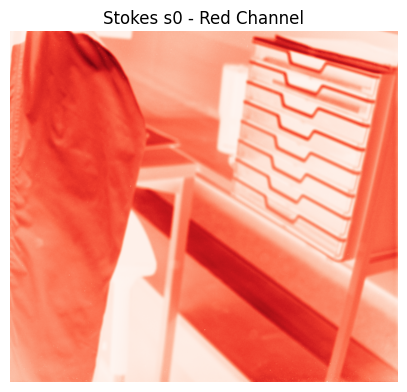

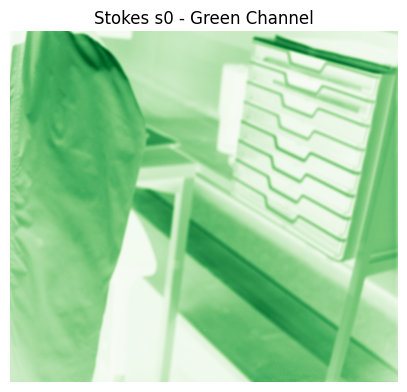

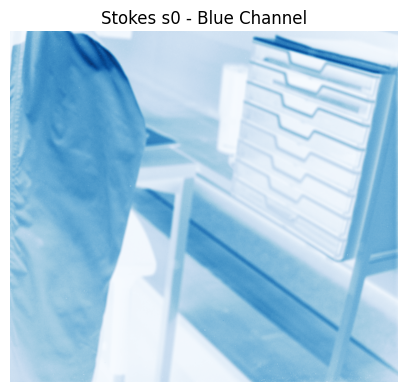

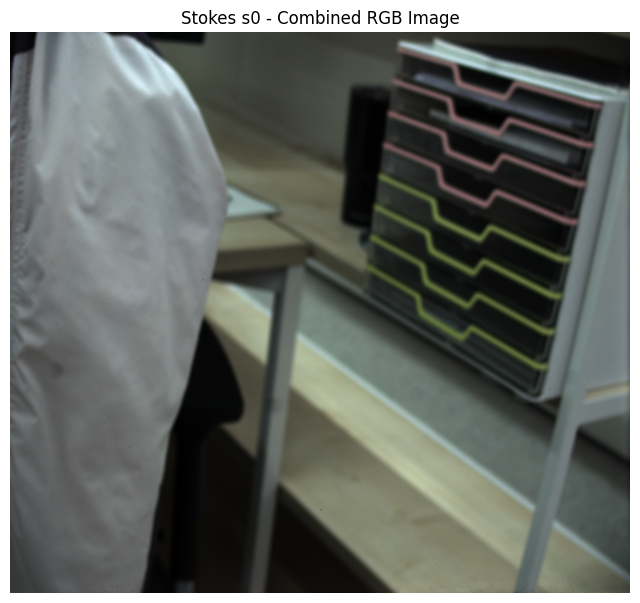

In [ ]:
import numpy as np
import matplotlib.pyplot as plt



# Stokes 파라미터 s0 선택 (첫 번째 축)
s0_data = data[:, :, 0, :]  # shape: (1900, 2100, 3)

# 채널별 추출
red_channel = s0_data[:, :, 0]    # Red 채널
green_channel = s0_data[:, :, 1]  # Green 채널
blue_channel = s0_data[:, :, 2]   # Blue 채널

# 채널별 정규화
red_channel_normalized = (red_channel - red_channel.min()) / (red_channel.max() - red_channel.min())
green_channel_normalized = (green_channel - green_channel.min()) / (green_channel.max() - green_channel.min())
blue_channel_normalized = (blue_channel - blue_channel.min()) / (blue_channel.max() - blue_channel.min())

# 각 채널 시각화
import matplotlib.pyplot as plt

# Red 채널 시각화
plt.figure(figsize=(5, 5))
plt.imshow(red_channel_normalized, cmap="Reds")
plt.axis('off')
plt.title("Stokes s0 - Red Channel")
plt.show()

# Green 채널 시각화
plt.figure(figsize=(5, 5))
plt.imshow(green_channel_normalized, cmap="Greens")
plt.axis('off')
plt.title("Stokes s0 - Green Channel")
plt.show()

# Blue 채널 시각화
plt.figure(figsize=(5, 5))
plt.imshow(blue_channel_normalized, cmap="Blues")
plt.axis('off')
plt.title("Stokes s0 - Blue Channel")
plt.show()

# Stokes s0의 정규화된 RGB 이미지 생성
rgb_normalized = (s0_data - s0_data.min()) / (s0_data.max() - s0_data.min())

# RGB 이미지 시각화
plt.figure(figsize=(5, 5))
plt.imshow(rgb_normalized)
plt.axis('off')
plt.title("Stokes s0 - Combined RGB Image")
plt.show()


In [ ]:

import os

dir_path = '/root/.cache/huggingface/hub/datasets--jyj7913--spectro-polarimetric/snapshots/074dc898e318d8f66c27b30b677fcfeaebe8b008'
print(os.listdir(dir_path))


['trichromatic']


FileNotFoundError: [Errno 2] No such file or directory: '/root/.cache/huggingface/hub/datasets--jyj7913--spectro-polarimetric/snapshots/074dc898e318d8f66c27b30b677fcfeaebe8b008/your_file.npy'

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# 데이터 로드
data = np.load('/root/.cache/huggingface/hub/datasets--jyj7913--spectro-polarimetric/snapshots/074dc898e318d8f66c27b30b677fcfeaebe8b008')

# 데이터를 이미지로 변환
image = Image.fromarray(data.astype('uint8'), 'RGB')

# 이미지 표시
plt.figure(figsize=(10, 10))
plt.imshow(image)
plt.axis('off')
plt.show()

import os

dir_path = '/root/.cache/huggingface/hub/datasets--jyj7913--spectro-polarimetric/snapshots/074dc898e318d8f66c27b30b677fcfeaebe8b008'
print(os.listdir(dir_path))


IsADirectoryError: [Errno 21] Is a directory: '/root/.cache/huggingface/hub/datasets--jyj7913--spectro-polarimetric/snapshots/074dc898e318d8f66c27b30b677fcfeaebe8b008'

In [ ]:
from torchvision.transforms import Compose, Resize, ToTensor, Normalize
from PIL import Image
import torch

def get_dataset_image_tensor(dataset, index, sidelength):
    img = dataset

    # 전처리 정의
    transform = Compose([
        Resize(sidelength),  # 크기 조정
        ToTensor(),  # Tensor로 변환
        Normalize(torch.Tensor([0.5]), torch.Tensor([0.5]))  # 정규화
    ])

    # 전처리 적용
    img = transform(img)
    return img


<a id='section_1'></a>
## Fitting an image

First, let's simply fit that image!

We seek to parameterize a greyscale image $f(x)$ with pixel coordinates $x$ with a SIREN $\Phi(x)$.

That is we seek the function $\Phi$ such that:
$\mathcal{L}=\int_{\Omega} \lVert \Phi(\mathbf{x}) - f(\mathbf{x}) \rVert\mathrm{d}\mathbf{x}$
 is minimized, in which $\Omega$ is the domain of the image.

We write a little datast that does nothing except calculating per-pixel coordinates:

In [ ]:
class ImageFitting:
    def __init__(self, sidelength, ds):
        self.sidelength = sidelength
        self.ds = ds
        self.processed_image = self.process_image(self.ds)

        # 픽셀 좌표 생성
        self.coords = self.create_coords(self.sidelength)

    def process_image(self, img):
        transform = Compose([
            Resize((self.sidelength, self.sidelength)),
            ToTensor(),
            Normalize(torch.Tensor([0.5]), torch.Tensor([0.5])),
        ])
        return transform(img)

    def create_coords(self, sidelength):
        """sidelength x sidelength 크기의 픽셀 좌표를 생성합니다."""
        x = torch.linspace(0, 1, sidelength)
        y = torch.linspace(0, 1, sidelength)
        grid = torch.stack(torch.meshgrid(x, y, indexing="ij"), dim=-1)
        return grid.reshape(-1, 2)  # [H*W, 2]

    def __len__(self):
        return 1  # 한 개의 이미지만 사용한다고 가정

    def __getitem__(self, idx):
        # model_input: 픽셀 좌표
        # ground_truth: 해당 좌표의 실제 값
        return self.coords, self.processed_image.view(-1, 1)

# 총 학습 단계와 학습 요약 간격
import random

total_steps = 100  # 각 이미지에 대해 100번의 gradient descent
steps_til_summary = 10

# 무작위로 10개의 이미지를 선택
num_samples = 10
random_indices = random.sample(range(len(ds['train'])), num_samples)
random_images = [ds['train'][i]['image'] for i in random_indices]

# 각 이미지를 순차적으로 학습
for img_idx, img in enumerate(random_images):
    print(f"Processing Image {img_idx+1}/{num_samples}")

    # 이미지 데이터로 ImageFitting 객체 생성
    cameraman = ImageFitting(256, ds=img)
    dataloader = DataLoader(cameraman, batch_size=1, pin_memory=True, num_workers=0)

    # Siren 모델 초기화
    img_siren = Siren(in_features=2, out_features=1, hidden_features=256,
                      hidden_layers=3, outermost_linear=True)
    img_siren.to('cpu')

    # Optimizer 설정
    optim = torch.optim.Adam(lr=1e-4, params=img_siren.parameters())

    # DataLoader에서 모델 입력과 정답 가져오기
    model_input, ground_truth = next(iter(dataloader))
    model_input, ground_truth = model_input.to('cpu'), ground_truth.to('cpu')

    # 모델 학습 루프
    for step in range(total_steps):
        model_output, coords = img_siren(model_input)

        # 손실 계산
        loss = ((model_output - ground_truth) ** 2).mean()

        # 주기적으로 학습 상태 요약
        if not step % steps_til_summary:
            print(f"Step {step}, Loss: {loss.item():.6f}")

            # 결과 시각화
            img_grad = gradient(model_output, coords)
            img_laplacian = laplace(model_output, coords)

            fig, axes = plt.subplots(1, 3, figsize=(18, 6))
            axes[0].imshow(model_output.cpu().view(256, 256).detach().numpy(), cmap="gray")
            axes[0].set_title("Model Output")
            axes[1].imshow(img_grad.norm(dim=-1).cpu().view(256, 256).detach().numpy(), cmap="gray")
            axes[1].set_title("Gradient Norm")
            axes[2].imshow(img_laplacian.cpu().view(256, 256).detach().numpy(), cmap="gray")
            axes[2].set_title("Laplacian")
            plt.show()

        # 역전파 및 매개변수 업데이트
        optim.zero_grad()
        loss.backward()
        optim.step()


In [ ]:
# ds['train'][0]으로 첫 번째 이미지를 가져오기
import random

# 무작위로 10개의 데이터 인덱스 선택
num_samples = 10
random_indices = random.sample(range(len(ds['train'])), num_samples)

# 선택된 인덱스의 이미지 가져오기
random_images = [ds['train'][i]['image'] for i in random_indices]

# 출력 확인
print("Selected indices:", random_indices)
print("Number of images:", len(random_images))

# ds['train'][0]으로 첫 번째 이미지를 가져오기
import random

# 무작위로 10개의 데이터 인덱스 선택
num_samples = 10
random_indices = random.sample(range(len(ds['train'])), num_samples)

# 선택된 인덱스의 이미지 가져오기
random_images = [ds['train'][i]['image'] for i in random_indices]

# 출력 확인
print("Selected indices:", random_indices)
print("Number of images:", len(random_images))


# 이제 ImageFitting을 호출할 때 image_pil을 사용
cameraman = ImageFitting(256, ds=random_images[0]) # 수정: random_images에서 하나의 이미지만 사용

dataloader = DataLoader(cameraman, batch_size=1, pin_memory=True, num_workers=0)

img_siren = Siren(in_features=2, out_features=1, hidden_features=256,
                  hidden_layers=3, outermost_linear=True)
img_siren.to('cpu')

resize_transform = Resize((256, 256))
ground_truth = resize_transform(cameraman.processed_image)

img_siren = Siren(in_features=2, out_features=1, hidden_features=256,
                  hidden_layers=3, outermost_linear=True)
img_siren.to('cpu')

resize_transform = Resize((256, 256))
ground_truth = resize_transform(cameraman.processed_image)

SyntaxError: invalid syntax. Maybe you meant '==' or ':=' instead of '='? (<ipython-input-19-92a1d0422812>, line 17)

In [ ]:
# 총 학습 단계와 학습 요약 간격
import random

total_steps = 100  # 각 이미지에 대해 100번의 gradient descent
steps_til_summary = 10

# 무작위로 10개의 이미지를 선택
num_samples = 10
random_indices = random.sample(range(len(ds['train'])), num_samples)
random_images = [ds['train'][i]['image'] for i in random_indices]

# 각 이미지를 순차적으로 학습
for img_idx, img in enumerate(random_images):
    print(f"Processing Image {img_idx+1}/{num_samples}")

    # 이미지 데이터로 ImageFitting 객체 생성
    target_image = ImageFitting(256, ds=img)
    dataloader = DataLoader(target_image, batch_size=1, pin_memory=True, num_workers=0)

    # Siren 모델 초기화
    img_siren = Siren(in_features=2, out_features=1, hidden_features=256,
                      hidden_layers=3, outermost_linear=True)
    img_siren.to('cpu')

    # Optimizer 설정
    optim = torch.optim.Adam(lr=1e-4, params=img_siren.parameters())

    # DataLoader에서 모델 입력과 정답 가져오기
    model_input, ground_truth = next(iter(dataloader))
    model_input, ground_truth = model_input.to('cpu'), ground_truth.to('cpu')

    # 모델 학습 루프
    for step in range(total_steps):
        model_output, coords = img_siren(model_input)

        # 손실 계산
        loss = ((model_output - ground_truth) ** 2).mean()

        # 주기적으로 학습 상태 요약
        if not step % steps_til_summary:
            print(f"Step {step}, Loss: {loss.item():.6f}")

            # 결과 시각화
            img_grad = gradient(model_output, coords)
            img_laplacian = laplace(model_output, coords)

            fig, axes = plt.subplots(1, 3, figsize=(18, 6))
            axes[0].imshow(model_output.cpu().view(256, 256).detach().numpy(), cmap="gray")
            axes[0].set_title("Model Output")
            axes[1].imshow(img_grad.norm(dim=-1).cpu().view(256, 256).detach().numpy(), cmap="gray")
            axes[1].set_title("Gradient Norm")
            axes[2].imshow(img_laplacian.cpu().view(256, 256).detach().numpy(), cmap="gray")
            axes[2].set_title("Laplacian")
            plt.show()

        # 역전파 및 매개변수 업데이트
        optim.zero_grad()
        loss.backward()
        optim.step()


In [ ]:
print(random_indices)

[640, 2100, 1390, 2162, 508, 1623, 1668, 1457, 1662, 686]


We now fit Siren in a simple training loop. Within only hundreds of iterations, the image and its gradients are approximated well.

In [ ]:
total_steps = 100 # Since the whole image is our dataset, this just means 500 gradient descent steps.
steps_til_summary = 10

optim = torch.optim.Adam(lr=1e-4, params=img_siren.parameters())

model_input, ground_truth = next(iter(dataloader))
model_input, ground_truth = model_input.to('cpu'), ground_truth.to('cpu')

model_output, coords = img_siren(model_input)

print("Model Output Size:", model_output.size())
print("Ground Truth Size:", ground_truth.size())

for step in range(total_steps):
    model_output, coords = img_siren(model_input)
    #model_output = model_output.view(1, 78336, 1)  # model_output의 크기를 ground_truth 크기에 맞게 변경

    loss = ((model_output - ground_truth)**2).mean()

    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        img_grad = gradient(model_output, coords)
        img_laplacian = laplace(model_output, coords)

        fig, axes = plt.subplots(1,3, figsize=(18,6))
        axes[0].imshow(model_output.cpu().view(256,256).detach().numpy())
        axes[1].imshow(img_grad.norm(dim=-1).cpu().view(256,256).detach().numpy())
        axes[2].imshow(img_laplacian.cpu().view(256,256).detach().numpy())
        plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

<a id='out_of_range'></a>
## Case study: Siren periodicity & out-of-range behavior

It is known that the sum of two periodic signals is itself periodic with a period that is equal to the least common multiple of the periods of the two summands, if and only if the two periods are rational multiples of each other. If the ratio of the two periods is irrational, then their sum will *not* be periodic itself.

Due to the floating-point representation in neural network libraries, this case cannot occur in practice, and all functions parameterized by Siren indeed have to be periodic.

Yet, the period of the resulting function may in practice be several orders of magnitudes larger than the period of each Siren neuron!

Let's test this with two sines.

In [ ]:
with torch.no_grad():
    coords = get_mgrid(2**10, 1) * 5 * np.pi

    sin_1 = torch.sin(coords)
    sin_2 = torch.sin(coords * 2)
    sum = sin_1 + sin_2

    fig, ax = plt.subplots(figsize=(16,2))
    ax.plot(coords, sum)
    ax.plot(coords, sin_1)
    ax.plot(coords, sin_2)
    plt.title("Rational multiple")
    plt.show()

    sin_1 = torch.sin(coords)
    sin_2 = torch.sin(coords * np.pi)
    sum = sin_1 + sin_2

    fig, ax = plt.subplots(figsize=(16,2))
    ax.plot(coords, sum)
    ax.plot(coords, sin_1)
    ax.plot(coords, sin_2)
    plt.title("Pseudo-irrational multiple")
    plt.show()

Though the second plot looks periodic, closer inspection shows that the period of the blue line is indeed larger than the range we're sampling here.

Let's take a look at what the Siren we just trained looks like outside its training domain!

In [ ]:
with torch.no_grad():
    out_of_range_coords = get_mgrid(1024, 2) * 50
    model_out, _ = img_siren(out_of_range_coords.cuda())

    fig, ax = plt.subplots(figsize=(16,16))
    ax.imshow(model_out.cpu().view(1024,1024).numpy())
    plt.show()

Though there is some self-similarity, the signal is not repeated on this range of (-50, 50).

## Fitting an audio signal
<a id='section_2'></a>

Here, we'll use Siren to parameterize an audio signal - i.e., we seek to parameterize an audio waverform $f(t)$  at time points $t$ by a SIREN $\Phi$.

That is we seek the function $\Phi$ such that:  $\mathcal{L}\int_\Omega \lVert \Phi(t) - f(t) \rVert \mathrm{d}t$  is minimized, in which  $\Omega$  is the domain of the waveform.

For the audio, we'll use the bach sonata:

In [ ]:
import scipy.io.wavfile as wavfile
import io
from IPython.display import Audio

if not os.path.exists('gt_bach.wav'):
    !wget https://vsitzmann.github.io/siren/img/audio/gt_bach.wav

Let's build a little dataset that computes coordinates for audio files:

In [ ]:
class AudioFile(torch.utils.data.Dataset):
    def __init__(self, filename):
        self.rate, self.data = wavfile.read(filename)
        self.data = self.data.astype(np.float32)
        self.timepoints = get_mgrid(len(self.data), 1)

    def get_num_samples(self):
        return self.timepoints.shape[0]

    def __len__(self):
        return 1

    def __getitem__(self, idx):
        amplitude = self.data
        scale = np.max(np.abs(amplitude))
        amplitude = (amplitude / scale)
        amplitude = torch.Tensor(amplitude).view(-1, 1)
        return self.timepoints, amplitude

Let's instantiate the Siren. As this audio signal has a much higer spatial frequency on the range of -1 to 1, we increase the $\omega_0$ in the first layer of siren.

In [ ]:
bach_audio = AudioFile('gt_bach.wav')

dataloader = DataLoader(bach_audio, shuffle=True, batch_size=1, pin_memory=True, num_workers=0)

# Note that we increase the frequency of the first layer to match the higher frequencies of the
# audio signal. Equivalently, we could also increase the range of the input coordinates.
audio_siren = Siren(in_features=1, out_features=1, hidden_features=256,
                    hidden_layers=3, first_omega_0=3000, outermost_linear=True)
audio_siren.cuda()

Let's have a quick listen to ground truth:

In [ ]:
rate, _ = wavfile.read('gt_bach.wav')

model_input, ground_truth = next(iter(dataloader))
Audio(ground_truth.squeeze().numpy(),rate=rate)

We now fit the Siren to this signal.

In [ ]:
total_steps = 1000
steps_til_summary = 100

optim = torch.optim.Adam(lr=1e-4, params=audio_siren.parameters())

model_input, ground_truth = next(iter(dataloader))
model_input, ground_truth = model_input.cuda(), ground_truth.cuda()

for step in range(total_steps):
    model_output, coords = audio_siren(model_input)
    loss = F.mse_loss(model_output, ground_truth)

    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))

        fig, axes = plt.subplots(1,2)
        axes[0].plot(coords.squeeze().detach().cpu().numpy(),model_output.squeeze().detach().cpu().numpy())
        axes[1].plot(coords.squeeze().detach().cpu().numpy(),ground_truth.squeeze().detach().cpu().numpy())
        plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

In [ ]:
final_model_output, coords = audio_siren(model_input)
Audio(final_model_output.cpu().detach().squeeze().numpy(),rate=rate)

As we can see, within few iterations, Siren has approximated the audio signal very well!

<a id='section_3'></a>
## Solving Poisson's equation

Now, let's make it a bit harder. Let's say we want to reconstruct an image but we only have access to its gradients!

That is, we now seek the function $\Phi$ such that:
$\mathcal{L}=\int_{\Omega} \lVert \nabla\Phi(\mathbf{x}) - \nabla f(\mathbf{x}) \rVert\mathrm{d}\mathbf{x}$
 is minimized, in which $\Omega$ is the domain of the image.

In [ ]:
import scipy.ndimage

class PoissonEqn(Dataset):
    def __init__(self, sidelength):
        super().__init__()
        img = get_cameraman_tensor(sidelength)

        # Compute gradient and laplacian
        grads_x = scipy.ndimage.sobel(img.numpy(), axis=1).squeeze(0)[..., None]
        grads_y = scipy.ndimage.sobel(img.numpy(), axis=2).squeeze(0)[..., None]
        grads_x, grads_y = torch.from_numpy(grads_x), torch.from_numpy(grads_y)

        self.grads = torch.stack((grads_x, grads_y), dim=-1).view(-1, 2)
        self.laplace = scipy.ndimage.laplace(img.numpy()).squeeze(0)[..., None]
        self.laplace = torch.from_numpy(self.laplace)

        self.pixels = img.permute(1, 2, 0).view(-1, 1)
        self.coords = get_mgrid(sidelength, 2)

    def __len__(self):
        return 1

    def __getitem__(self, idx):
        return self.coords, {'pixels':self.pixels, 'grads':self.grads, 'laplace':self.laplace}

#### Instantiate SIREN model

In [ ]:
cameraman_poisson = PoissonEqn(128)
dataloader = DataLoader(cameraman_poisson, batch_size=1, pin_memory=True, num_workers=0)

poisson_siren = Siren(in_features=2, out_features=1, hidden_features=256,
                      hidden_layers=3, outermost_linear=True)
poisson_siren.to('cpu')

/usr/local/lib/python3.11/dist-packages/torch/functional.py:534: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3595.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Siren(
  (net): Sequential(
    (0): SineLayer(
      (linear): Linear(in_features=2, out_features=256, bias=True)
    )
    (1): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (2): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (3): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (4): Linear(in_features=256, out_features=1, bias=True)
  )
)

#### Define the loss function

In [ ]:
def gradients_mse(model_output, coords, gt_gradients):
    # compute gradients on the model
    gradients = gradient(model_output, coords)
    # compare them with the ground-truth
    gradients_loss = torch.mean((gradients - gt_gradients).pow(2).sum(-1))
    return gradients_loss

#### Train the model

In [ ]:
selected_image = ds['train'][0]['image']
cameraman = ImageFitting(256, ds=selected_image)

dataloader = DataLoader(cameraman, batch_size=1, pin_memory=True, num_workers=0)

# Siren 모델 생성
poisson_siren = Siren(in_features=2, out_features=1, hidden_features=256,
                      hidden_layers=3, outermost_linear=True)
poisson_siren.to('cpu')

total_steps = 100
steps_til_summary = 10

# Adam optimizer 설정
optim = torch.optim.Adam(lr=1e-4, params=poisson_siren.parameters())

# dataloader에서 model_input과 ground truth(gt) 추출
model_input, gt = next(iter(dataloader))
gt = gt.to('cpu')
model_input = model_input.to('cpu')

# 학습 루프 시작
for step in range(total_steps):
    start_time = time.time()

    # 모델 출력 및 좌표 계산
    model_output, coords = poisson_siren(model_input)

    # 손실 계산
    # gt['grads'] 대신 gt를 바로 사용
    train_loss = gradients_mse(model_output, coords, gt)

    # 일정 단계마다 손실 및 시각화
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f, iteration time %0.6f" %
              (step, train_loss.item(), time.time() - start_time))

        img_grad = gradient(model_output, coords)
        img_laplacian = laplace(model_output, coords)

        fig, axes = plt.subplots(1, 3, figsize=(18, 6))
        axes[0].imshow(model_output.cpu().view(256, 256).detach().numpy())
        axes[1].imshow(img_grad.cpu().norm(dim=-1).view(256, 256).detach().numpy())
        axes[2].imshow(img_laplacian.cpu().view(256, 256).detach().numpy())
        plt.show()

    # 역전파 및 가중치 업데이트
    optim.zero_grad()
    train_loss.backward()
    optim.step()


NameError: name 'ds' is not defined

<a id='activations'></a>
## Initialization scheme & distribution of activations

We now reproduce the empirical result on the distribution of activations, and will thereafter show empirically that the distribution of activations is shift-invariant as well!

In [ ]:
from collections import OrderedDict
import matplotlib
import numpy.fft as fft
import scipy.stats as stats


def eformat(f, prec, exp_digits):
    s = "%.*e"%(prec, f)
    mantissa, exp = s.split('e')
    # add 1 to digits as 1 is taken by sign +/-
    return "%se%+0*d"%(mantissa, exp_digits+1, int(exp))

def format_x_ticks(x, pos):
    """Format odd tick positions
    """
    return eformat(x, 0, 1)

def format_y_ticks(x, pos):
    """Format odd tick positions
    """
    return eformat(x, 0, 1)

def get_spectrum(activations):
    n = activations.shape[0]

    spectrum = fft.fft(activations.numpy().astype(np.double).sum(axis=-1), axis=0)[:n//2]
    spectrum = np.abs(spectrum)

    max_freq = 100
    freq = fft.fftfreq(n, 2./n)[:n//2]
    return freq[:max_freq], spectrum[:max_freq]


def plot_all_activations_and_grads(activations):
    num_cols = 4
    num_rows = len(activations)

    fig_width = 5.5
    fig_height = num_rows/num_cols*fig_width
    fig_height = 9

    fontsize = 5

    fig, axs = plt.subplots(num_rows, num_cols, gridspec_kw={'hspace': 0.3, 'wspace': 0.2},
                            figsize=(fig_width, fig_height), dpi=300)

    axs[0][0].set_title("Activation Distribution", fontsize=7, fontfamily='serif', pad=5.)
    axs[0][1].set_title("Activation Spectrum", fontsize=7, fontfamily='serif', pad=5.)
    axs[0][2].set_title("Gradient Distribution", fontsize=7, fontfamily='serif', pad=5.)
    axs[0][3].set_title("Gradient Spectrum", fontsize=7, fontfamily='serif', pad=5.)

    x_formatter = matplotlib.ticker.FuncFormatter(format_x_ticks)
    y_formatter = matplotlib.ticker.FuncFormatter(format_y_ticks)

    spec_rows = []
    for idx, (key, value) in enumerate(activations.items()):
        grad_value = value.grad.cpu().detach().squeeze(0)
        flat_grad = grad_value.view(-1)
        axs[idx][2].hist(flat_grad, bins=256, density=True)

        value = value.cpu().detach().squeeze(0) # (1, num_points, 256)
        n = value.shape[0]
        flat_value = value.view(-1)

        axs[idx][0].hist(flat_value, bins=256, density=True)

        if idx>1:
            if not (idx)%2:
                x = np.linspace(-1, 1., 500)
                axs[idx][0].plot(x, stats.arcsine.pdf(x, -1, 2),
                                 linestyle=':', markersize=0.4, zorder=2)
            else:
                mu = 0
                variance = 1
                sigma = np.sqrt(variance)
                x = np.linspace(mu - 3*sigma, mu + 3*sigma, 500)
                axs[idx][0].plot(x, stats.norm.pdf(x, mu, sigma),
                                 linestyle=':', markersize=0.4, zorder=2)

        activ_freq, activ_spec = get_spectrum(value)
        axs[idx][1].plot(activ_freq, activ_spec)

        grad_freq, grad_spec = get_spectrum(grad_value)
        axs[idx][-1].plot(grad_freq, grad_spec)

        for ax in axs[idx]:
            ax.tick_params(axis='both', which='major', direction='in',
                                    labelsize=fontsize, pad=1., zorder=10)
            ax.tick_params(axis='x', labelrotation=0, pad=1.5, zorder=10)

            ax.xaxis.set_major_formatter(x_formatter)
            ax.yaxis.set_major_formatter(y_formatter)

In [ ]:
model = Siren(in_features=1, hidden_features=2048,
              hidden_layers=10, out_features=1, outermost_linear=True)

input_signal = torch.linspace(-1, 1, 65536//4).view(1, 65536//4, 1)
activations = model.forward_with_activations(input_signal, retain_grad=True)
output = activations[next(reversed(activations))]

# Compute gradients. Because we have retain_grad=True on
# activations, each activation stores its own gradient!
output.mean().backward()

plot_all_activations_and_grads(activations)

Note how the activations of Siren always alternate between a standard normal distribution with standard deviation one, and an arcsine distribution. If you have a beefy computer, you can put this to the extreme and increase the number of layers - this property holds even for more than 50 layers!

<a id='shift_invariance'></a>
## Distribution of activations is shift-invariant

One of the key properties of the periodic sine nonlinearity is that it affords a degree of shift-invariance. Consider the first layer of a Siren: You can convince yourself that this layer can easily learn to map two different coordinates to *the same set of activations*. This means that whatever layers come afterwards will apply the same function to these two sets of coordinates.

Moreoever, the distribution of activations similarly are shift-invariant. Let's shift our input signal by 1000 and re-compute the activations:

In [ ]:
input_signal = torch.linspace(-1, 1, 65536//4).view(1, 65536//4, 1) + 1000
activations = model.forward_with_activations(input_signal, retain_grad=True)
output = activations[next(reversed(activations))]

# Compute gradients. Because we have retain_grad=True on
# activations, each activation stores its own gradient!
output.mean().backward()

plot_all_activations_and_grads(activations)

As we can see, the distributions of activations didn't change at all - they are perfectly invariant to the shift.